In [1]:
import numpy as np
import os 
import pandas as pd
import cv2
import torch
import matplotlib.pyplot as plt
from ipywidgets import interact
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torchvision
from torch import nn
import torchsummary
from torch.utils.data import DataLoader
from collections import defaultdict
from torchvision.utils import make_grid
import matplotlib.image as mpimg
from collections import Counter

In [2]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [3]:
# CLASS_NAME_TO_ID = {'Unformed': 0, 'Burr': 1}
# CLASS_ID_TO_NAME = {0: 'Unformed', 1: 'Burr'}
# BOX_COLOR = {'Unformed':(200, 0, 0), 'Burr':(0, 0, 200)}
# TEXT_COLOR = (255, 255, 255)
CLASS_NAME_TO_ID = {'stray': 0, 'target': 1}
CLASS_ID_TO_NAME = {0: 'stray', 1: 'target'}
BOX_COLOR = {'stray':(200, 0, 0), 'target':(0, 0, 200)}
TEXT_COLOR = (255, 255, 255)

def save_model(model_state, model_name, save_dir="./trained_model"):
    os.makedirs(save_dir, exist_ok=True)
    torch.save(model_state, os.path.join(save_dir, model_name))


def visualize_bbox(image, bbox, class_name, color=BOX_COLOR, thickness=2):
    x_center, y_center, w, h = bbox
    x_min = int(x_center - w/2)
    y_min = int(y_center - h/2)
    x_max = int(x_center + w/2)
    y_max = int(y_center + h/2)
    
    cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color=color[class_name], thickness=thickness)
    
    ((text_width, text_height), _) = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, 0.35, 1)    
    cv2.rectangle(image, (x_min, y_min - int(1.3 * text_height)), (x_min + text_width, y_min), color[class_name], -1)
    cv2.putText(
        image,
        text=class_name,
        org=(x_min, y_min - int(0.3 * text_height)),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.35, 
        color=TEXT_COLOR, 
        lineType=cv2.LINE_AA,
    )
    return image


def visualize(image, bboxes, category_ids):
    img = image.copy()
    for bbox, category_id in zip(bboxes, category_ids):
#         print('category_id: ',category_id)
        class_name = CLASS_ID_TO_NAME[category_id.item()]
        img = visualize_bbox(img, bbox, class_name)
    return img

In [4]:
def collate_fn(batch):
    image_list = []
    target_list = []
    filename_list = []
    
    for a,b,c in batch:
        image_list.append(a)
        target_list.append(b)
        filename_list.append(c)

    return torch.stack(image_list, dim=0), target_list, filename_list


In [6]:
class Radio_dataset():
    def __init__(self, path, phase, transformer=None, aug=None, aug_factor=0):
        self.path=path
        self.phase=phase
        self.transformer=transformer
        self.aug=aug
        self.aug_factor=aug_factor
        
        self.image_files = sorted([fn for fn in os.listdir(self.path+"/"+self.phase+"/image") if fn.endswith("jpg")])
        self.label_files= sorted([lab for lab in os.listdir(self.path+"/"+self.phase+"/label") if lab.endswith("txt")])
        
        self.auged_img_list, self.auged_label_list=self.make_aug_list(self.image_files, self.label_files)
        
    def __getitem__(self,index):
        if(self.aug==None):
            filename, image = self.get_image(index)
            bboxes, class_ids = self.get_label(index)

            if(self.transformer):
                transformed_data=self.transformer(image=image, bboxes=bboxes, class_ids=class_ids)
                image = transformed_data['image']
                bboxes = np.array(transformed_data['bboxes'])
                class_ids = np.array(transformed_data['class_ids'])


            target = {}
    #         print(f'bboxes:{bboxes}\nclass_ids:{class_ids}\nlen_bboxes:{len(bboxes)}\nlen_class_ids:{len(class_ids)}')
    #         print(f'filename: {filename}')
            target["boxes"] = torch.Tensor(bboxes).float()
            target["labels"] = torch.Tensor(class_ids).long()

            ###
            bboxes=torch.Tensor(bboxes).float()
            class_ids=torch.Tensor(class_ids).long()
#             print(f"bboxes:{bboxes}\nclass_ids:{class_ids}\n---------")
            target = np.concatenate((bboxes, class_ids[:, np.newaxis]), axis=1)
            ###
        else:
            image=self.auged_img_list[index][1]
            target=self.auged_label_list[index]
            filename=self.auged_img_list[index][0]
        return image, target, filename
    
    def __len__(self, ):
        length=0
        if(self.aug==None):
            length=len(self.image_files)
        else:
            length=len(self.auged_img_list)
        return length
    
    def make_aug_list(self,ori_image_list,ori_label_files):
        aug_image_list=[]
        aug_label_list=[]
        
        print(f"start making augmented images-- augmented factor:{self.aug_factor}")
        for i in range(len(ori_image_list)):
            filename, ori_image = self.get_image(i)
            ori_bboxes, ori_class_ids = self.get_label(i)
            for j in range(self.aug_factor):
                auged_data=self.aug(image=ori_image, bboxes=ori_bboxes, class_ids=ori_class_ids)
                image = auged_data['image']
                bboxes = np.array(auged_data['bboxes'])
                class_ids = np.array(auged_data['class_ids'])
                
                bboxes=torch.Tensor(bboxes).float()
                class_ids=torch.Tensor(class_ids).long()
                
                aug_image_list.append((filename, image))
#                 print(f"{filename}, {bboxes}, {class_ids[:, np.newaxis]}")
                aug_label_list.append(np.concatenate((bboxes, class_ids[:, np.newaxis]), axis=1))
        
        print(f"total length of augmented images: {len(aug_image_list)}")
        
        return aug_image_list, aug_label_list
        
    
    def get_image(self, index): # 이미지 불러오는 함수
        filename = self.image_files[index]
        
        image_path = self.path+"/"+self.phase+"/image/"+filename
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        return filename, image
    
    def get_label(self, index): # label (box좌표, class_id) 불러오는 함수
        label_filename=self.label_files[index]
        label_path = self.path+"/"+self.phase+"/label/"+label_filename
        with open(label_path, 'r') as file:
            labels = file.readlines()
        
        class_ids=[]
        bboxes=[]
        for label in labels:
            label=label.replace("\n", "")
            obj=label.split(' ')[0]
            coor=label.split(' ')[1:]
            obj=int(obj)
            coor=list(map(float, coor))
            class_ids.append(obj)
            bboxes.append(coor)
            
        return bboxes, class_ids
    

In [5]:
class PET_dataset():
    def __init__(self,part,neck_dir,body_dir,phase, transformer=None, aug=None, aug_factor=0):
        self.neck_dir=neck_dir
        self.body_dir=body_dir
        self.part=part
        self.phase=phase
        self.transformer=transformer
        self.aug=aug
        self.aug_factor=aug_factor
        if(self.part=="body"):
            self.image_files = sorted([fn for fn in os.listdir(self.body_dir+"/"+self.phase+"/image") if fn.endswith("jpg")])
            self.label_files= sorted([lab for lab in os.listdir(self.body_dir+"/"+self.phase+"/label") if lab.endswith("txt")])
        elif(self.part=="neck"):
            self.image_files = sorted([fn for fn in os.listdir(self.neck_dir+"/"+self.phase+"/image") if fn.endswith("jpg")])
            self.label_files= sorted([lab for lab in os.listdir(self.neck_dir+"/"+self.phase+"/label") if lab.endswith("txt")])
        
        self.auged_img_list, self.auged_label_list=self.make_aug_list(self.image_files, self.label_files)
        
    def __getitem__(self,index):
        if(self.aug==None):
            filename, image = self.get_image(self.part, index)
            bboxes, class_ids = self.get_label(self.part, index)

            if(self.transformer):
                transformed_data=self.transformer(image=image, bboxes=bboxes, class_ids=class_ids)
                image = transformed_data['image']
                bboxes = np.array(transformed_data['bboxes'])
                class_ids = np.array(transformed_data['class_ids'])


            target = {}
    #         print(f'bboxes:{bboxes}\nclass_ids:{class_ids}\nlen_bboxes:{len(bboxes)}\nlen_class_ids:{len(class_ids)}')
    #         print(f'filename: {filename}')
            target["boxes"] = torch.Tensor(bboxes).float()
            target["labels"] = torch.Tensor(class_ids).long()

            ###
            bboxes=torch.Tensor(bboxes).float()
            class_ids=torch.Tensor(class_ids).long()
            target = np.concatenate((bboxes, class_ids[:, np.newaxis]), axis=1)
            ###
        else:
            image=self.auged_img_list[index][1]
            target=self.auged_label_list[index]
            filename=self.auged_img_list[index][0]
        return image, target, filename
    
    def __len__(self, ):
        length=0
        if(self.aug==None):
            length=len(self.image_files)
        else:
            length=len(self.auged_img_list)
        return length
    
    def make_aug_list(self,ori_image_list,ori_label_files):
        aug_image_list=[]
        aug_label_list=[]
        
        print(f"start making augmented images-- augmented factor:{self.aug_factor}")
        for i in range(len(ori_image_list)):
            filename, ori_image = self.get_image(self.part, i)
            ori_bboxes, ori_class_ids = self.get_label(self.part, i)
            for j in range(self.aug_factor):
                auged_data=self.aug(image=ori_image, bboxes=ori_bboxes, class_ids=ori_class_ids)
                image = auged_data['image']
                bboxes = np.array(auged_data['bboxes'])
                class_ids = np.array(auged_data['class_ids'])
                
                bboxes=torch.Tensor(bboxes).float()
                class_ids=torch.Tensor(class_ids).long()
                
                aug_image_list.append((filename, image))
                aug_label_list.append(np.concatenate((bboxes, class_ids[:, np.newaxis]), axis=1))
        
        print(f"total length of augmented images: {len(aug_image_list)}")
        
        return aug_image_list, aug_label_list
        
    
    def get_image(self, part, index): # 이미지 불러오는 함수
        filename = self.image_files[index]
        if(part=="body"):
#             print(f"body called!-> {self.part}")
            image_path = self.body_dir+"/"+self.phase+"/image/"+filename
        elif(part=="neck"):
#             print(f"neck called!-> {self.part}")
            image_path = self.neck_dir+"/"+self.phase+"/image/"+filename
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        return filename, image
    
    def get_label(self, part, index): # label (box좌표, class_id) 불러오는 함수
        label_filename=self.label_files[index]
        if(part=="body"):
#             print(f"body label called!-> {self.part}")
            label_path = self.body_dir+"/"+self.phase+"/label/"+label_filename
        elif(part=="neck"):
#             print(f"neck label called!-> {self.part}")
            label_path = self.neck_dir+"/"+self.phase+"/label/"+label_filename
        with open(label_path, 'r') as file:
            labels = file.readlines()
        
        class_ids=[]
        bboxes=[]
        for label in labels:
            label=label.replace("\n", "")
            obj=label.split(' ')[0]
            coor=label.split(' ')[1:]
            obj=int(obj)
            coor=list(map(float, coor))
            class_ids.append(obj)
            bboxes.append(coor)
            
        return bboxes, class_ids
    

# YOLO-CBAM

In [11]:
import torch
import torch.nn as nn
import math
import torch.utils.model_zoo as model_zoo


__all__ = ['ResNet', 'resnet18_cbam', 'resnet34_cbam', 'resnet50_cbam', 'resnet101_cbam',
           'resnet152_cbam']


model_urls = {
    'resnet18': 'https://download.pytorch.org/models/resnet18-5c106cde.pth',
    'resnet34': 'https://download.pytorch.org/models/resnet34-333f7ec4.pth',
    'resnet50': 'https://download.pytorch.org/models/resnet50-19c8e357.pth',
    'resnet101': 'https://download.pytorch.org/models/resnet101-5d3b4d8f.pth',
    'resnet152': 'https://download.pytorch.org/models/resnet152-b121ed2d.pth',
}


def conv3x3(in_planes, out_planes, stride=1):
    "3x3 convolution with padding"
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=1, bias=False)

class ChannelAttention(nn.Module):
    def __init__(self, in_planes, ratio=16):
        super(ChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
           
        self.fc = nn.Sequential(nn.Conv2d(in_planes, in_planes // 16, 1, bias=False),
                               nn.ReLU(),
                               nn.Conv2d(in_planes // 16, in_planes, 1, bias=False))
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.fc(self.avg_pool(x))
        max_out = self.fc(self.max_pool(x))
        out = avg_out + max_out
        return self.sigmoid(out)

class SpatialAttention(nn.Module):
    def __init__(self, kernel_size=7):
        super(SpatialAttention, self).__init__()

        self.conv1 = nn.Conv2d(2, 1, kernel_size, padding=kernel_size//2, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out, _ = torch.max(x, dim=1, keepdim=True)
        x = torch.cat([avg_out, max_out], dim=1)
        x = self.conv1(x)
        return self.sigmoid(x)

class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(BasicBlock, self).__init__()
        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = nn.BatchNorm2d(planes)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.BatchNorm2d(planes)

        self.ca = ChannelAttention(planes)
        self.sa = SpatialAttention()

        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        out = self.ca(out) * out
        out = self.sa(out) * out

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out


class Bottleneck(nn.Module):
    expansion = 4

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(Bottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=stride,
                               padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv3 = nn.Conv2d(planes, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.relu = nn.ReLU(inplace=True)

        self.ca = ChannelAttention(planes * 4)
        self.sa = SpatialAttention()

        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        out = self.ca(out) * out
        out = self.sa(out) * out

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out


class ResNet(nn.Module):

    def __init__(self, block, layers, num_classes=1000):
        self.inplanes = 64
        super(ResNet, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3,
                               bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512 * block.expansion, num_classes)
        self.head = nn.Sequential(
            nn.Conv2d(in_channels=2048, out_channels=1024, kernel_size=3, padding=1,bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=1024, out_channels=512, kernel_size=3, padding=1,bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels=512, out_channels=12, kernel_size=2, padding=0, stride=2,bias=False),
            nn.BatchNorm2d(12),
            nn.ReLU(inplace=True),
        )

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample))
        self.inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        
        x = self.head(x)

#         x = self.avgpool(x)
#         x = x.view(x.size(0), -1)
#         x = self.fc(x)

        return x


def resnet18_cbam(pretrained=False, **kwargs):
    """Constructs a ResNet-18 model.

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = ResNet(BasicBlock, [2, 2, 2, 2], **kwargs)
    if pretrained:
        pretrained_state_dict = model_zoo.load_url(model_urls['resnet18'])
        now_state_dict        = model.state_dict()
        now_state_dict.update(pretrained_state_dict)
        model.load_state_dict(now_state_dict)
    return model


def resnet34_cbam(pretrained=False, **kwargs):
    """Constructs a ResNet-34 model.

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = ResNet(BasicBlock, [3, 4, 6, 3], **kwargs)
    if pretrained:
        pretrained_state_dict = model_zoo.load_url(model_urls['resnet34'])
        now_state_dict        = model.state_dict()
        now_state_dict.update(pretrained_state_dict)
        model.load_state_dict(now_state_dict)
    return model


def resnet50_cbam(pretrained=False, **kwargs):
    """Constructs a ResNet-50 model.

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = ResNet(Bottleneck, [3, 4, 6, 3], **kwargs)
    if pretrained:
        pretrained_state_dict = model_zoo.load_url(model_urls['resnet50'])
        now_state_dict        = model.state_dict()
        now_state_dict.update(pretrained_state_dict)
        model.load_state_dict(now_state_dict)
    return model


def resnet101_cbam(pretrained=False, **kwargs):
    """Constructs a ResNet-101 model.

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = ResNet(Bottleneck, [3, 4, 23, 3], **kwargs)
    if pretrained:
        pretrained_state_dict = model_zoo.load_url(model_urls['resnet101'])
        now_state_dict        = model.state_dict()
        now_state_dict.update(pretrained_state_dict)
        model.load_state_dict(now_state_dict)
    return model


def resnet152_cbam(pretrained=False, **kwargs):
    """Constructs a ResNet-152 model.

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
    """
    model = ResNet(Bottleneck, [3, 8, 36, 3], **kwargs)
    if pretrained:
        pretrained_state_dict = model_zoo.load_url(model_urls['resnet152'])
        now_state_dict        = model.state_dict()
        now_state_dict.update(pretrained_state_dict)
        model.load_state_dict(now_state_dict)
    return model

## YOLO-ResNet

In [9]:
class YOLO_RESNET18(nn.Module):
    def __init__(self, num_classes):
        super().__init__()

        self.num_classes = num_classes
        self.num_bboxes = 2
        self.grid_size = 7

        resnet18 = torchvision.models.resnet18(pretrained = True)
#         swin=torchvision.models.swin_v2_t(weights='IMAGENET1K_V1')
        layers = [m for m in resnet18.children()] #Resnet에서 Yolo에서 가져올수 있을만한 layer만 선별적으로 가져오기 위해서

        # 기존 Resnet18의 layer들중에서 맨 뒤에 두개만 제외하고 다 가져와서 Backbone으로 사용
        self.backbone = nn.Sequential(*layers[:-2]) 
        self.head = nn.Sequential(
                nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=1, padding=0,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=1,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=1,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=1,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),

                nn.Conv2d(in_channels=1024, out_channels=(4+1)*self.num_bboxes+num_classes, kernel_size=1, padding=0, bias=False),
                nn.AdaptiveAvgPool2d(output_size=(self.grid_size, self.grid_size))
            )

    def forward(self, x):
        out = self.backbone(x)
        # out = self.neck(out)
        out = self.head(out) # input (batch, 3, 448, 448) -> output feature (batch, 12, 7, 7)
        return out


## YOLO-Swin

In [7]:
class YOLO_SWIN(nn.Module):
    def __init__(self, num_classes):
        super().__init__()

        self.num_classes = num_classes
        self.num_bboxes = 2
        self.grid_size = 7

#         resnet18 = torchvision.models.resnet18(pretrained = True)
        swin=torchvision.models.swin_v2_t(weights='IMAGENET1K_V1')
        layers = [m for m in swin.children()] #Resnet에서 Yolo에서 가져올수 있을만한 layer만 선별적으로 가져오기 위해서

        # 기존 Resnet18의 layer들중에서 맨 뒤에 두개만 제외하고 다 가져와서 Backbone으로 사용
        self.backbone = nn.Sequential(*layers[:-3]) 
        self.head = nn.Sequential(
                nn.Conv2d(in_channels=768, out_channels=1024, kernel_size=1, padding=0,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=1,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=1,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_channels=1024, out_channels=1024, kernel_size=3, padding=1,bias=False),
                nn.BatchNorm2d(1024),
                nn.ReLU(inplace=True),

                nn.Conv2d(in_channels=1024, out_channels=(4+1)*self.num_bboxes+num_classes, kernel_size=1, padding=0, bias=False),
                nn.AdaptiveAvgPool2d(output_size=(self.grid_size, self.grid_size))
            )

    def forward(self, x):
        out = self.backbone(x)
        # out = self.neck(out)
        out = self.head(out) # input (batch, 3, 448, 448) -> output feature (batch, 12, 7, 7)
        return out


In [8]:
NUM_CLASSES = 2
model = YOLO_SWIN(num_classes=NUM_CLASSES)
# model = resnet50_cbam(pretrained=True)
model.to(device)

YOLO_SWIN(
  (backbone): Sequential(
    (0): Sequential(
      (0): Sequential(
        (0): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
        (1): Permute()
        (2): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
      )
      (1): Sequential(
        (0): SwinTransformerBlockV2(
          (norm1): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
          (attn): ShiftedWindowAttentionV2(
            (qkv): Linear(in_features=96, out_features=288, bias=True)
            (proj): Linear(in_features=96, out_features=96, bias=True)
            (cpb_mlp): Sequential(
              (0): Linear(in_features=2, out_features=512, bias=True)
              (1): ReLU(inplace=True)
              (2): Linear(in_features=512, out_features=3, bias=False)
            )
          )
          (stochastic_depth): StochasticDepth(p=0.0, mode=row)
          (norm2): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
          (mlp): MLP(
            (0): Linear(in_features=96, out_f

In [9]:
def load_model(ckpt_path, num_classes, device):
    checkpoint = torch.load(ckpt_path, map_location=device)
#     model = YOLO_SWIN(num_classes=num_classes)
    model = YOLO_SWIN(num_classes=num_classes)
#     model = resnet50_cbam(pretrained=True)
    model.load_state_dict(checkpoint)
    model = model.to(device)
    model.eval()
    return model

In [10]:
IMAGE_SIZE=448
transformer = A.Compose([
            A.Resize(height=IMAGE_SIZE, width=IMAGE_SIZE),
            A.Normalize(mean=(0.485, 0.456, 0.406),std=(0.229, 0.224, 0.225)),
            ToTensorV2(),
        ],
        bbox_params=A.BboxParams(format='yolo', label_fields=['class_ids']),
)

## 학습된 모델 가져오기

In [12]:
# ckpt_path="./trained_model/YOLO_SWIN_T_body_LR0.0001_AUG30/model_90.pth"
ckpt_path="/workspace/Plastic_Bottle_defect_detection/experiments/trained_model/YOLO_SWIN_T_RADIO_LR0.0001_IP50_AUG4/model_100.pth"
model = load_model(ckpt_path, NUM_CLASSES, device)
model_name=ckpt_path.split("/workspace/Plastic_Bottle_defect_detection/experiments/trained_model/")[1].split("/model")[0]
model_name

'YOLO_SWIN_T_RADIO_LR0.0001_IP50_AUG4'

## Test dataset가져오기

In [19]:
NECK_PATH = '/home/host_data/PET_data/Neck'
BODY_PATH = '/home/host_data/PET_data/Body'
test_dataset=PET_dataset("neck" ,neck_dir=NECK_PATH,body_dir=BODY_PATH,phase='test', transformer=transformer, aug=None)
test_dataloaders = DataLoader(test_dataset, batch_size=1, shuffle=False, collate_fn=collate_fn)

start making augmented images-- augmented factor:0
total length of augmented images: 0


In [14]:
PATH = '/home/host_data/radio_signal_data_organized/'
test_dataset=Radio_dataset(path=PATH,phase='test', transformer=transformer, aug=None)
test_dataloaders = DataLoader(test_dataset, batch_size=1, shuffle=False, collate_fn=collate_fn)

start making augmented images-- augmented factor:0
total length of augmented images: 0


In [15]:
len(test_dataset)

278

In [16]:
@torch.no_grad()
def model_predict(image, model, conf_thres=0.2, iou_threshold=0.1):
    predictions = model(image)
    prediction = predictions.detach().cpu().squeeze(dim=0)
#     print(prediction.shape)
    
    grid_size = prediction.shape[-1]
    y_grid, x_grid = torch.meshgrid(torch.arange(grid_size), torch.arange(grid_size))
    stride_size = IMAGE_SIZE/grid_size

    conf = prediction[[0,5], ...].reshape(1, -1)
    xc = (prediction[[1,6], ...] * IMAGE_SIZE + x_grid*stride_size).reshape(1,-1)
    yc = (prediction[[2,7], ...] * IMAGE_SIZE + y_grid*stride_size).reshape(1,-1)
    w = (prediction[[3,8], ...] * IMAGE_SIZE).reshape(1,-1)
    h = (prediction[[4,9], ...] * IMAGE_SIZE).reshape(1,-1)
    cls = torch.max(prediction[10:, ...].reshape(NUM_CLASSES, -1), dim=0).indices.tile(1,2)
    
    x_min = xc - w/2
    y_min = yc - h/2
    x_max = xc + w/2
    y_max = yc + h/2

    prediction_res = torch.cat([x_min, y_min, x_max, y_max, conf, cls], dim=0)
    prediction_res = prediction_res.transpose(0,1)

    # x_min과 y_min이 음수가 되지않고, x_max와 y_max가 이미지 크기를 넘지 않게 제한
    prediction_res[:, 2].clip(min=0, max=image.shape[1]) 
    prediction_res[:, 3].clip(min=0, max=image.shape[0])
        
    pred_res = prediction_res[prediction_res[:, 4] > conf_thres]
    nms_index = torchvision.ops.nms(boxes=pred_res[:, 0:4], scores=pred_res[:, 4], iou_threshold=iou_threshold)
    pred_res_ = pred_res[nms_index].numpy()
    
    n_obj = pred_res_.shape[0]
    bboxes = np.zeros(shape=(n_obj, 4), dtype=np.float32)
    bboxes[:, 0:2] = (pred_res_[:, 0:2] + pred_res_[:, 2:4]) / 2
    bboxes[:, 2:4] = pred_res_[:, 2:4] - pred_res_[:, 0:2]
    scores = pred_res_[:, 4]
    class_ids = pred_res_[:, 5]
    
    # 이미지 값이 들어가면 모델을 통해서, 후처리까지 포함된 yolo 포멧의 box좌표, 그 좌표에 대한 confidence score
    # 그리고 class id를 반환
    return bboxes, scores, class_ids

In [17]:
def convertToAbsoluteValues(size, box):
    
#     xIn = round(((2 * float(box[0]) - float(box[2])) * size[0] / 2))
#     yIn = round(((2 * float(box[1]) - float(box[3])) * size[1] / 2))
#     xEnd = xIn + round(float(box[2]) * size[0])
#     yEnd = yIn + round(float(box[3]) * size[1])
    xIn = round(((2 * float(box[0]) - float(box[2])) / 2))
    yIn = round(((2 * float(box[1]) - float(box[3])) / 2))
    xEnd = xIn + round(float(box[2]))
    yEnd = yIn + round(float(box[3]))
    
    if xIn < 0:
        xIn = 0
    if yIn < 0:
        yIn = 0
    if xEnd >= size[0]:
        xEnd = size[0] - 1
    if yEnd >= size[1]:
        yEnd = size[1] - 1
        
    return (xIn/size[0], yIn/size[1], xEnd/size[0], yEnd/size[1])
#     return (xIn, yIn, xEnd, yEnd)

## Detection한 결과 폴더로 만들어주기(VOC type)

In [18]:
# detection 만들기
pred_images = []
pred_labels =[]

for index, batch in enumerate(test_dataloaders):
    images = batch[0].to(device)
    filename=batch[2]
    print(images.shape)
    
    bboxes, scores, class_ids = model_predict(images, model, conf_thres=0.1, iou_threshold=0.1)
    
    if len(bboxes) > 0:
        prediction_yolo = np.concatenate([bboxes, scores[:, np.newaxis], class_ids[:, np.newaxis]], axis=1)
    else:
        prediction_yolo = np.array([])
    
    # 텐서형의 이미지를 다시 unnormalize를 시키고, 다시 chw를 hwc로 바꾸고 넘파이로 바꾼다.
    np_image = make_grid(images[0], normalize=True).cpu().permute(1,2,0).numpy()
    pred_images.append(np_image)
    pred_labels.append(prediction_yolo)
    print(f"filename:{filename}, prediction_yolo:{prediction_yolo}\n")
#     print(f"{convertToAbsoluteValues(size=(images.shape[2],images.shape[3]),box=prediction_yolo[0][0:4])}")
    txt_name=filename[0].split(".")[0]+".txt"
    os.makedirs(f"/home/host_data/PET_data_for_measure/Neck/test/label/detection/{model_name}", exist_ok=True)
    f = open(f"/home/host_data/PET_data_for_measure/Neck/test/label/detection/{model_name}/"+txt_name, 'w')
    for i in range(len(prediction_yolo)):
        print(f"box={prediction_yolo[i][0:4]}")
        c=convertToAbsoluteValues(size=(images.shape[2],images.shape[3]),box=prediction_yolo[i][0:4])
        print(f"size={(images.shape[2],images.shape[3])}, c--{c}")
        text=f"{int(prediction_yolo[i][5])} {prediction_yolo[i][4]} {c[0]} {c[1]} {c[2]} {c[3]}\n"
        f.write(text)

    

torch.Size([1, 3, 448, 448])
filename:['1001_target_8c08fcb00e70e97aa41603a133b0f46c.jpg'], prediction_yolo:[[225.07733    229.25006     12.677002   128.3716       0.60030544
    1.        ]]

box=[225.07733  229.25006   12.677002 128.3716  ]
size=(448, 448), c--(0.4888392857142857, 0.36830357142857145, 0.5178571428571429, 0.6540178571428571)
torch.Size([1, 3, 448, 448])
filename:['1004_target_92c1aea5f932da410681a64a6d5de522.jpg'], prediction_yolo:[[232.77487   232.1207     14.47821   119.499146    0.5620331   1.       ]]

box=[232.77487  232.1207    14.47821  119.499146]
size=(448, 448), c--(0.5044642857142857, 0.38392857142857145, 0.5357142857142857, 0.6495535714285714)
torch.Size([1, 3, 448, 448])
filename:['1032_target_ea7a306a2cb782f24b9ada6cb0e8d0f9.jpg'], prediction_yolo:[[220.88911   232.60057    13.074493  129.29172     0.5968868   1.       ]]

box=[220.88911  232.60057   13.074493 129.29172 ]
size=(448, 448), c--(0.47767857142857145, 0.375, 0.5066964285714286, 0.662946428571

/usr/local/lib/python3.8/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/pytorch/pytorch/aten/src/ATen/native/TensorShape.cpp:3423.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


torch.Size([1, 3, 448, 448])
filename:['1061_target_ed71df474b16fd5371b05674322698ed.jpg'], prediction_yolo:[[232.35582   230.9851     12.97644   124.15521     0.5850297   1.       ]]

box=[232.35582 230.9851   12.97644 124.15521]
size=(448, 448), c--(0.5044642857142857, 0.37723214285714285, 0.5334821428571429, 0.6540178571428571)
torch.Size([1, 3, 448, 448])
filename:['1075_target_428f9c5bc1b77cdcf17d420a10a09948.jpg'], prediction_yolo:[[222.51874   230.35019    14.188171  127.6134      0.5828203   1.       ]]

box=[222.51874  230.35019   14.188171 127.6134  ]
size=(448, 448), c--(0.4799107142857143, 0.37276785714285715, 0.5111607142857143, 0.6584821428571429)
torch.Size([1, 3, 448, 448])
filename:['1078_stray_7c1f115c50192cdc79f362cdada10d2d.jpg'], prediction_yolo:[[2.1827330e+02 1.1145471e+02 1.6706329e+01 1.2205365e+02 2.0627904e-01
  0.0000000e+00]]

box=[218.2733  111.45471  16.70633 122.05365]
size=(448, 448), c--(0.46875, 0.11160714285714286, 0.5066964285714286, 0.3839285714285

filename:['1413_target_0a45a84eda7d073ad055283103edd841.jpg'], prediction_yolo:[[215.99667    36.853775    9.261353   66.2825      0.3072318   1.       ]]

box=[215.99667   36.853775   9.261353  66.2825  ]
size=(448, 448), c--(0.47098214285714285, 0.008928571428571428, 0.49107142857142855, 0.15625)
torch.Size([1, 3, 448, 448])
filename:['1422_stray_d650cf89d30036f8e0502547a8d886e0.jpg'], prediction_yolo:[[1.0030939e+02 2.9864044e+02 1.0710037e+01 7.3283325e+01 2.1392922e-01
  0.0000000e+00]
 [3.3812851e+02 3.8934290e+02 1.2330811e+01 6.8672302e+01 1.9860242e-01
  0.0000000e+00]
 [1.3762045e+02 2.8039661e+02 1.7856232e+01 6.5989365e+01 1.2705962e-01
  0.0000000e+00]]

box=[100.30939  298.64044   10.710037  73.283325]
size=(448, 448), c--(0.21205357142857142, 0.5848214285714286, 0.23660714285714285, 0.7477678571428571)
box=[338.1285   389.3429    12.330811  68.6723  ]
size=(448, 448), c--(0.7410714285714286, 0.7924107142857143, 0.7678571428571429, 0.9464285714285714)
box=[137.62045  280.

torch.Size([1, 3, 448, 448])
filename:['1572_target_ddc1ffeb2a2c4e500549df450f505ad7.jpg'], prediction_yolo:[[224.3645     236.97685     12.862366   127.168        0.57896423
    1.        ]]

box=[224.3645   236.97685   12.862366 127.168   ]
size=(448, 448), c--(0.48660714285714285, 0.3861607142857143, 0.515625, 0.6696428571428571)
torch.Size([1, 3, 448, 448])
filename:['1592_stray_ce60d2dbe86989cdd950b0bdeedf6b23.jpg'], prediction_yolo:[[2.9774841e+02 1.5849850e+02 9.7158203e+00 1.3148849e+02 3.2596472e-01
  0.0000000e+00]
 [3.0941638e+02 1.9708192e+02 1.1643799e+01 1.4145529e+02 1.5015155e-01
  0.0000000e+00]]

box=[297.7484  158.4985    9.71582 131.4885 ]
size=(448, 448), c--(0.6540178571428571, 0.20758928571428573, 0.6763392857142857, 0.5)
box=[309.41638  197.08192   11.643799 141.45529 ]
size=(448, 448), c--(0.6785714285714286, 0.28125, 0.7053571428571429, 0.5959821428571429)
torch.Size([1, 3, 448, 448])
filename:['1598_target_2f5a558888787610b2bcb12249209b4f.jpg'], prediction_yo

torch.Size([1, 3, 448, 448])
filename:['1880_target_d03a90f3ec175756d4cbf490785b1008.jpg'], prediction_yolo:[[135.12384     25.447216    13.803467    56.738235     0.27188745
    1.        ]]

box=[135.12384   25.447216  13.803467  56.738235]
size=(448, 448), c--(0.2857142857142857, 0.0, 0.3169642857142857, 0.12053571428571429)
torch.Size([1, 3, 448, 448])
filename:['1903_target_4c38eabdd42eadd41ecf21db96597c45.jpg'], prediction_yolo:[[2.8029930e+01 4.0393204e+02 1.4860521e+01 7.0879700e+01 1.1211474e-01
  0.0000000e+00]]

box=[ 28.02993  403.93204   14.860521  70.8797  ]
size=(448, 448), c--(0.046875, 0.8214285714285714, 0.08035714285714286, 0.9799107142857143)
torch.Size([1, 3, 448, 448])
filename:['1908_target_1c87d96160a15d51b49e56527279345d.jpg'], prediction_yolo:[[234.54558    213.0108      16.069763   137.53148      0.52681035
    1.        ]]

box=[234.54558  213.0108    16.069763 137.53148 ]
size=(448, 448), c--(0.5066964285714286, 0.32142857142857145, 0.5424107142857143, 0.62

filename:['2226_target_b0153f85226856e0847baddecbb36331.jpg'], prediction_yolo:[[226.7558     230.97763     11.244659   132.1535       0.59454423
    1.        ]]

box=[226.7558   230.97763   11.244659 132.1535  ]
size=(448, 448), c--(0.49330357142857145, 0.36830357142857145, 0.5178571428571429, 0.6629464285714286)
torch.Size([1, 3, 448, 448])
filename:['2242_target_0f59846bb2a64360a7c16108181f34a8.jpg'], prediction_yolo:[[221.91539   230.32372    14.079803  101.272125    0.5180348   1.       ]]

box=[221.91539  230.32372   14.079803 101.272125]
size=(448, 448), c--(0.4799107142857143, 0.4017857142857143, 0.5111607142857143, 0.6272321428571429)
torch.Size([1, 3, 448, 448])
filename:['225_stray_f5599b13b119de3a095262e6b12f6750.jpg'], prediction_yolo:[[2.3023840e+02 2.4419141e+02 1.8044556e+01 1.1718713e+02 3.4834611e-01
  0.0000000e+00]
 [1.0815132e+02 3.5817502e+02 2.0068176e+01 1.1250525e+02 1.8023282e-01
  0.0000000e+00]]

box=[230.2384   244.1914    18.044556 117.18713 ]
size=(448, 

filename:['2557_target_745233a3e3a4ca7fd322496b796c3033.jpg'], prediction_yolo:[[237.13092   228.1984     14.267029  132.67804     0.5750519   1.       ]]

box=[237.13092  228.1984    14.267029 132.67804 ]
size=(448, 448), c--(0.5133928571428571, 0.36160714285714285, 0.5446428571428571, 0.6584821428571429)
torch.Size([1, 3, 448, 448])
filename:['2562_stray_0bc053d49c425e4918727aa481e92e91.jpg'], prediction_yolo:[[7.0083227e+00 2.2246527e+02 1.7779078e+01 9.2358749e+01 1.9998063e-01
  0.0000000e+00]]

box=[  7.0083227 222.46527    17.779078   92.35875  ]
size=(448, 448), c--(0.0, 0.39285714285714285, 0.03571428571428571, 0.5982142857142857)
torch.Size([1, 3, 448, 448])
filename:['257_stray_5872119fdb767f741816bdcc18242c3f.jpg'], prediction_yolo:[[146.61052    200.96841     17.217865   108.24591      0.22692907
    0.        ]]

box=[146.61052  200.96841   17.217865 108.24591 ]
size=(448, 448), c--(0.3080357142857143, 0.328125, 0.34598214285714285, 0.5691964285714286)
torch.Size([1, 3, 4

filename:['339_stray_629c7ae0cac2940dad6a4635d66a45c7.jpg'], prediction_yolo:[[1.07080154e+02 3.48335571e+01 1.82762756e+01 6.41550903e+01
  1.87921330e-01 0.00000000e+00]
 [4.01347260e+02 4.06961578e+02 1.63584595e+01 6.42234497e+01
  1.30409032e-01 0.00000000e+00]
 [1.17834251e+02 4.00473358e+02 1.77298126e+01 6.37730103e+01
  1.16137505e-01 0.00000000e+00]]

box=[107.080154  34.833557  18.276276  64.15509 ]
size=(448, 448), c--(0.21875, 0.006696428571428571, 0.25892857142857145, 0.14955357142857142)
box=[401.34726 406.96158  16.35846  64.22345]
size=(448, 448), c--(0.8772321428571429, 0.8370535714285714, 0.9129464285714286, 0.9799107142857143)
box=[117.83425  400.47336   17.729813  63.77301 ]
size=(448, 448), c--(0.24330357142857142, 0.8236607142857143, 0.28348214285714285, 0.9665178571428571)
torch.Size([1, 3, 448, 448])
filename:['340_stray_635b2a72419f9667673c4b794b54305a.jpg'], prediction_yolo:[[1.0508923e+01 2.8312897e+02 1.6434853e+01 1.0694360e+02 1.7729732e-01
  0.0000000e+0

filename:['59_stray_8f5f5cac94c14eb3aa3c04d9417779b4.jpg'], prediction_yolo:[[2.9155359e+02 1.5805592e+02 5.3637695e+00 1.2325577e+02 2.9095280e-01
  0.0000000e+00]
 [3.1305563e+02 2.1486336e+02 1.1634399e+01 1.3483054e+02 1.8234645e-01
  0.0000000e+00]
 [1.5457039e+01 2.2215030e+02 1.7031242e+01 1.0740564e+02 1.1095482e-01
  0.0000000e+00]]

box=[291.5536    158.05592     5.3637695 123.25577  ]
size=(448, 448), c--(0.6450892857142857, 0.21428571428571427, 0.65625, 0.4888392857142857)
box=[313.05563  214.86336   11.634399 134.83054 ]
size=(448, 448), c--(0.6852678571428571, 0.328125, 0.7120535714285714, 0.6294642857142857)
box=[ 15.457039 222.1503    17.031242 107.40564 ]
size=(448, 448), c--(0.015625, 0.375, 0.05357142857142857, 0.6138392857142857)
torch.Size([1, 3, 448, 448])
filename:['5_stray_ae16717d2ca018b28156e434b8093f86.jpg'], prediction_yolo:[[3.6061942e+02 1.8664095e+02 1.8191833e+01 8.4076996e+01 2.1157508e-01
  0.0000000e+00]]

box=[360.61942  186.64095   18.191833  84.076

filename:['74_stray_bf1cb3f2fb4b4377313fbf98509ce95c.jpg'], prediction_yolo:[[2.36696930e+02 2.48819336e+02 1.92221069e+01 1.11700195e+02
  3.63546371e-01 0.00000000e+00]
 [1.08145966e+02 3.57716003e+02 2.11357727e+01 1.12026855e+02
  1.94459170e-01 0.00000000e+00]
 [1.22976212e+02 1.53373993e+02 1.92844849e+01 1.03528900e+02
  1.02230467e-01 0.00000000e+00]]

box=[236.69693  248.81934   19.222107 111.700195]
size=(448, 448), c--(0.5066964285714286, 0.43080357142857145, 0.5491071428571429, 0.6808035714285714)
box=[108.145966 357.716     21.135773 112.026855]
size=(448, 448), c--(0.21875, 0.6741071428571429, 0.265625, 0.9241071428571429)
box=[122.97621  153.374     19.284485 103.5289  ]
size=(448, 448), c--(0.25223214285714285, 0.22767857142857142, 0.29464285714285715, 0.45982142857142855)
torch.Size([1, 3, 448, 448])
filename:['752_target_ee0b7b4706f3645e227fe40d72cd26b1.jpg'], prediction_yolo:[[2.7157758e+02 3.9775403e+02 1.0447388e+01 1.1233276e+02 1.8500553e-01
  1.0000000e+00]]

bo

## Detection한 결과 Plot

In [19]:

from ipywidgets import interact

@interact(index=(0,len(pred_images)-1))
def show_result(index=0):
    print(pred_labels[index])
    if len(pred_labels[index]) > 0:
        result = visualize(pred_images[index], pred_labels[index][:, 0:4], pred_labels[index][:, 5])
    else:
        result = pred_images[index]
        
    plt.figure(figsize=(6,6))
    plt.imshow(result)
    plt.show()

interactive(children=(IntSlider(value=0, description='index', max=277), Output()), _dom_classes=('widget-inter…

In [20]:
def convertToAbsoluteValues_size(size, box):
    
#     xIn = round(((2 * float(box[0]) - float(box[2])) * size[0] / 2))
#     yIn = round(((2 * float(box[1]) - float(box[3])) * size[1] / 2))
#     xEnd = xIn + round(float(box[2]) * size[0])
#     yEnd = yIn + round(float(box[3]) * size[1])
    xIn = (2 * float(box[0]) - float(box[2])) / 2
    yIn = (2 * float(box[1]) - float(box[3])) / 2
    xEnd = xIn + float(box[2])
    yEnd = yIn + float(box[3])
    
    if xIn < 0:
        xIn = 0
    if yIn < 0:
        yIn = 0
    if xEnd >= size[0]:
        xEnd = size[0] - 1
    if yEnd >= size[1]:
        yEnd = size[1] - 1
        
    return (xIn, yIn, xEnd, yEnd)

## Annotation을 폴더로 만들어주기(VOC type)

## 탐지성능검증을 위한 지표 적용

In [22]:
# 0: 'Unformed', 1: 'Burr'
# num2class = {"0.0" : "Unformed", "1.0" : "Burr"}
num2class = {"0.0" : "stray", "1.0" : "target"}

In [23]:
# box : (centerX, centerY, width, height)
def convertToAbsoluteValues(size, box):
    
    xIn = round(((2 * float(box[0]) - float(box[2])) * size[0] / 2))
    yIn = round(((2 * float(box[1]) - float(box[3])) * size[1] / 2))
    xEnd = xIn + round(float(box[2]) * size[0])
    yEnd = yIn + round(float(box[3]) * size[1])
    
    if xIn < 0:
        xIn = 0
    if yIn < 0:
        yIn = 0
    if xEnd >= size[0]:
        xEnd = size[0] - 1
    if yEnd >= size[1]:
        yEnd = size[1] - 1
    return (xIn, yIn, xEnd, yEnd)

# def convertToRelativeValues(size, box):
#     dw = 1. / (size[0])
#     dh = 1. / (size[1])
#     cx = (box[1] + box[0]) / 2.0
#     cy = (box[3] + box[2]) / 2.0
#     w = box[1] - box[0]
#     h = box[3] - box[2]
#     x = cx * dw
#     y = cy * dh
#     w = w * dw
#     h = h * dh
#     # x,y => (bounding_box_center)/width_of_the_image
#     # w => bounding_box_width / width_of_the_image
#     # h => bounding_box_height / height_of_the_image
#     return (x, y, w, h)

In [25]:
def boundingBoxes(labelPath, imagePath, model_name):
    
    detections, groundtruths, classes = [], [], []
    
    for boxtype in os.listdir(labelPath):
        
        if boxtype=="detection":
            boxtypeDir=labelPath+boxtype+"/"+model_name+"/"
        else:
            boxtypeDir = os.path.join(labelPath,boxtype)

        for labelfile in os.listdir(boxtypeDir):
            if labelfile ==".ipynb_checkpoints":
                continue
            filename = os.path.splitext(labelfile)[0]
            with open(os.path.join(boxtypeDir, labelfile)) as f:
                labelinfos = f.readlines()

            imgfilepath = os.path.join(imagePath, filename + ".jpg")
            print(imgfilepath )
            img = cv2.imread(imgfilepath)
            print(img.shape)
            h, w, _ = img.shape

            for labelinfo in labelinfos:
                label, conf, rx1, ry1, rx2, ry2 = map(float, labelinfo.strip().split())
#                 x1, y1, x2, y2 = convertToAbsoluteValues((448, 448), (rx1, ry1, rx2, ry2))
#                 boxinfo = [filename, label, conf, (x1, y1, x2, y2)]
                boxinfo = [filename, label, conf, (rx1*448, ry1*448, rx2*448, ry2*448)]
                
                if label not in classes:
                    classes.append(label)
                
                if boxtype == "detection":
                    detections.append(boxinfo)
                else:
                    groundtruths.append(boxinfo)
                    
    classes = sorted(classes)
                
    return detections, groundtruths, classes

# detections, groundtruths, classes = boundingBoxes(f"/home/host_data/PET_data_for_measure/Neck/test/label/", "/home/host_data/PET_data_for_measure/Neck/test/image/",model_name)
detections, groundtruths, classes = boundingBoxes(f"/home/host_data/radio_signal_data_organized_for_measure/test/label/", "/home/host_data/radio_signal_data_organized_for_measure/test/image/",model_name)
print(f"detections:{detections}\n\n")
print(f"groundtruths:{groundtruths}\n\n")
print(f"classes:{classes}\n\n")

/home/host_data/radio_signal_data_organized_for_measure/test/image/2784_stray_8e39090c81c4be041fee35bd6d175477.jpg
(288, 307, 3)
/home/host_data/radio_signal_data_organized_for_measure/test/image/2278_target_53a0e8e16e7362c1395c3a92f04452a5.jpg
(288, 307, 3)
/home/host_data/radio_signal_data_organized_for_measure/test/image/882_stray_7396b96e28fff47958b30e8705ac7ea7.jpg
(288, 307, 3)
/home/host_data/radio_signal_data_organized_for_measure/test/image/2544_target_c6ee6e0b5c9d4289a961a18e3faf2554.jpg
(288, 307, 3)
/home/host_data/radio_signal_data_organized_for_measure/test/image/2404_target_453c92beb85690442adb222c23f1aa96.jpg
(288, 307, 3)
/home/host_data/radio_signal_data_organized_for_measure/test/image/1109_target_e15bd87c56ab07e6981cc7665d3d0ce8.jpg
(288, 307, 3)
/home/host_data/radio_signal_data_organized_for_measure/test/image/225_stray_f5599b13b119de3a095262e6b12f6750.jpg
(288, 307, 3)
/home/host_data/radio_signal_data_organized_for_measure/test/image/1192_target_3ec8e63903d22124

In [26]:
transformer = A.Compose([ 
        # bounding box의 변환, augmentation에서 albumentations는 Detection 학습을 할 때 굉장히 유용하다. 
        A.Resize(height=IMAGE_SIZE, width=IMAGE_SIZE),
#         A.Normalize(mean=(0.485, 0.456, 0.406),std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
        # albumentations 라이브러리에서는 Normalization을 먼저 진행해 주고 tensor화를 진행해 주어야한다.
    ]
    
)

## Prediction & Annotation 비교이미지 저장

(448, 448, 3)
1001_target_8c08fcb00e70e97aa41603a133b0f46c
[(219.0, 165.0, 232.00000000000003, 293.0, 0.600305438041687), (218.8925103545189, 163.33333778381348, 232.02606111764908, 297.1111125946045, 1.0)]


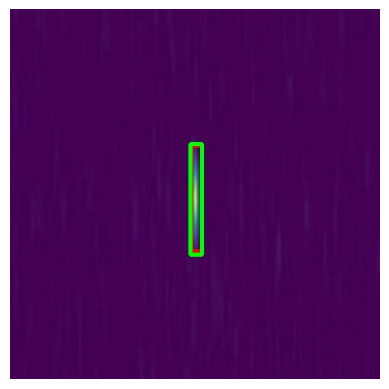

(448, 448, 3)
1004_target_92c1aea5f932da410681a64a6d5de522
[(226.0, 172.0, 240.0, 291.0, 0.5620331168174744), (230.56677955389023, 172.66666221618652, 239.32247978448868, 292.44443702697754, 1.0)]


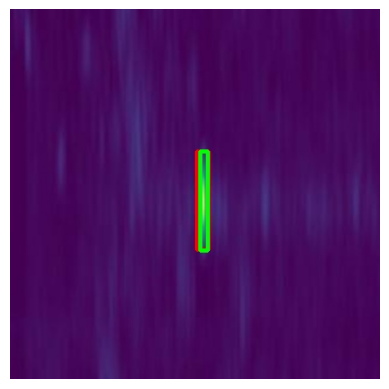

(448, 448, 3)
1032_target_ea7a306a2cb782f24b9ada6cb0e8d0f9
[(214.0, 168.0, 227.0, 297.0, 0.5968868136405945), (215.9739409685135, 163.33333110809326, 232.0260590314865, 298.66666889190674, 1.0)]


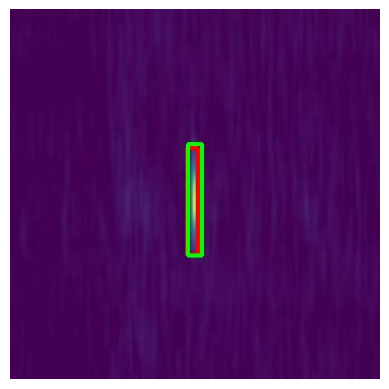

(448, 448, 3)
1044_stray_926fa262e0a03c1cfc0ffc6f9ebd3cb3
[(136.0, 210.0, 150.0, 277.0, 0.24981018900871277), (363.0, 208.0, 378.0, 284.0, 0.16790726780891418), (92.0, 194.0, 108.0, 250.0, 0.12916798889636993), (145.92833995819092, 214.6666555404663, 170.73615741729736, 281.5555429458618, 1.0)]


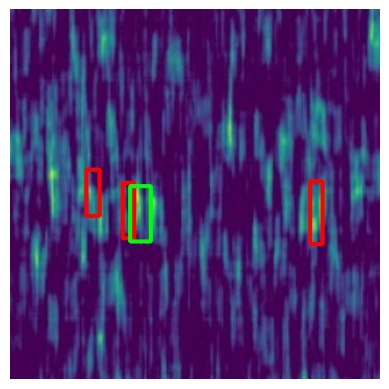

(448, 448, 3)
1057_target_be8068709e5d8da7112937027e75a88e
[(236.0, 160.0, 252.0, 296.0, 0.509860634803772), (242.24103873968124, 166.44444370269775, 250.9967389702797, 297.1111059188843, 1.0)]


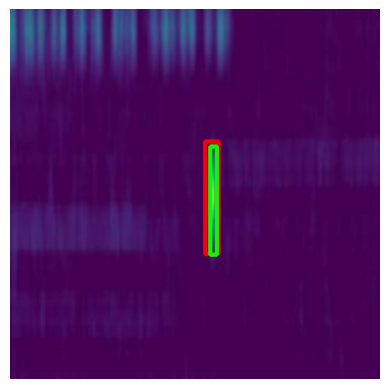

(448, 448, 3)
1061_target_ed71df474b16fd5371b05674322698ed
[(226.0, 169.0, 239.00000000000003, 293.0, 0.5850297212600708), (224.72965121269226, 178.88890075683594, 234.94463467597961, 290.88890075683594, 1.0)]


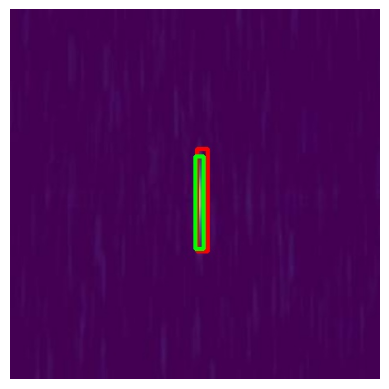

(448, 448, 3)
1075_target_428f9c5bc1b77cdcf17d420a10a09948
[(215.0, 167.0, 229.0, 295.0, 0.5828202962875366), (218.89250826835632, 171.1111125946045, 229.10749173164368, 290.8888874053955, 1.0)]


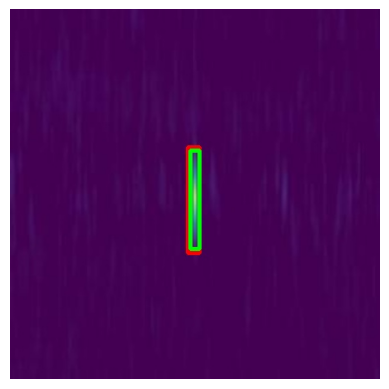

(448, 448, 3)
1078_stray_7c1f115c50192cdc79f362cdada10d2d
[(210.0, 50.0, 227.0, 172.0, 0.20627903938293457), (218.8925103545189, 40.444443702697754, 232.02606111764908, 189.77778148651123, 1.0)]


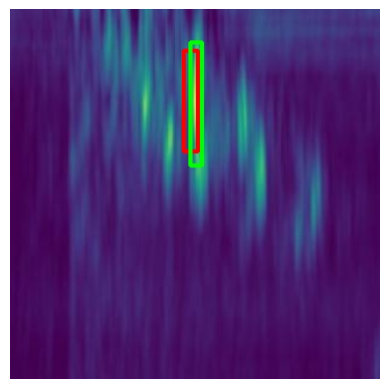

(448, 448, 3)
1086_stray_de270f17a8a8a5a7aa47113f9efb6dc0
[(19.0, 366.0, 37.0, 447.0, 0.18265095353126526), (11.674267530441284, 343.77778816223145, 26.267101526260376, 448.00001335144043, 1.0)]


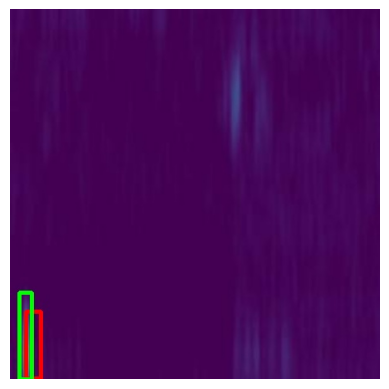

(448, 448, 3)
1091_stray_aabb7116364f57e4f41405de4f5c2087
[(293.0, 330.0, 308.0, 400.0, 0.1692763864994049), (283.10098803043365, 321.9999899864197, 310.8273719549179, 396.6666588783264, 1.0)]


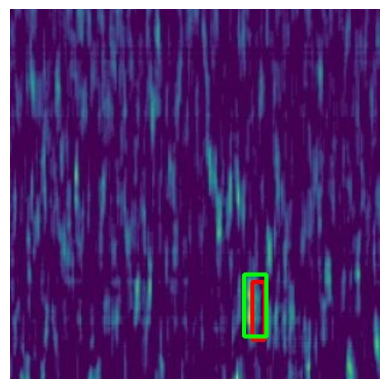

(448, 448, 3)
1092_stray_eb75a2b4af1cf82c1f475ce97097f84f
[(373.0, 0.0, 389.0, 81.0, 0.12714794278144836), (390.0, 1.0, 409.0, 85.0, 0.11081144958734512), (373.57655096054077, 0.0, 394.0065178871155, 93.33333110809326, 1.0)]


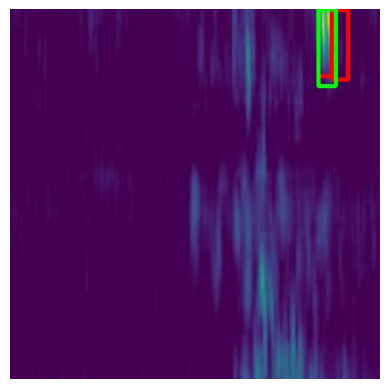

(448, 448, 3)
1105_stray_16bac37623aedec420caa831a7d021ef
[(255.0, 168.0, 267.0, 314.0, 0.24247436225414276), (121.99999999999999, 358.0, 146.0, 447.0, 0.18625493347644806), (234.0, 40.0, 254.0, 159.0, 0.17351579666137695), (258.2931572198868, 196.0, 286.01954114437103, 322.0, 1.0)]


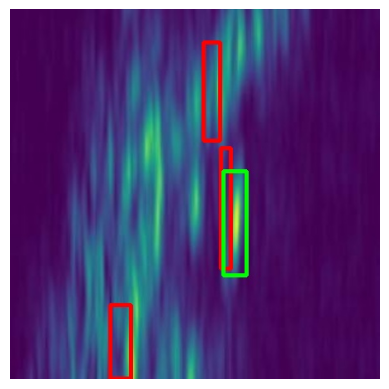

(448, 448, 3)
1109_target_e15bd87c56ab07e6981cc7665d3d0ce8
[(136.0, 27.0, 149.0, 170.0, 0.39485684037208557), (141.55048650503159, 23.33333110809326, 154.68403726816177, 172.66666889190674, 1.0)]


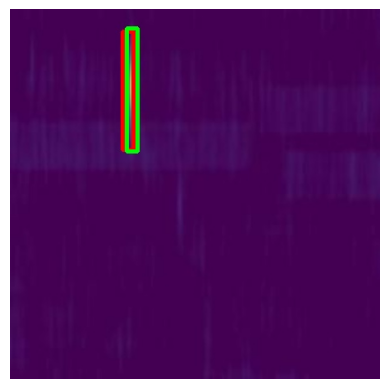

(448, 448, 3)
1119_target_20fb663113fee3368e54e0c9d1ed6921
[(204.0, 324.0, 220.0, 412.0, 0.31875893473625183), (197.00325977802277, 312.6666622161865, 204.2996767759323, 418.44443702697754, 1.0)]


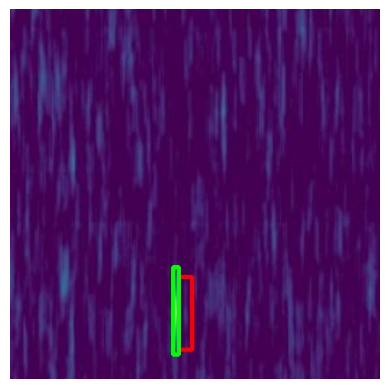

(448, 448, 3)
112_target_287a6da7d802abd0f8dac356f7ebb4a0
[(223.0, 191.0, 235.0, 275.0, 0.4631821811199188), (221.8110797405243, 188.22222185134888, 232.02606320381165, 273.7777781486511, 1.0)]


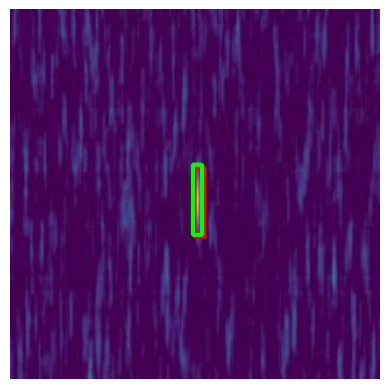

(448, 448, 3)
1130_target_67baab4506ebf3bc3e8db83c72a52d53
[(235.0, 170.0, 245.0, 288.0, 0.32071352005004883), (3.0, 362.0, 17.0, 447.0, 0.10370557010173798), (221.81108182668686, 154.00000667572021, 234.94463258981705, 290.8888940811157, 1.0)]


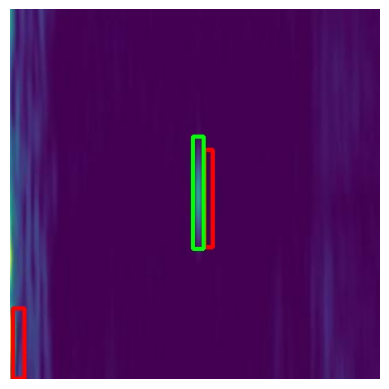

(448, 448, 3)
1132_target_c08dfb91e5892badecc89883ee33b444
[(207.0, 167.0, 219.0, 279.0, 0.5294599533081055), (201.38110613822937, 160.22221851348877, 211.59608960151672, 281.55555629730225, 1.0)]


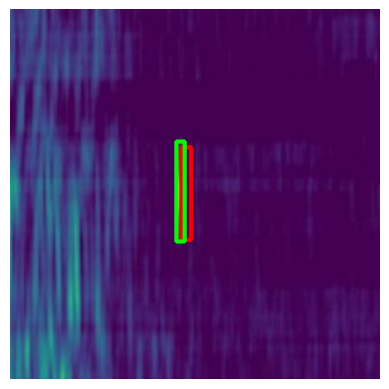

(448, 448, 3)
113_stray_2816052f8eca9af0a5dbfdc7d00673de
[(127.0, 52.0, 145.0, 174.0, 0.23376989364624023), (186.78826880455017, 84.0, 221.81106972694397, 224.0, 1.0)]


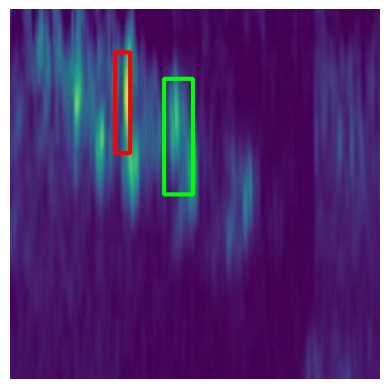

(448, 448, 3)
1145_target_b41b0b84f4a2e4531c4dc8e343ef2787
[(220.0, 176.0, 232.00000000000003, 307.0, 0.5619491338729858), (218.892498254776, 168.0, 233.4853322505951, 308.0, 1.0)]


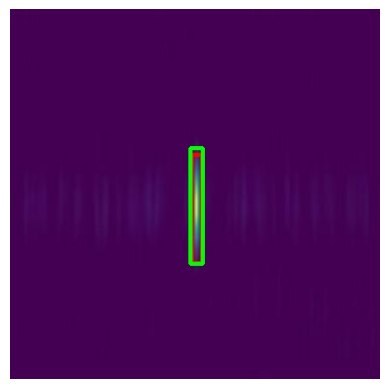

(448, 448, 3)
1164_stray_18feea6c81766952d789b4be9329a45e
[(362.0, 185.0, 378.0, 268.0, 0.18432223796844482), (370.65798366069794, 174.22221851348877, 396.9250851869583, 275.33333110809326, 1.0)]


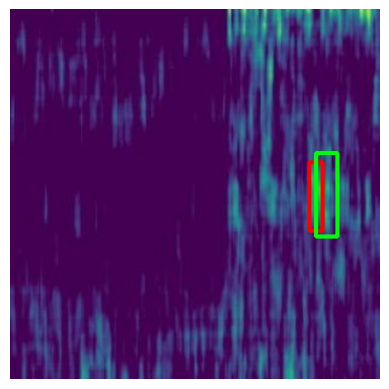

(448, 448, 3)
1167_target_ce0a8ae4227e68add12172b347408a01
[(227.0, 206.0, 242.0, 285.0, 0.18738776445388794), (23.0, 297.0, 38.0, 386.0, 0.14782723784446716), (217.43322920799255, 211.55554962158203, 236.40391373634338, 309.55554962158203, 1.0)]


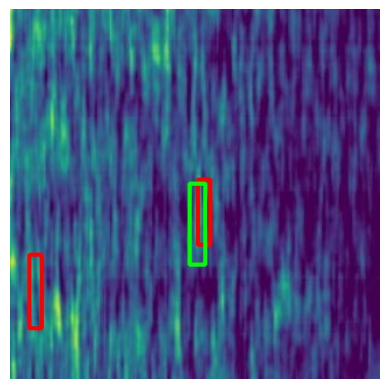

(448, 448, 3)
1184_target_c8e302bc91acf043790d13c2ba5e0288
[(234.0, 153.0, 250.99999999999997, 299.0, 0.537140965461731), (237.86318612098694, 157.1111125946045, 252.45602011680603, 284.6666622161865, 1.0)]


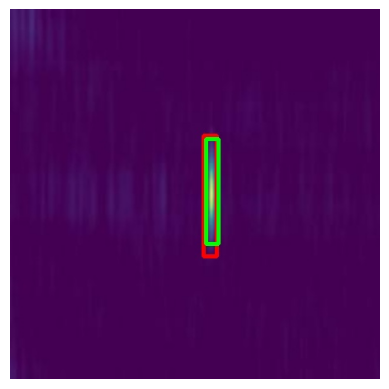

(448, 448, 3)
118_target_51acb9b53d407877387ece4e6eaebfc1
[(226.0, 168.0, 239.00000000000003, 294.0, 0.5904325246810913), (221.81108182668686, 161.77778816223145, 234.94463258981705, 309.55556297302246, 1.0)]


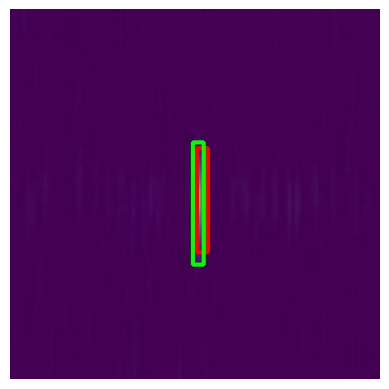

(448, 448, 3)
1192_target_3ec8e63903d22124d8e38a0ce14b8e10
[(225.00000000000003, 170.0, 236.99999999999997, 299.0, 0.6055212616920471), (221.81106972694397, 157.1111125946045, 236.40390372276306, 304.8888874053955, 1.0)]


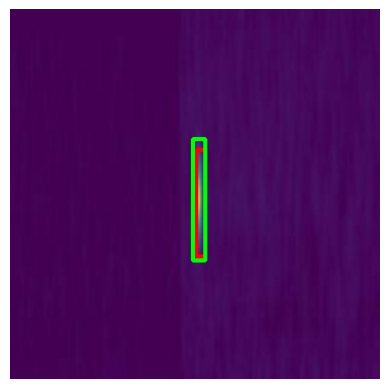

(448, 448, 3)
1211_stray_12a777f1b3cfc91e41b087ff99055e7d
[(35.0, 88.0, 49.0, 184.0, 0.12541848421096802), (20.429966926574707, 76.22221851348877, 40.859933853149414, 157.11110591888428, 1.0)]


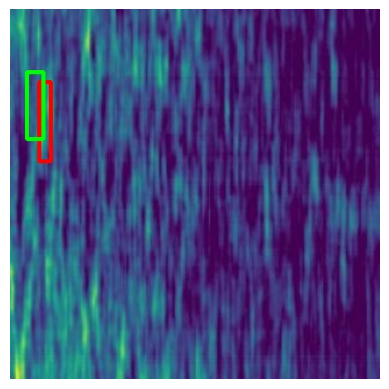

(448, 448, 3)
1222_target_4ed160ce28ee43099d74fd1d7d1329ad
[(217.0, 176.0, 229.99999999999997, 299.0, 0.5700595378875732), (218.89250826835632, 168.0, 229.10749173164368, 292.44445037841797, 1.0)]


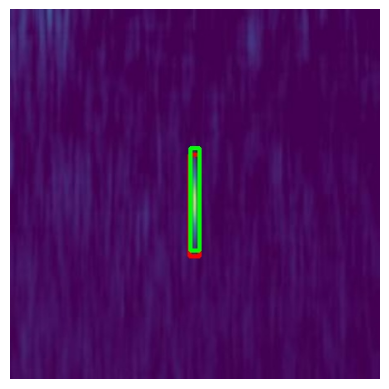

(448, 448, 3)
1224_stray_887b51560e30be173b99d1d2462f6175
[(144.0, 148.0, 162.0, 246.00000000000003, 0.18649080395698547), (153.22475028038025, 133.77777481079102, 172.19543480873108, 253.55554962158203, 1.0)]


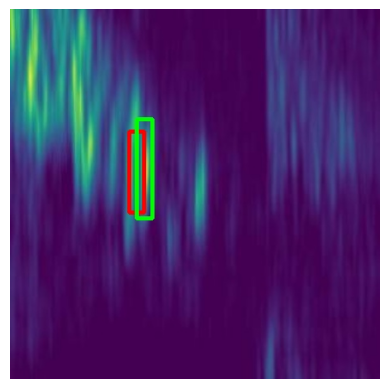

(448, 448, 3)
1233_stray_d2b101d3d0b060d8aa66d237722a3813
[(133.0, 203.0, 152.0, 314.0, 0.25961148738861084), (118.0, 196.0, 136.0, 319.0, 0.21202614903450012), (126.95765793323517, 172.66667556762695, 143.0097759962082, 311.1111259460449, 1.0)]


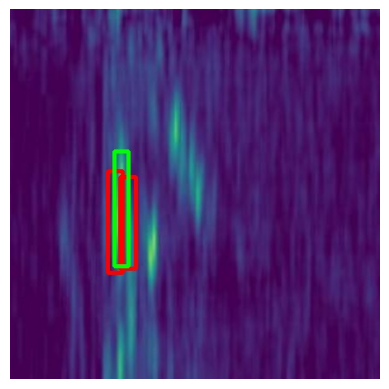

(448, 448, 3)
1234_target_56235c8f3610fabcd977df46c623e4fc
[(110.0, 305.0, 155.0, 433.0, 0.17573042213916779), (158.0, 254.0, 178.0, 382.0, 0.12730461359024048), (156.1433184146881, 275.33332443237305, 170.7361524105072, 399.777774810791, 1.0)]


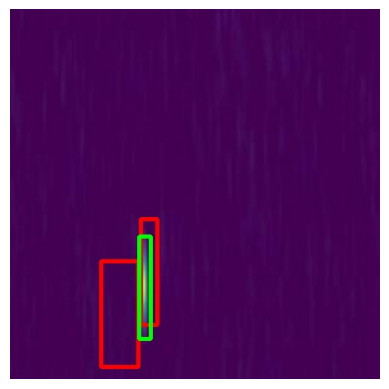

(448, 448, 3)
1258_target_6e06b2a1885687441bbccffbbbc707e5
[(217.0, 11.0, 231.0, 109.0, 0.34756284952163696), (218.892498254776, 0.0, 233.4853322505951, 110.44444370269775, 1.0)]


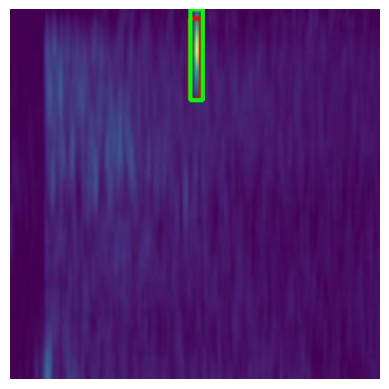

(448, 448, 3)
1274_target_6114dea211265f2d2a6b9988f48d1c61
[(220.0, 167.0, 232.00000000000003, 300.0, 0.5917731523513794), (220.3517940044403, 154.00000667572021, 230.56677746772766, 304.8888940811157, 1.0)]


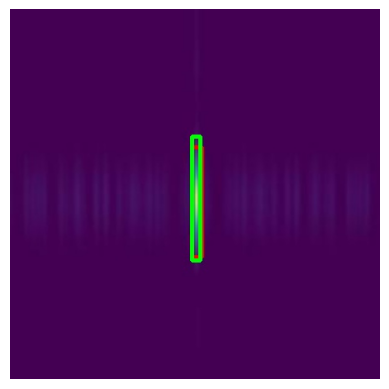

(448, 448, 3)
1281_target_ca1a881b235c8cb0817a07ef29e9eb15
[(222.0, 173.0, 236.99999999999997, 283.0, 0.4896467328071594), (0.0, 157.0, 16.0, 275.0, 0.12960095703601837), (220.35179817676544, 160.22221851348877, 236.40391623973846, 283.1111059188843, 1.0)]


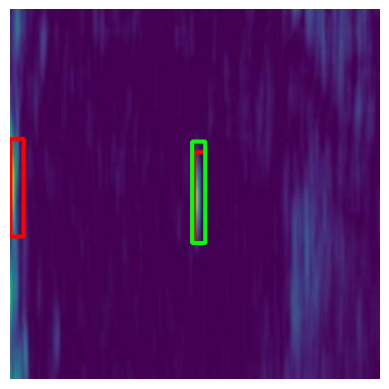

(448, 448, 3)
1292_target_130820055a6b4d6012d35662520cfa2f
[(228.0, 177.0, 242.0, 296.0, 0.5642634034156799), (223.27036547660828, 177.33332443237305, 233.48534893989563, 290.8888740539551, 1.0)]


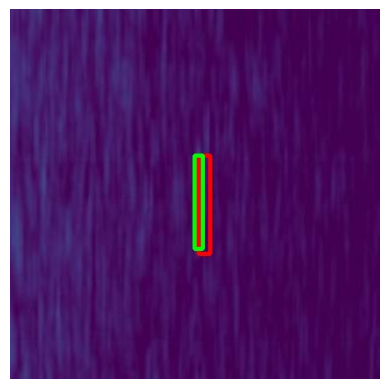

(448, 448, 3)
1298_stray_a9b78552509de038cd9b56b5d5ae2d60
[(266.0, 5.0, 285.0, 65.0, 0.10412180423736572), (21.889250576496124, 0.0, 33.56351727247238, 48.22222185134888, 1.0)]


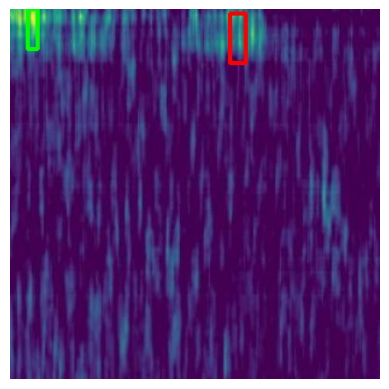

(448, 448, 3)
1315_target_91787276b8d263e44046bb09b654fdd2
[(218.0, 175.0, 229.99999999999997, 308.0, 0.5711319446563721), (221.8110772371292, 169.55556964874268, 229.10749423503876, 314.2222318649292, 1.0)]


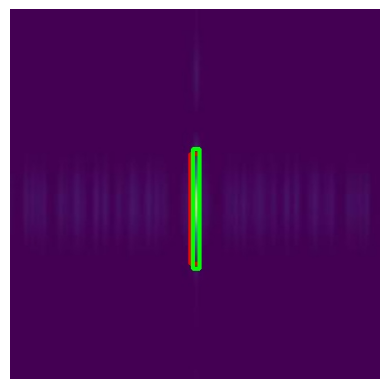

(448, 448, 3)
1343_stray_f8394622e1bf3af88a817225bc29c09d
[(340.0, 40.0, 360.0, 139.0, 0.11951994895935059), (410.0, 99.0, 429.0, 200.0, 0.11850583553314209), (294.0, 20.0, 312.0, 128.0, 0.11145544052124023), (367.7394009232521, 65.33333778381348, 379.41366761922836, 171.1111125946045, 1.0)]


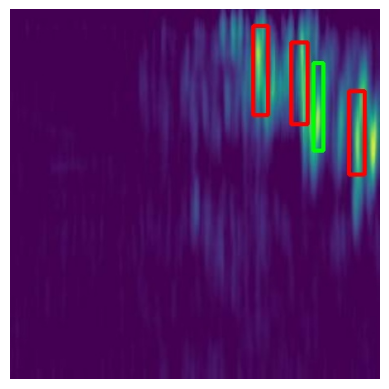

(448, 448, 3)
1359_target_dbcb08d93a3f2db02cfeab3bbbf6610a
[(223.0, 82.0, 235.0, 219.0, 0.42532938718795776), (221.8110676407814, 71.55555629730225, 233.48533433675766, 214.66666889190674, 1.0)]


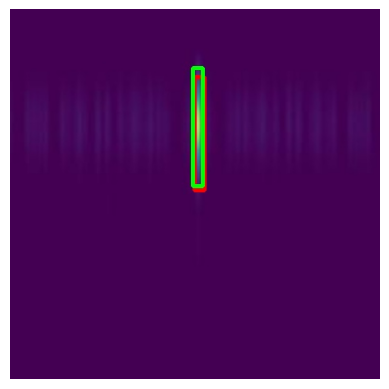

(448, 448, 3)
1364_stray_6f057a07791e78a003f298eadb44d3cc
[(75.0, 48.0, 90.0, 140.0, 0.11034754663705826), (70.04560101032257, 60.66666555404663, 86.0977190732956, 153.9999966621399, 1.0)]


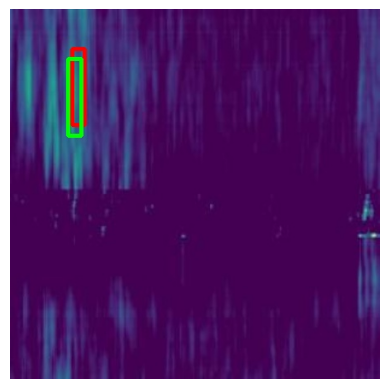

(448, 448, 3)
1401_stray_943b32e8b7463d8aadf9dfed319a0946
[(20.0, 177.0, 40.0, 290.0, 0.23844969272613525), (80.0, 24.0, 101.0, 138.0, 0.14530125260353088), (39.40065312385559, 155.55556297302246, 49.615636587142944, 317.3333377838135, 1.0)]


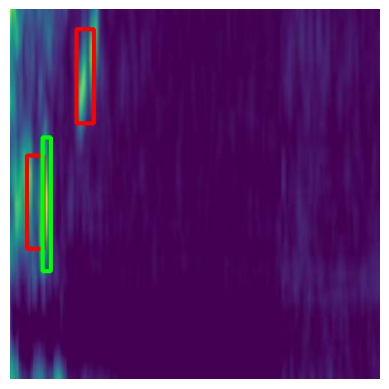

(448, 448, 3)
1413_target_0a45a84eda7d073ad055283103edd841
[(211.0, 4.0, 220.0, 70.0, 0.3072318136692047), (221.8110797405243, 0.0, 232.02606320381165, 51.33333444595337, 1.0)]


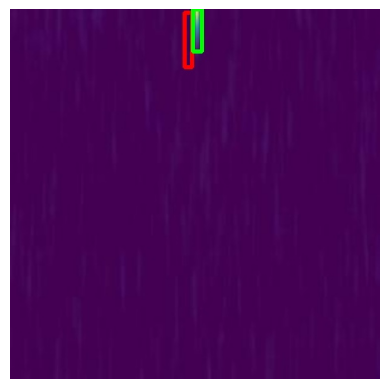

(448, 448, 3)
1422_stray_d650cf89d30036f8e0502547a8d886e0
[(95.0, 262.0, 106.0, 335.0, 0.21392922103405), (332.0, 355.0, 344.0, 424.0, 0.19860242307186127), (129.0, 247.0, 147.0, 313.0, 0.12705962359905243), (128.41693824529648, 241.11109924316406, 137.17263847589493, 325.11109924316406, 1.0)]


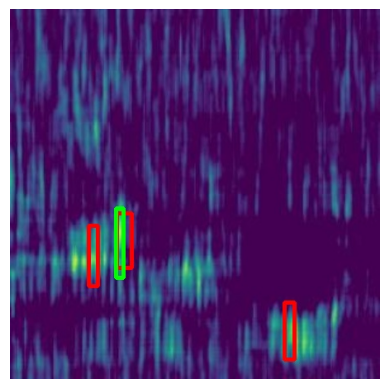

(448, 448, 3)
1431_target_e2494ac077f649ea0add68da11aec4e9
[(218.0, 0.0, 228.0, 132.0, 0.34599167108535767), (217.43322670459747, 0.0, 233.4853447675705, 132.22222518920898, 1.0)]


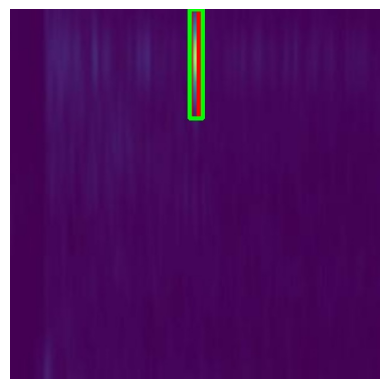

(448, 448, 3)
1437_stray_fd7a609d4c1a2c894e1677dec1dfae7a
[(71.0, 297.0, 93.0, 362.0, 0.14501185715198517), (48.0, 298.0, 63.0, 382.0, 0.10855743288993835), (78.80129998922348, 312.6666555404663, 91.93485075235367, 393.5555429458618, 1.0)]


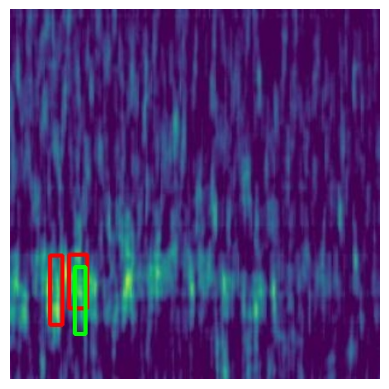

(448, 448, 3)
1452_stray_4bed97df965f7fa21af42621a220db37
[(26.267101526260376, 214.6666555404663, 45.237786054611206, 267.5555429458618, 1.0)]


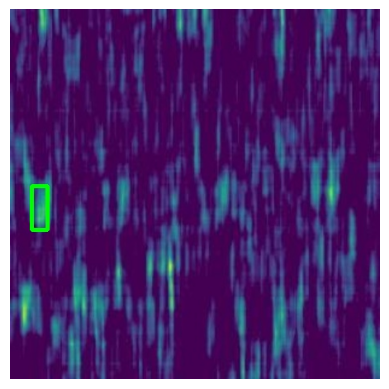

(448, 448, 3)
1462_stray_4193dc0930e62285f91d8ff689a25f30
[(271.0, 188.0, 282.0, 267.0, 0.2684539556503296), (350.0, 177.0, 368.0, 250.99999999999997, 0.1173567846417427), (379.413672208786, 174.22221517562866, 389.62865567207336, 262.8888840675354, 1.0)]


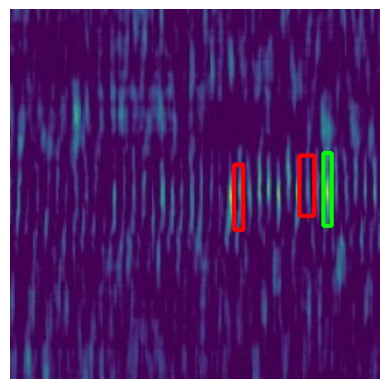

(448, 448, 3)
1463_stray_9b145c092e9ace95be5bc480089a6dfb
[(290.0, 176.0, 306.0, 241.0, 0.1336977481842041), (411.0, 363.0, 426.0, 438.0, 0.10530295222997665), (293.3159493803978, 166.44445037841797, 306.449500143528, 230.22222518920898, 1.0)]


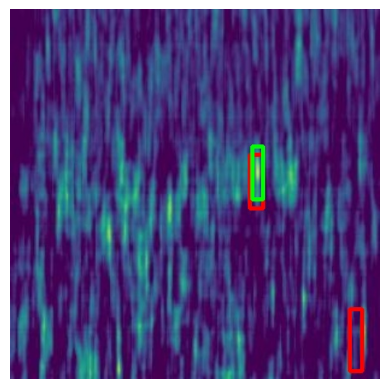

(448, 448, 3)
1464_stray_350459bc9cb42ef8492cdb78496b03a7
[(241.0, 337.0, 258.0, 408.0, 0.27055060863494873), (223.0, 344.0, 240.0, 423.0, 0.12681935727596283), (18.970683693885803, 70.00000333786011, 35.022801756858826, 135.33333444595337, 1.0)]


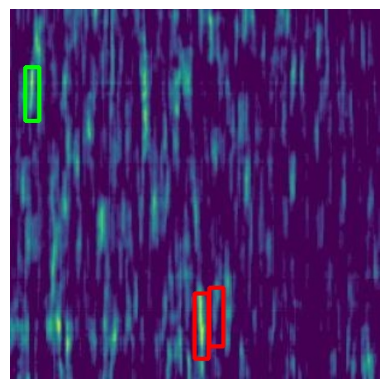

(448, 448, 3)
1470_stray_412b3559caa7ee741b8fecb9fb059873
[(99.0, 109.0, 116.00000000000001, 176.0, 0.15246403217315674), (129.0, 113.0, 148.0, 177.0, 0.13074244558811188), (84.6384362578392, 104.22222185134888, 97.77198702096939, 175.77777814865112, 1.0)]


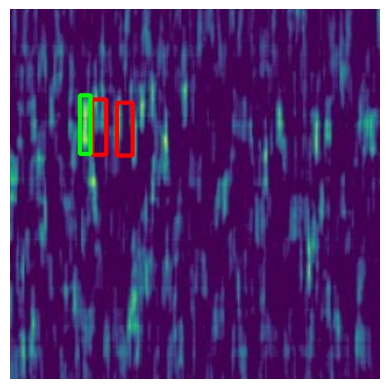

(448, 448, 3)
1487_target_04a7236600f5958f56a73ddb0cd4c7da
[(225.00000000000003, 172.0, 236.99999999999997, 300.0, 0.5755106806755066), (218.89251244068146, 166.44443702697754, 234.94463050365448, 300.22221183776855, 1.0)]


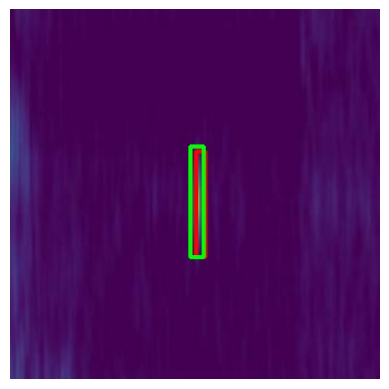

(448, 448, 3)
1497_target_d47619ddd029e76410b4be608139991e
[(222.0, 167.0, 233.0, 292.0, 0.6000363826751709), (220.35179609060287, 160.22221851348877, 233.48534685373306, 290.8888807296753, 1.0)]


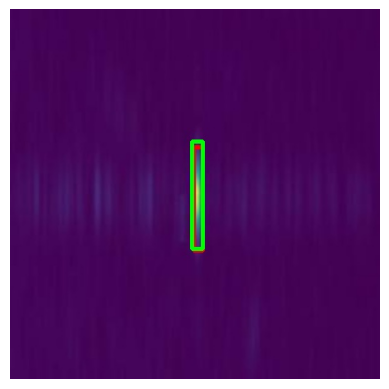

(448, 448, 3)
1512_target_4cd134a3e461d9bb4a13037f8bd1a67d
[(0.0, 234.0, 10.0, 345.0, 0.15912416577339172), (4.377849698066711, 267.55555963516235, 23.34853422641754, 346.8888907432556, 1.0)]


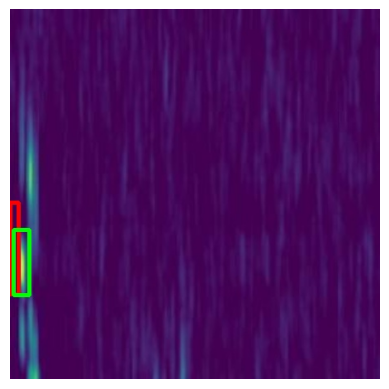

(448, 448, 3)
1515_stray_9b6ae0479ff2d99a11edfca4af912ad5
[(71.50488924980164, 222.44445037841797, 81.71987271308899, 320.44445037841797, 1.0)]


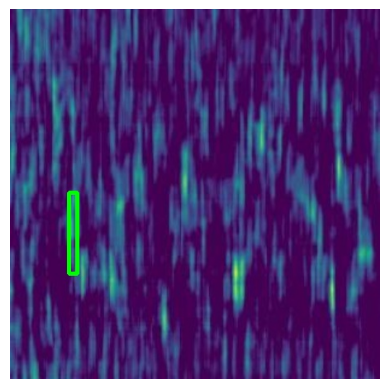

(448, 448, 3)
151_stray_7a1ce7f62d5c7d31d2ae275bdff8884d
[(121.99999999999999, 109.0, 137.0, 220.0, 0.18201905488967896), (97.0, 389.0, 114.99999999999999, 445.0, 0.13259053230285645), (110.90553653240204, 113.55555629730225, 137.17263805866241, 234.88889408111572, 1.0)]


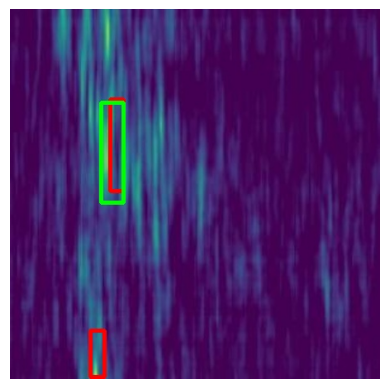

(448, 448, 3)
1522_target_9dfa4a0d1b30d4db5682cc995a61098b
[(278.0, 361.0, 288.0, 432.0, 0.1848973035812378), (265.0, 62.0, 277.0, 202.0, 0.16445788741111755), (241.0, 100.0, 256.0, 212.0, 0.14881713688373566), (256.8338840007782, 80.88888740539551, 267.04886746406555, 199.1111125946045, 1.0)]


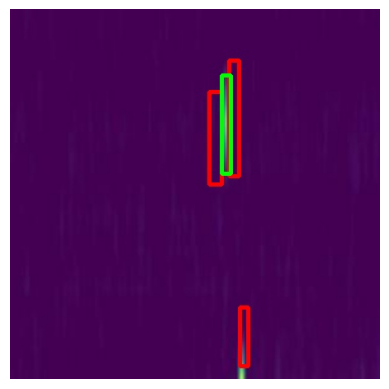

(448, 448, 3)
1523_target_c00de9535c7816a902a6efd3749c7449
[(218.0, 165.0, 231.0, 290.0, 0.5976413488388062), (218.8925103545189, 169.55555629730225, 232.02606111764908, 292.44444370269775, 1.0)]


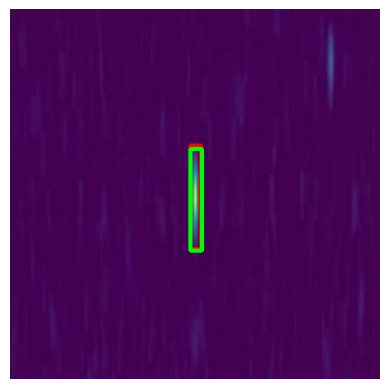

(448, 448, 3)
153_target_7a670578b18e3d0dc538e5c1fb07263c
[(221.0, 176.0, 233.0, 303.0, 0.5683083534240723), (220.35178190469742, 169.55554962158203, 232.02604860067368, 308.0, 1.0)]


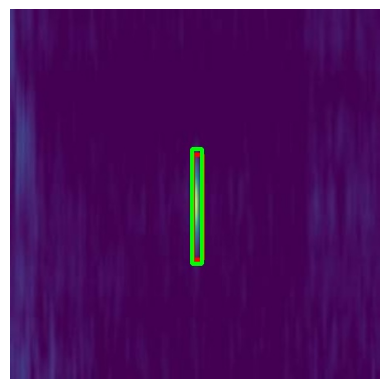

(448, 448, 3)
1540_target_456a21c2413c0a87b35bfb30ea6146cf
[(197.0, 161.0, 208.0, 276.0, 0.23716731369495392), (273.0, 299.0, 304.0, 408.0, 0.1624823361635208), (291.8566903471947, 276.8888807296753, 304.99024111032486, 398.22221851348877, 1.0)]


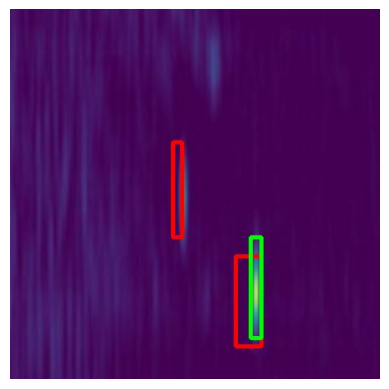

(448, 448, 3)
1572_target_ddc1ffeb2a2c4e500549df450f505ad7
[(218.0, 173.0, 231.0, 300.0, 0.5789642333984375), (220.35177940130234, 169.55554962158203, 229.1074796319008, 295.55554962158203, 1.0)]


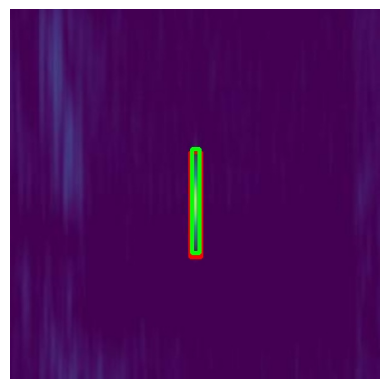

(448, 448, 3)
1592_stray_ce60d2dbe86989cdd950b0bdeedf6b23
[(293.0, 93.0, 303.0, 224.0, 0.32596471905708313), (304.0, 126.0, 316.0, 267.0, 0.1501515507698059), (288.9380992650986, 130.66666221618652, 310.8273502588272, 297.1111125946045, 1.0)]


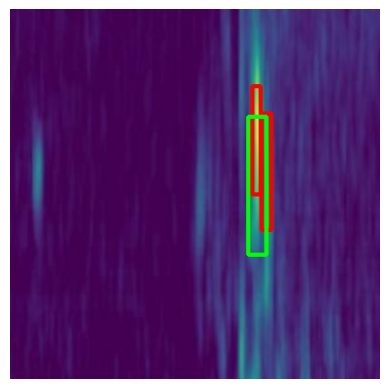

(448, 448, 3)
1598_target_2f5a558888787610b2bcb12249209b4f
[(228.0, 136.0, 243.0, 275.0, 0.4599476158618927), (229.10748380422592, 110.44445037841797, 242.2410345673561, 294.0, 1.0)]


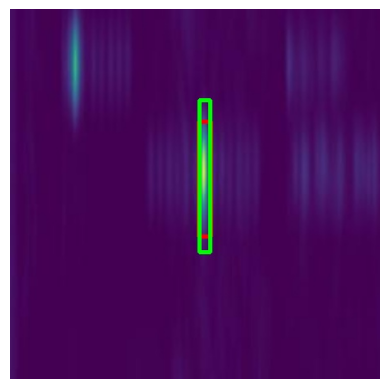

(448, 448, 3)
1612_target_57e3c9ce1e75777235a2b858a43becf4
[(226.0, 188.0, 239.00000000000003, 277.0, 0.5271549820899963), (215.9739292860031, 178.8888874053955, 233.4853297472, 283.1111125946045, 1.0)]


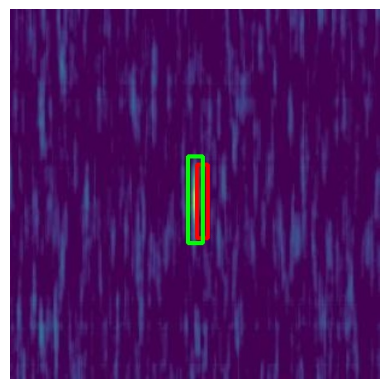

(448, 448, 3)
1656_target_b4707d32621fc82c93580cb47d2d3b93
[(219.0, 161.0, 232.00000000000003, 296.0, 0.6032024621963501), (220.3517940044403, 157.1111192703247, 230.56677746772766, 301.77778148651123, 1.0)]


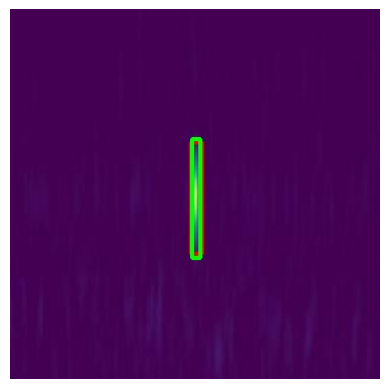

(448, 448, 3)
1679_target_f0c0ec2130987eae9ac0ebeaad6a80ab
[(229.0, 186.0, 243.0, 298.0, 0.4802030920982361), (224.72965121269226, 186.6666555404663, 234.94463467597961, 281.5555429458618, 1.0)]


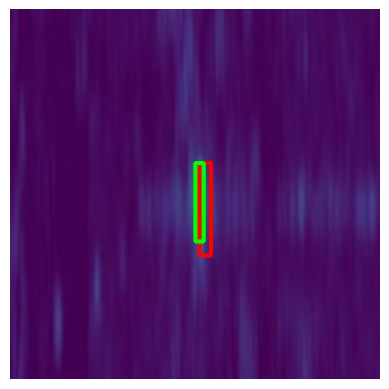

(448, 448, 3)
1689_target_9d80b83e6c9eb6208153c12de12d5841
[(175.0, 214.0, 192.0, 350.0, 0.2547987103462219), (49.0, 0.0, 68.0, 73.0, 0.18922515213489532), (170.73616117238998, 228.66667556762695, 183.86971193552017, 370.222225189209, 1.0)]


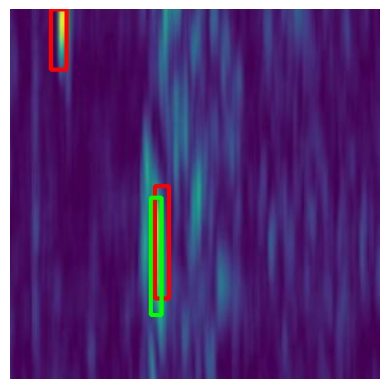

(448, 448, 3)
1699_target_941fd57422fd4a6b8d349ffd7b4620a2
[(229.0, 176.0, 240.0, 296.0, 0.5518806576728821), (223.27036547660828, 185.1111192703247, 233.48534893989563, 301.77778148651123, 1.0)]


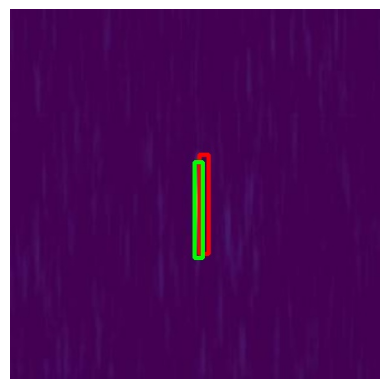

(448, 448, 3)
1702_stray_eabf34dda679d573805ece036f9af823
[(357.0, 303.0, 374.0, 422.0, 0.16406883299350739), (366.2801339626312, 290.8888940811157, 385.25081849098206, 406.0000066757202, 1.0)]


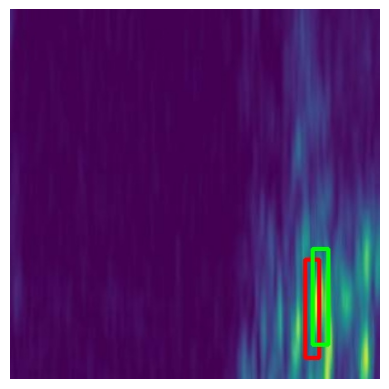

(448, 448, 3)
1707_stray_380110f078d0b1733868a7247a8c8006
[(423.0, 226.0, 441.0, 307.0, 0.1284710019826889), (431.947882771492, 211.55556297302246, 448.000000834465, 303.3333377838135, 1.0)]


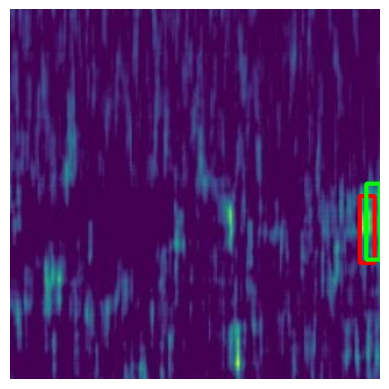

(448, 448, 3)
1708_stray_6810cbbe7fd4ed3e00a344b128b2a850
[(159.0, 59.0, 178.0, 167.0, 0.1868974268436432), (98.0, 293.0, 121.0, 401.0, 0.15597909688949585), (219.0, 172.0, 231.0, 285.0, 0.13655927777290344), (186.0, 44.0, 205.0, 152.0, 0.12188994139432907), (130.0, 88.0, 148.0, 207.0, 0.11839329451322556), (103.0, 165.0, 125.0, 272.0, 0.10816745460033417), (224.72964119911194, 177.33332443237305, 239.32247519493103, 301.777774810791, 1.0)]


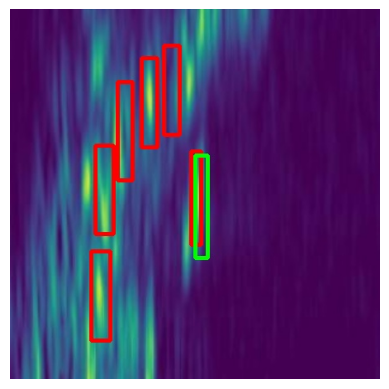

(448, 448, 3)
1715_target_ebadb857fb507d4236214f28e002e7fe
[(206.0, 151.0, 218.0, 283.0, 0.5484925508499146), (207.21823447942734, 163.33333110809326, 215.9739347100258, 279.9999933242798, 1.0)]


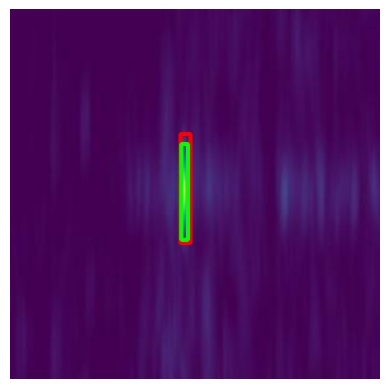

(448, 448, 3)
1720_target_8d908716e8ff968334e457061007908f
[(45.0, 0.0, 60.0, 76.0, 0.16905450820922852), (51.07491898536682, 0.0, 65.66775298118591, 91.77777481079102, 1.0)]


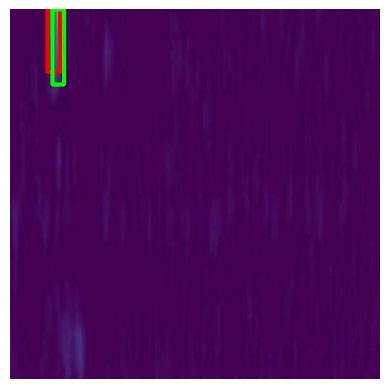

(448, 448, 3)
1723_stray_b644fe3644fa0ddf7ec28db98a2d9074
[(373.0, 37.0, 389.0, 155.0, 0.2379777431488037), (356.06514632701874, 256.66667556762695, 373.57654678821564, 382.66667556762695, 1.0)]


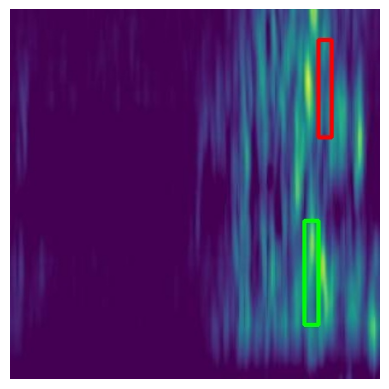

(448, 448, 3)
1727_target_6f4236a7c1d585d2667ed7e73663eb63
[(86.0, 190.0, 105.0, 236.0, 0.25707441568374634), (33.0, 184.0, 48.0, 243.0, 0.1492622047662735), (221.0, 187.0, 236.0, 250.99999999999997, 0.10433170944452286), (90.47557210922241, 203.7777714729309, 110.90553903579712, 247.33332777023315, 1.0)]


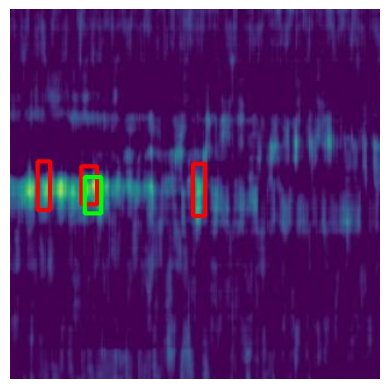

(448, 448, 3)
1752_stray_cfd76e912189afc6b607b86841e31b02
[(1.0, 36.0, 18.0, 162.0, 0.13244128227233887), (0.0, 26.44445037841797, 8.75570023059845, 202.22222518920898, 1.0)]


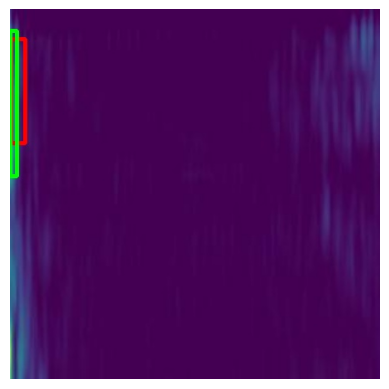

(448, 448, 3)
1754_target_8c1a1430002faaf18885508cb7198186
[(171.0, 190.0, 183.0, 294.0, 0.3563121259212494), (173.65472054481506, 199.1111159324646, 188.24755454063416, 287.77778482437134, 1.0)]


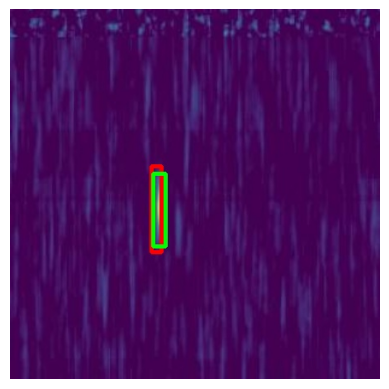

(448, 448, 3)
1763_stray_5a37ad564d62020339a1929d83e34beb
[(229.99999999999997, 311.0, 247.0, 406.0, 0.19616904854774475), (221.0, 186.0, 238.0, 278.0, 0.106650710105896), (218.892498254776, 323.55554962158203, 233.4853322505951, 448.0, 1.0)]


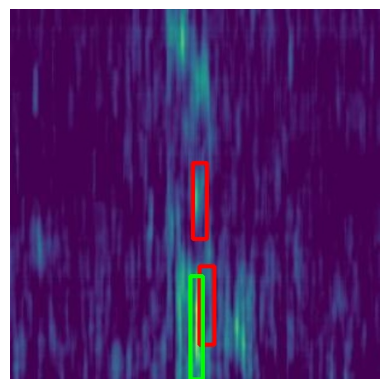

(448, 448, 3)
1769_stray_3c1c1d5abba40331e63a8ff627a8a099
[(169.0, 185.0, 189.0, 281.0, 0.43555977940559387), (80.0, 0.0, 98.0, 66.0, 0.12784413993358612), (163.43973875045776, 194.44444704055786, 183.86970567703247, 294.0000033378601, 1.0)]


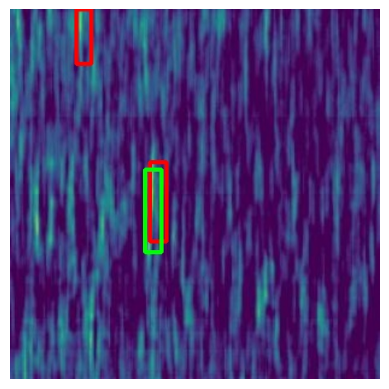

(448, 448, 3)
1791_stray_2ed0fe6a9d6e187bfca1d1fc8fbe0e76
[(22.0, 74.0, 38.0, 153.0, 0.1517329066991806), (16.05211639404297, 76.22222185134888, 30.64495038986206, 144.66666555404663, 1.0)]


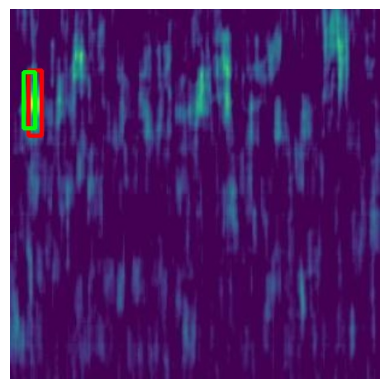

(448, 448, 3)
1794_stray_9d3cdacb1ad10444e682bfec52980627
[(114.99999999999999, 243.0, 129.0, 319.0, 0.26306357979774475), (77.0, 9.0, 92.0, 70.0, 0.10489606112241745), (162.0, 6.0, 173.0, 66.0, 0.10198068618774414), (75.8827343583107, 0.0, 87.55700105428696, 62.222225189208984, 1.0)]


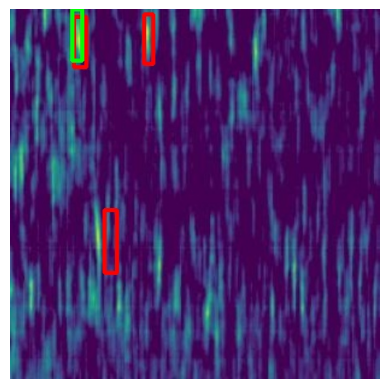

(448, 448, 3)
1799_stray_aa93ea381654f41eebe7a1923fc1fded
[(284.0, 136.0, 300.0, 264.0, 0.2168649584054947), (31.0, 379.0, 46.0, 443.0, 0.11380793899297714), (280.18241906166077, 152.44444704055786, 294.77525305747986, 245.77777814865112, 1.0)]


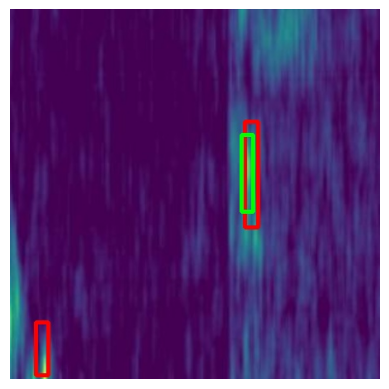

(448, 448, 3)
1816_stray_1952316be50a0e3e3b54e2696771eb18
[(38.0, 217.0, 56.0, 331.0, 0.1868443787097931), (105.0, 51.0, 123.00000000000001, 158.0, 0.10551188141107559), (99.23127150535583, 90.22222185134888, 109.44625496864319, 189.77777814865112, 1.0)]


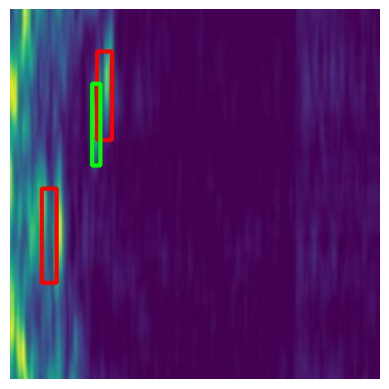

(448, 448, 3)
1819_target_d45146a67dd27518bf9675cae442be67
[(217.0, 152.0, 229.99999999999997, 286.0, 0.6355430483818054), (217.43322670459747, 136.88889408111572, 233.4853447675705, 294.0000066757202, 1.0)]


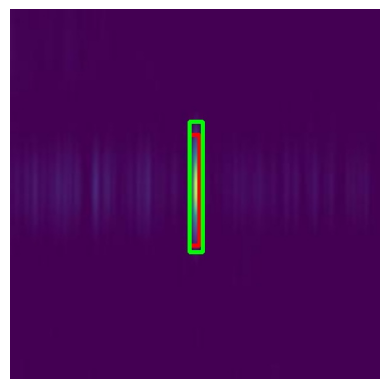

(448, 448, 3)
1824_stray_b74864ccafc121b801cfff437abe3534
[(347.0, 11.0, 365.0, 111.0, 0.27661678194999695), (205.0, 162.0, 227.0, 290.0, 0.2649298906326294), (224.0, 217.0, 242.0, 344.0, 0.21662023663520813), (215.9739380478859, 169.55554962158203, 227.64820474386215, 283.11109924316406, 1.0)]


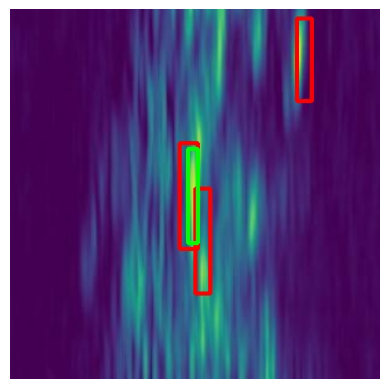

(448, 448, 3)
1825_stray_e9ec764afe44a453eafa91e957c1a5a2
[(34.0, 136.0, 46.0, 257.0, 0.3266318738460541), (42.319217920303345, 122.88888740539551, 52.5342013835907, 289.3333377838135, 1.0)]


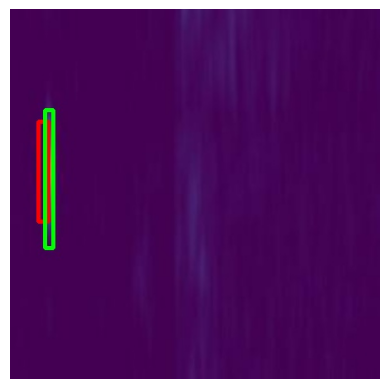

(448, 448, 3)
1826_target_41ea975ec788266350fb6f578ccb2b69
[(10.0, 54.0, 23.0, 130.0, 0.18446660041809082), (224.0, 196.0, 242.0, 281.0, 0.11011437326669693), (236.4039170742035, 202.22221851348877, 255.37460160255432, 275.33333110809326, 1.0)]


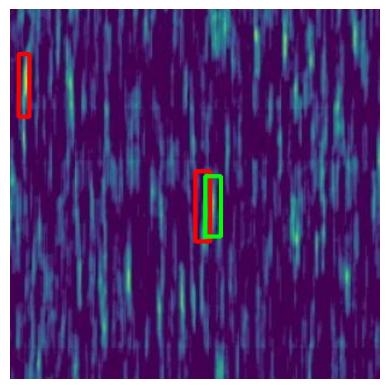

(448, 448, 3)
1828_stray_be122cbf72bbf5fb233a3c8ce78562df
[(286.0, 128.0, 307.0, 201.0, 0.14688627421855927), (353.1465915441513, 132.22221851348877, 375.03584253787994, 227.11110591888428, 1.0)]


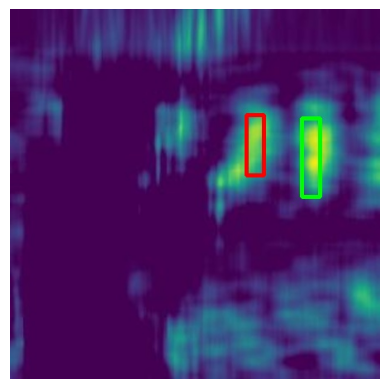

(448, 448, 3)
1838_stray_712537be23fdd82603686e345a5569cd
[(11.674267530441284, 180.44444370269775, 26.267101526260376, 297.1111059188843, 1.0)]


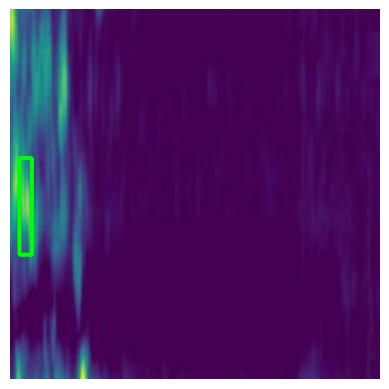

(448, 448, 3)
1845_target_1479a4db2dc3688494a485ca4f888474
[(191.0, 195.0, 206.0, 267.0, 0.4364696741104126), (198.46253675222397, 182.0, 211.59608751535416, 258.222225189209, 1.0)]


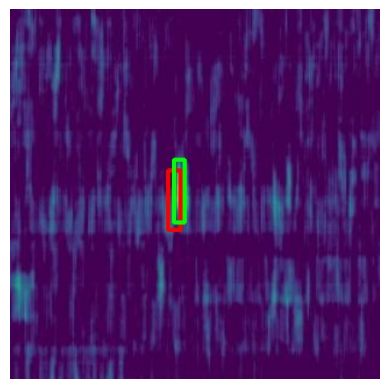

(448, 448, 3)
1848_stray_69483d22dc2b88fb92afc057f57ffe64
[(0.0, 161.0, 11.0, 283.0, 0.1438215672969818), (0.0, 172.66666555404663, 20.429966926574707, 269.1111092567444, 1.0)]


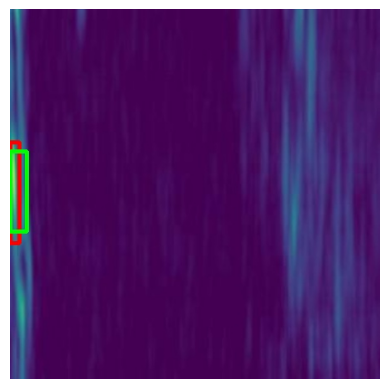

(448, 448, 3)
1861_stray_2aefaab26de163f82d46ef18d2ac8772
[(256.83388608694077, 0.0, 269.96743685007095, 42.0, 1.0)]


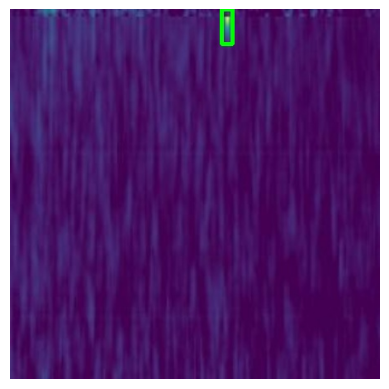

(448, 448, 3)
1863_target_3591daa41878883d8db9a1bfb9dae0c9
[(235.0, 150.0, 247.0, 292.0, 0.4893410801887512), (245.15959811210632, 161.77778816223145, 255.37458157539368, 294.00001335144043, 1.0)]


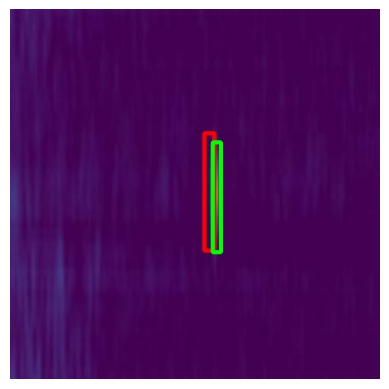

(448, 448, 3)
186_target_b71ad4a8e0b7c1cf1c3d631434473ef0
[(224.0, 175.0, 236.99999999999997, 300.0, 0.5912816524505615), (223.2703533768654, 163.3333444595337, 234.94462007284164, 306.4444570541382, 1.0)]


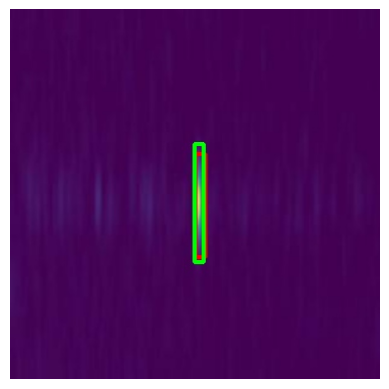

(448, 448, 3)
1877_stray_1c4aa77ac43a8d5fbf8a2e5ebee2f7f1
[(19.0, 356.0, 34.0, 447.0, 0.10927559435367584), (21.889249742031097, 364.0, 35.022800505161285, 448.0, 1.0)]


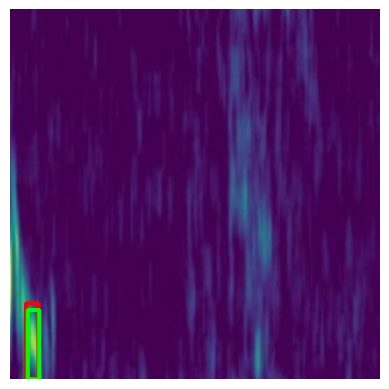

(448, 448, 3)
1880_target_d03a90f3ec175756d4cbf490785b1008
[(128.0, 0.0, 142.0, 54.0, 0.2718874514102936), (135.71335691213608, 0.0, 148.84690767526627, 48.22222185134888, 1.0)]


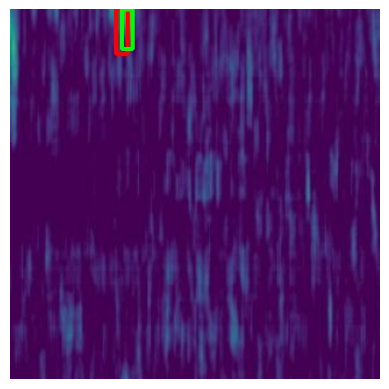

(448, 448, 3)
1903_target_4c38eabdd42eadd41ecf21db96597c45
[(21.0, 368.0, 36.0, 439.0, 0.11211474239826202), (24.80781787633896, 272.2222218513489, 37.94136863946915, 371.7777781486511, 1.0)]


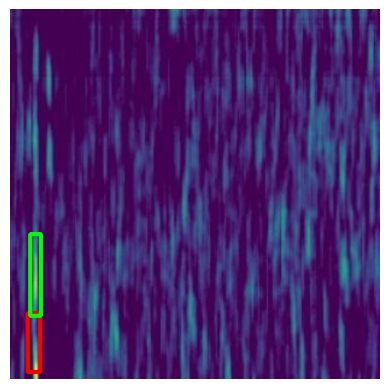

(448, 448, 3)
1908_target_1c87d96160a15d51b49e56527279345d
[(227.0, 144.0, 243.0, 282.0, 0.526810348033905), (227.6482001543045, 143.11110591888428, 243.70031821727753, 278.44444370269775, 1.0)]


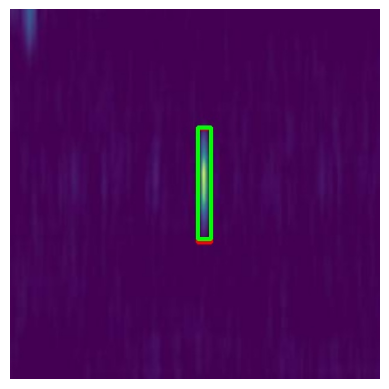

(448, 448, 3)
1912_target_7b9c3572ed614b7cf18bfbd674189ba3
[(207.0, 121.0, 216.0, 188.0, 0.2954099774360657), (208.6775227189064, 116.66667222976685, 220.35178941488266, 188.2222285270691, 1.0)]


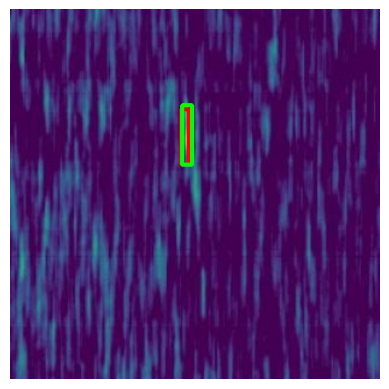

(448, 448, 3)
1917_target_d09e23c346320951b7e611c4451fea14
[(225.00000000000003, 183.0, 238.0, 290.0, 0.5411757826805115), (218.892498254776, 188.2222352027893, 233.4853322505951, 295.55556631088257, 1.0)]


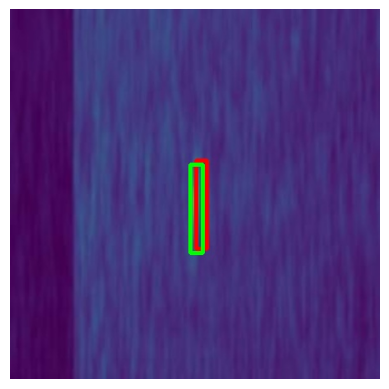

(448, 448, 3)
1921_stray_92b76517340602dedda9265758ff2958
[(202.0, 202.0, 217.0, 302.0, 0.30734890699386597), (184.0, 187.0, 199.0, 313.0, 0.1463860124349594), (197.00325226783752, 216.22222518920898, 211.59608626365662, 300.222225189209, 1.0)]


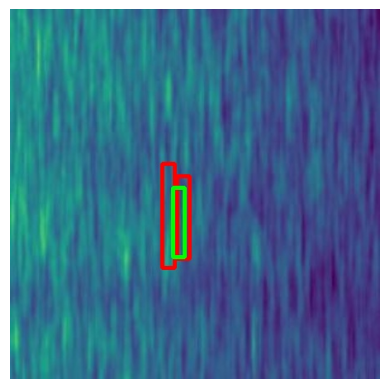

(448, 448, 3)
1932_target_4a7d684f17cd44de9a3fd76284998227
[(173.0, 165.0, 183.0, 275.0, 0.3831660747528076), (178.03257775306702, 172.66665887832642, 192.6254117488861, 279.9999899864197, 1.0)]


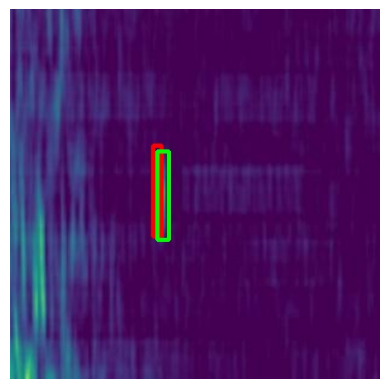

(448, 448, 3)
1936_stray_92b3378fcc9fd5572e6d2f492f96e662
[(397.0, 242.0, 417.0, 306.0, 0.17898043990135193), (137.0, 136.0, 153.0, 200.0, 0.14585092663764954), (402.76221936941147, 227.1111192703247, 415.89577013254166, 300.2222318649292, 1.0)]


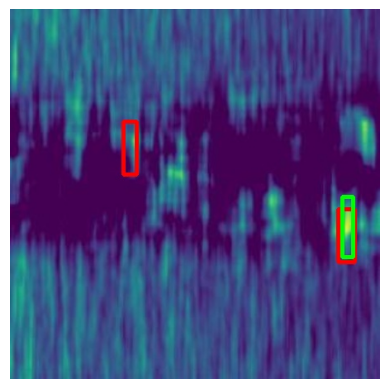

(448, 448, 3)
1937_target_d379ff8617ffd69b32a8fca6a629369d
[(5.0, 242.0, 18.0, 324.0, 0.17364659905433655), (224.0, 191.0, 242.0, 272.0, 0.14336039125919342), (223.2703696489334, 196.00001001358032, 239.32248771190643, 289.3333411216736, 1.0)]


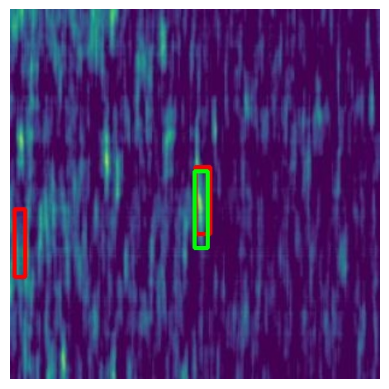

(448, 448, 3)
1947_target_fd404a0fcd68fb423144180681ad6994
[(290.0, 129.0, 307.0, 199.0, 0.16937758028507233), (250.99999999999997, 1.0, 269.0, 70.0, 0.1686055213212967), (286.019540309906, 116.66666221618652, 306.4495072364807, 186.66666221618652, 1.0)]


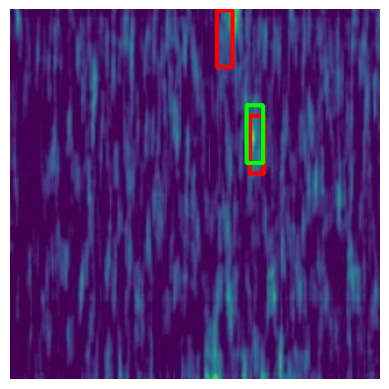

(448, 448, 3)
198_target_dbc96f5f3733fabf732b269c54e3b8a8
[(228.0, 177.0, 242.0, 307.0, 0.5666487216949463), (224.72965121269226, 175.77778816223145, 234.94463467597961, 308.00001335144043, 1.0)]


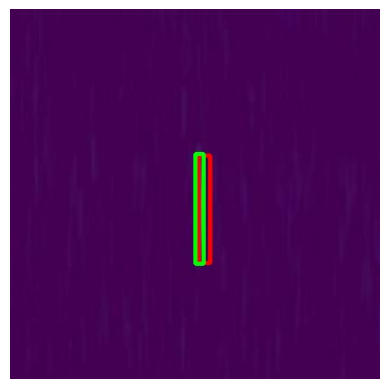

(448, 448, 3)
1997_stray_e742cf549a0c0d35c40dd9a8297c810b
[(221.0, 379.0, 245.0, 447.0, 0.30757948756217957), (224.72965121269226, 346.8888940811157, 234.94463467597961, 448.0000066757202, 1.0)]


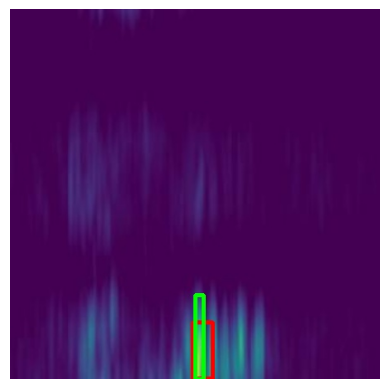

(448, 448, 3)
19_stray_d83c78a3be68c4880341b15d0cbd3dd6
[(9.0, 272.0, 26.0, 405.0, 0.13524723052978516), (416.0, 0.0, 433.0, 66.0, 0.1224578469991684), (0.0, 276.88889741897583, 20.429966926574707, 376.4444537162781, 1.0)]


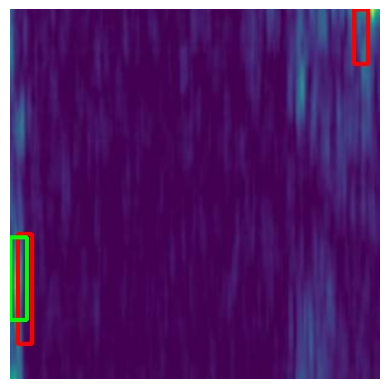

(448, 448, 3)
1_stray_1f7552fbe2c01119bca1400364f036e4
[(38.0, 225.00000000000003, 51.0, 312.0, 0.20813274383544922), (81.0, 12.0, 103.0, 76.0, 0.1443781554698944), (51.07491773366928, 236.44443702697754, 64.20846849679947, 314.22221183776855, 1.0)]


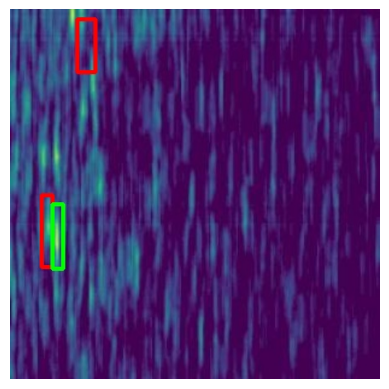

(448, 448, 3)
2001_stray_fa29dd99fbda24074f85e08ad1b3f469
[(140.0, 348.0, 156.0, 426.0, 0.3230101466178894), (225.00000000000003, 35.0, 242.0, 108.0, 0.13107164204120636), (236.4039170742035, 26.44444704055786, 255.37460160255432, 119.77777814865112, 1.0)]


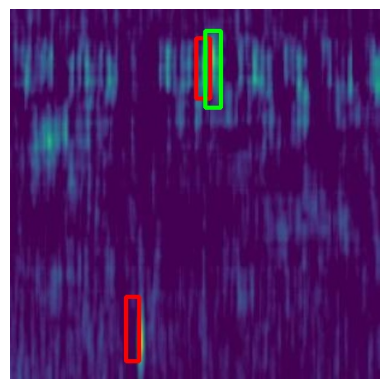

(448, 448, 3)
2015_stray_af112d12adc1ddd4d162502639b32c5b
[(75.0, 128.0, 94.0, 194.0, 0.2551132142543793), (334.0, 188.0, 348.0, 250.0, 0.14576321840286255), (75.88273644447327, 101.11110591888428, 90.47557044029236, 181.99999332427979, 1.0)]


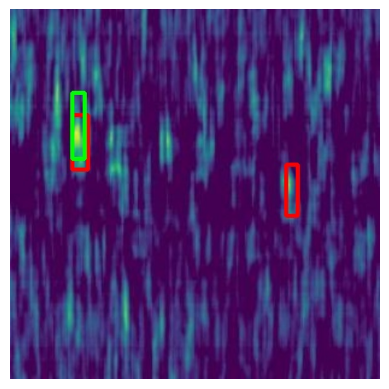

(448, 448, 3)
2016_stray_842879c75f08c2888f726857de6b0f2f
[(120.0, 214.0, 136.0, 297.0, 0.33930301666259766), (134.25407242774963, 206.88889074325562, 148.84690642356873, 309.55555963516235, 1.0)]


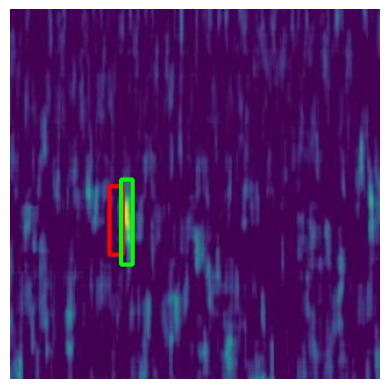

(448, 448, 3)
2022_target_d91cdc44a0372afd00a3681d94fdcfac
[(220.0, 175.0, 233.0, 299.0, 0.5888833403587341), (218.89249616861343, 175.77777481079102, 230.5667628645897, 301.777774810791, 1.0)]


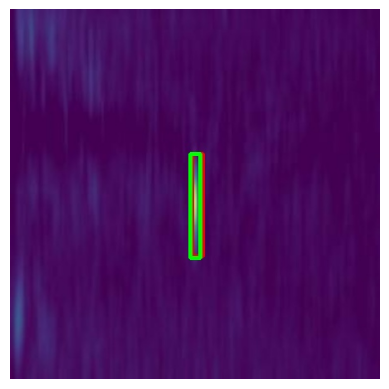

(448, 448, 3)
2043_target_472085e2742b21e240310d932d1b3da2
[(219.0, 175.0, 229.99999999999997, 311.0, 0.5764820575714111), (221.81106513738632, 163.33333110809326, 230.56676536798477, 314.22221851348877, 1.0)]


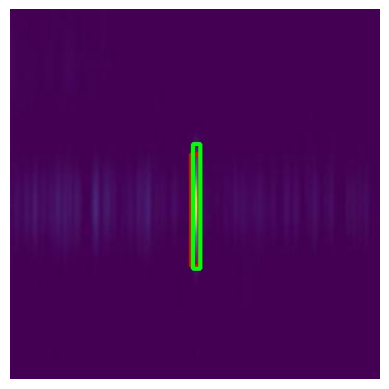

(448, 448, 3)
2046_stray_2b588137848f92a8a82a3395238dcfbd
[(145.0, 145.0, 162.0, 261.0, 0.28307750821113586), (211.0, 169.0, 228.0, 272.0, 0.13444173336029053), (150.30618965625763, 146.22222518920898, 166.35830771923065, 238.0, 1.0)]


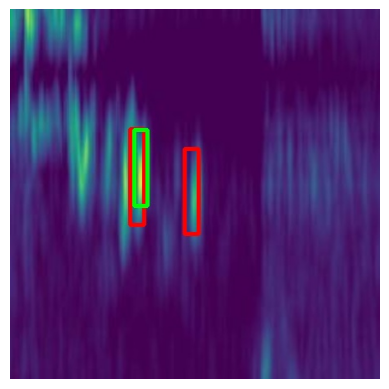

(448, 448, 3)
2049_stray_75fc41bf10d6baa26364f529fcb9eceb
[(88.0, 389.0, 105.0, 447.0, 0.189707413315773), (7.0, 110.0, 22.0, 201.0, 0.1866101324558258), (349.0, 0.0, 367.0, 51.0, 0.10027940571308136), (87.55700314044952, 393.55555295944214, 103.60912120342255, 447.9999966621399, 1.0)]


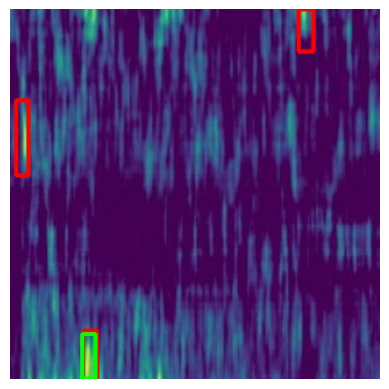

(448, 448, 3)
2058_stray_c843ffcdaeadde6ae23db5be3ff97c47
[(48.15634834766388, 284.6666588783264, 64.2084664106369, 349.9999899864197, 1.0)]


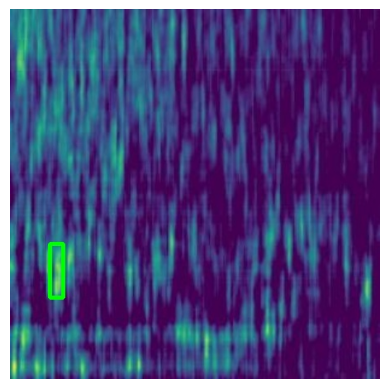

(448, 448, 3)
2072_target_3ec75f9edef344f488fba2dce5583e23
[(223.0, 176.0, 236.0, 299.0, 0.589005708694458), (221.81108182668686, 160.22222518920898, 234.94463258981705, 284.66667556762695, 1.0)]


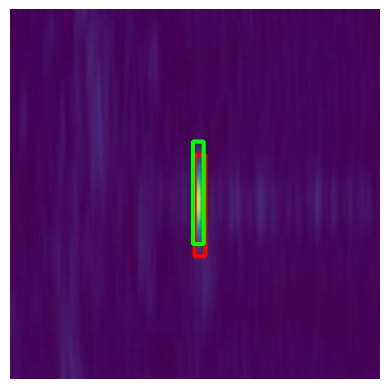

(448, 448, 3)
2076_stray_f13ceada8a31eea07546937cd4d106d3
[(182.41042745113373, 412.2222101688385, 204.29967844486237, 447.9999883174896, 1.0)]


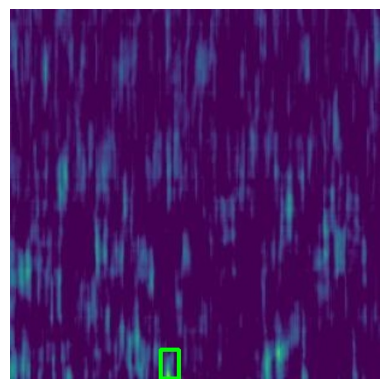

(448, 448, 3)
2079_target_8a5e762021c16bc393d0b46cf9893a16
[(223.0, 183.0, 236.0, 300.0, 0.5290303826332092), (220.35179609060287, 182.0000033378601, 233.48534685373306, 292.44444704055786, 1.0)]


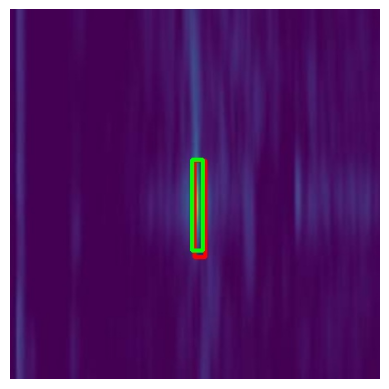

(448, 448, 3)
207_target_ef5a59b5b9f8d919fb7b500528aa36d3
[(206.0, 171.0, 218.0, 307.0, 0.5146069526672363), (205.75895208120346, 163.33333778381348, 218.89250284433365, 309.55556297302246, 1.0)]


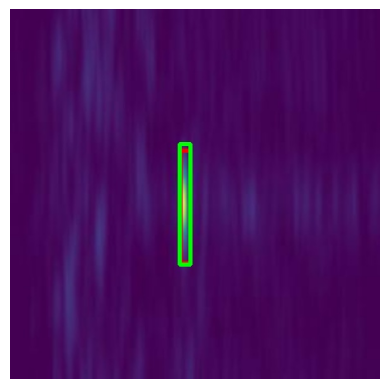

(448, 448, 3)
2107_stray_ec39ac941c18cac159fd4b9fdab16600
[(92.0, 167.0, 111.0, 279.0, 0.12025442719459534), (34.0, 41.0, 48.0, 132.0, 0.1191456988453865), (337.0944680571556, 141.55556297302246, 350.2280188202858, 233.33333778381348, 1.0)]


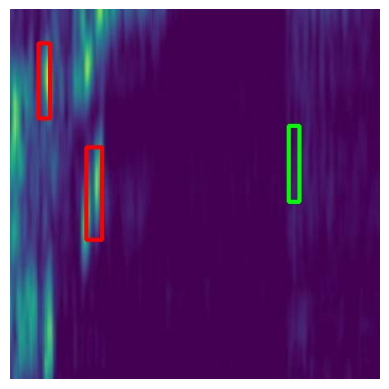

(448, 448, 3)
2114_target_7aa41e29c9d0ae9266ca57cb15daf9e2
[(226.0, 177.0, 239.00000000000003, 300.0, 0.5879308581352234), (221.81108182668686, 172.66666221618652, 234.94463258981705, 290.8888874053955, 1.0)]


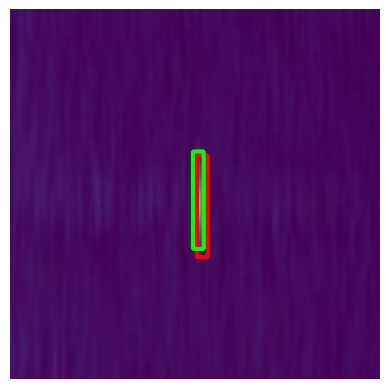

(448, 448, 3)
2126_stray_3c0446536ae0b61f966b22a0126330ce
[(290.0, 109.0, 309.0, 208.0, 0.38190460205078125), (80.26058572530746, 144.66666889190674, 93.39413648843765, 231.77778148651123, 1.0)]


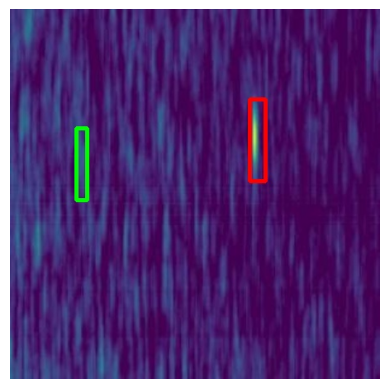

(448, 448, 3)
215_stray_5bd0b050975d4da060e0575c37451458
[(4.0, 191.0, 20.0, 301.0, 0.15462861955165863), (4.0, 46.0, 16.0, 148.0, 0.12328033149242401), (0.0, 200.66665887832642, 14.592833995819092, 293.9999899864197, 1.0)]


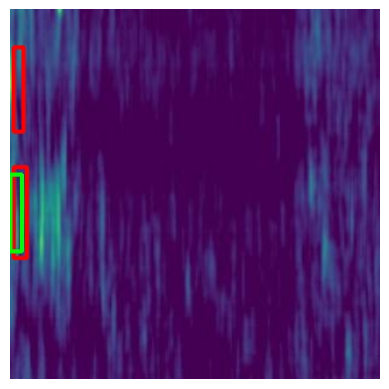

(448, 448, 3)
2174_stray_b63ff76d4a51b74f73f9a7b2a12f561e
[(288.0, 100.0, 300.0, 238.0, 0.2651293873786926), (305.0, 141.0, 319.0, 279.0, 0.17170077562332153), (287.4788331389427, 63.777774810791016, 300.6123839020729, 328.222225189209, 1.0)]


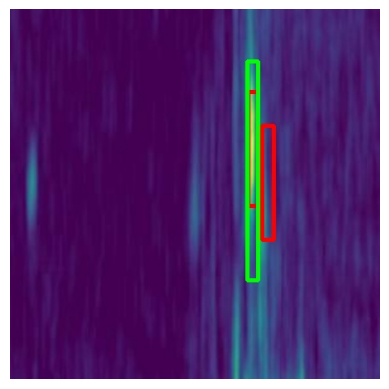

(448, 448, 3)
2182_stray_3380c308d71d9b7116b832b44134f60b
[(240.0, 386.0, 255.0, 447.0, 0.18793074786663055), (194.0, 102.0, 213.0, 183.0, 0.15776580572128296), (191.16612017154694, 93.33333778381348, 218.8925040960312, 169.55556297302246, 1.0)]


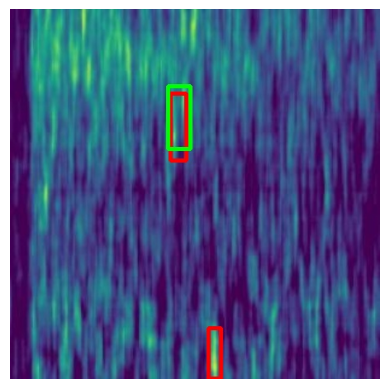

(448, 448, 3)
219_stray_a4e7642ce8c912a36925628a0816752b
[(339.0, 185.0, 355.0, 288.0, 0.23699599504470825), (361.0, 39.0, 379.0, 151.0, 0.17030546069145203), (341.4723131656647, 178.88889074325562, 356.06514716148376, 261.33333444595337, 1.0)]


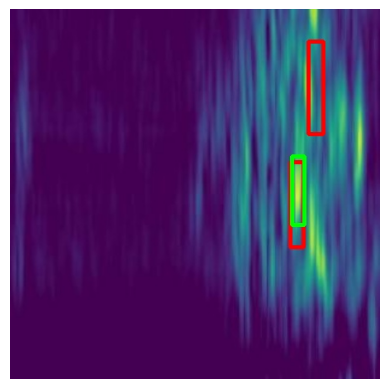

(448, 448, 3)
21_stray_95b27d97c044c59564adb4a4fcbecd9e
[(261.0, 1.0, 283.0, 101.0, 0.21936318278312683), (205.0, 167.0, 221.0, 278.0, 0.12437824159860611), (252.45603847503662, 0.0, 277.26385593414307, 71.55555629730225, 1.0)]


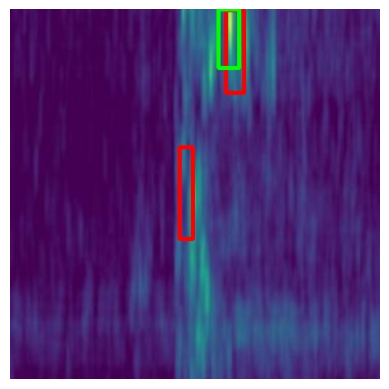

(448, 448, 3)
2222_stray_0c1249160539a387fa0add0cec608803
[(132.0, 204.0, 144.0, 256.0, 0.17162442207336426), (394.0, 194.0, 408.0, 264.0, 0.15188977122306824), (137.1726313829422, 160.22222518920898, 153.22474944591522, 258.222225189209, 1.0)]


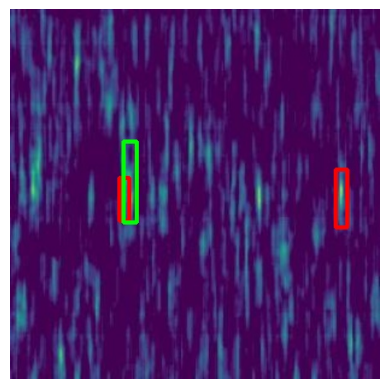

(448, 448, 3)
2226_target_b0153f85226856e0847baddecbb36331
[(221.0, 165.0, 232.00000000000003, 297.0, 0.5945442318916321), (218.892498254776, 152.44445037841797, 233.4853322505951, 304.88890075683594, 1.0)]


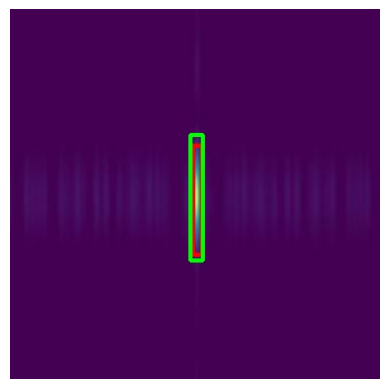

(448, 448, 3)
2242_target_0f59846bb2a64360a7c16108181f34a8
[(215.0, 180.0, 229.0, 281.0, 0.518034815788269), (217.4332246184349, 178.88890075683594, 230.5667753815651, 276.88890075683594, 1.0)]


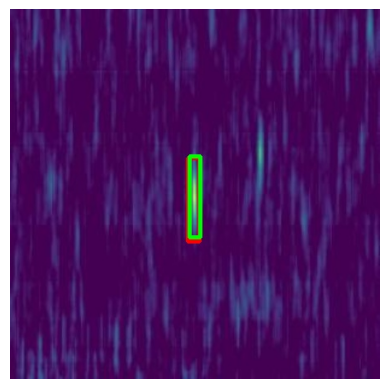

(448, 448, 3)
225_stray_f5599b13b119de3a095262e6b12f6750
[(221.0, 186.0, 239.00000000000003, 303.0, 0.34834611415863037), (98.0, 302.0, 118.0, 415.0, 0.18023282289505005), (215.97394347190857, 150.8888874053955, 234.9446280002594, 298.6666622161865, 1.0)]


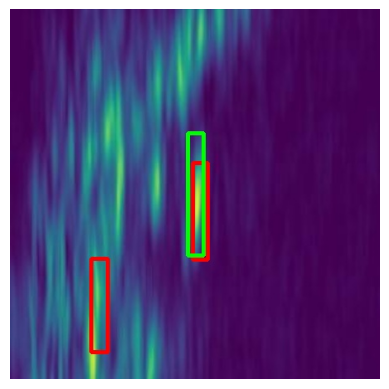

(448, 448, 3)
2260_target_0f2f8a24cde2577075d04cd361357f94
[(225.00000000000003, 169.0, 238.0, 290.0, 0.5991331338882446), (223.27036756277084, 171.1111125946045, 236.40391832590103, 290.8888874053955, 1.0)]


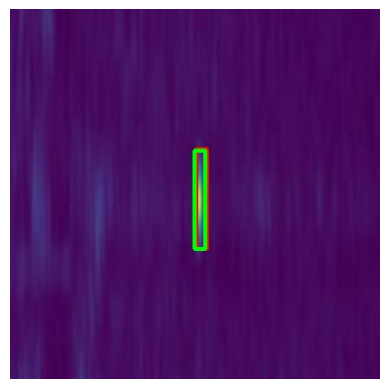

(448, 448, 3)
2262_target_e3a97a0f6c9e650f683cae6fb82b9157
[(229.0, 188.0, 243.99999999999997, 283.0, 0.4792998433113098), (221.81106972694397, 192.8888874053955, 236.40390372276306, 283.1111125946045, 1.0)]


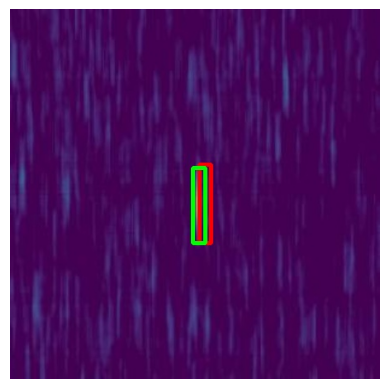

(448, 448, 3)
2263_target_efc8a53246f3344f8702211b389daf21
[(257.0, 0.0, 275.0, 74.0, 0.25754880905151367), (294.0, 346.0, 308.0, 438.0, 0.20486821234226227), (269.9674143195152, 0.0, 278.7231145501137, 76.22222518920898, 1.0)]


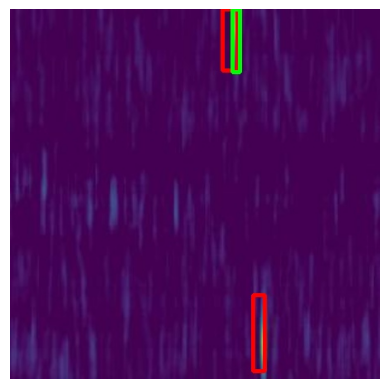

(448, 448, 3)
2267_target_4e1c1237e9ac1fc41f80ece6185cdb9d
[(229.0, 198.0, 241.0, 285.0, 0.4265606105327606), (10.0, 155.0, 26.0, 256.0, 0.1559692770242691), (223.2703533768654, 185.11112260818481, 234.94462007284164, 270.66667890548706, 1.0)]


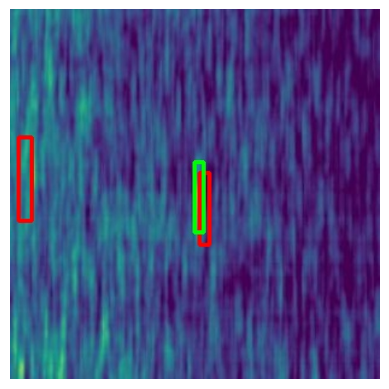

(448, 448, 3)
2274_stray_55dc22aeccce72803ab3fe70c9740e02
[(364.0, 225.00000000000003, 380.0, 345.0, 0.25279030203819275), (358.9837177991867, 250.44443368911743, 376.4951182603836, 343.7777647972107, 1.0)]


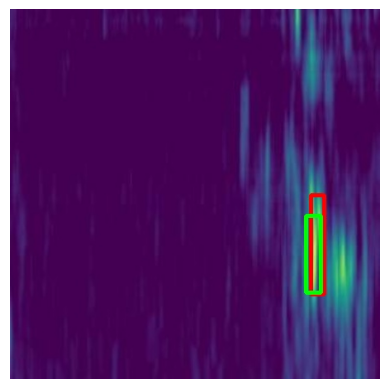

(448, 448, 3)
2278_target_53a0e8e16e7362c1395c3a92f04452a5
[(19.0, 300.0, 43.0, 412.0, 0.22156593203544617), (32.10423320531845, 265.9999933242798, 45.23778396844864, 409.1111059188843, 1.0)]


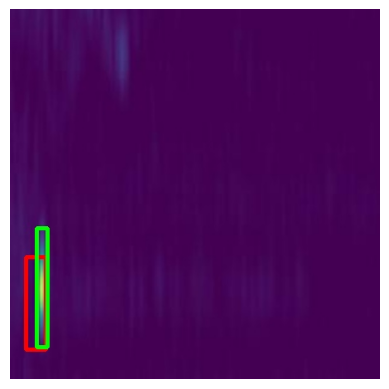

(448, 448, 3)
228_stray_e7d9523789eddd55c8f6d6e55abf1889
[(215.0, 189.0, 229.0, 324.0, 0.3187398910522461), (214.51465690135956, 185.11110925674438, 232.02605736255646, 292.44444036483765, 1.0)]


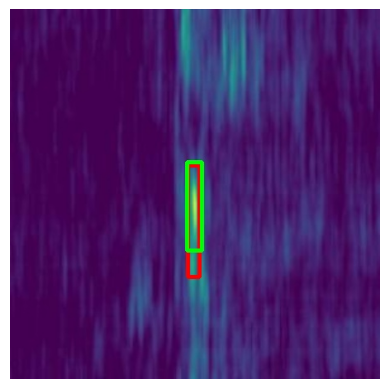

(448, 448, 3)
22_target_245513edeffb30e1a1f0683eddea739c
[(222.0, 176.0, 233.0, 281.0, 0.5505353808403015), (220.3517940044403, 175.77777814865112, 230.56677746772766, 286.2222218513489, 1.0)]


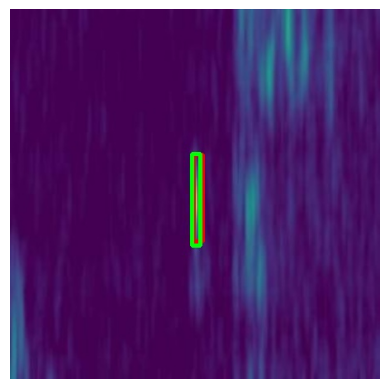

(448, 448, 3)
2312_target_dc54cb3e6cf2959a0eb97c582abd49b2
[(206.0, 179.0, 219.0, 282.0, 0.4615480899810791), (0.0, 300.0, 13.0, 410.0, 0.10987910628318787), (198.4625380039215, 181.99998998641968, 213.0553719997406, 270.6666588783264, 1.0)]


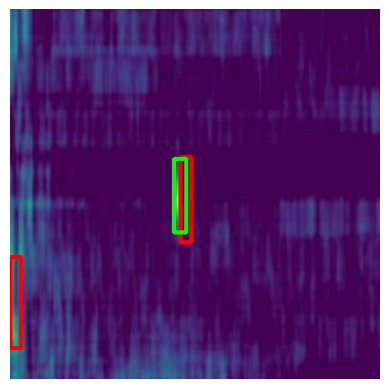

(448, 448, 3)
2329_target_893079bf7a45e2a49cfdfd449fb9b135
[(227.0, 156.0, 240.0, 290.0, 0.5507515668869019), (234.94462674856186, 150.88889408111572, 248.07817751169205, 287.77778148651123, 1.0)]


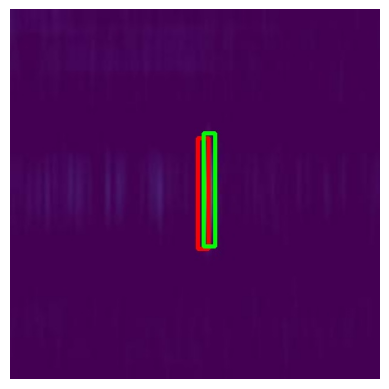

(448, 448, 3)
2348_stray_bce1aba9f361fb45f3ecf88b27c5d894
[(128.0, 0.0, 145.0, 60.99999999999999, 0.14179585874080658), (101.0, 0.0, 123.00000000000001, 70.0, 0.13763615489006042), (275.804566860199, 174.22221183776855, 312.28665018081665, 293.99998664855957, 1.0)]


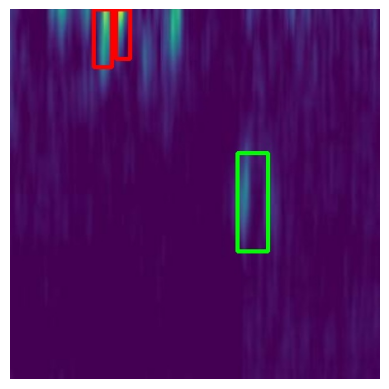

(448, 448, 3)
235_stray_29e9b77a64b1ccc3739c59c8952a996b
[(54.0, 348.0, 82.0, 446.0, 0.2551124393939972), (62.0, 156.0, 81.0, 282.0, 0.10820459574460983), (62.74918735027313, 169.55556964874268, 80.26058781147003, 300.2222318649292, 1.0)]


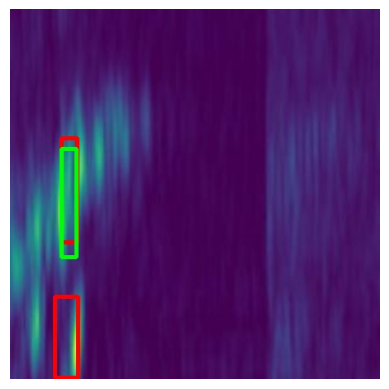

(448, 448, 3)
2369_stray_3844454d2bb129e23499437fbf594de0
[(411.0, 0.0, 431.0, 81.0, 0.16826477646827698), (391.0879455804825, 1.555556297302246, 418.81432950496674, 88.66666889190674, 1.0)]


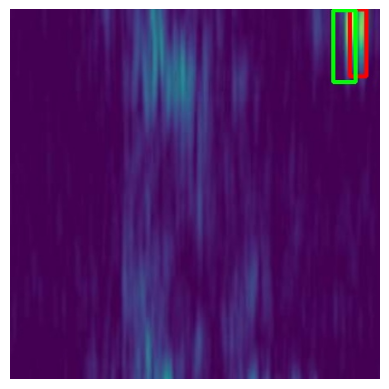

(448, 448, 3)
236_stray_ae6c75c54bd41ae1b90b7dbb52a411e4
[(353.0, 289.0, 371.0, 355.0, 0.15322895348072052), (220.0, 272.0, 236.0, 352.0, 0.14940984547138214), (240.78175550699234, 284.6666622161865, 252.4560222029686, 360.8888874053955, 1.0)]


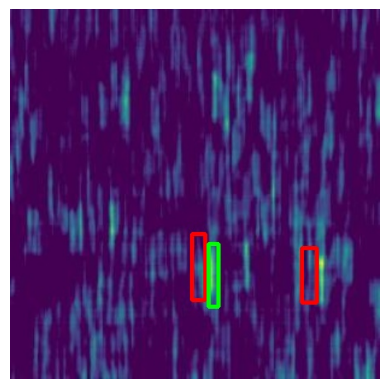

(448, 448, 3)
2370_stray_3be0d48ad12681a7dd665e995d090b75
[(159.0, 58.00000000000001, 177.0, 170.0, 0.1880652904510498), (107.0, 290.0, 129.0, 396.0, 0.17778313159942627), (186.0, 41.0, 205.0, 152.0, 0.11418262869119644), (130.0, 82.0, 148.0, 202.0, 0.10511249303817749), (116.74267530441284, 93.33332777023315, 137.17264223098755, 195.9999966621399, 1.0)]


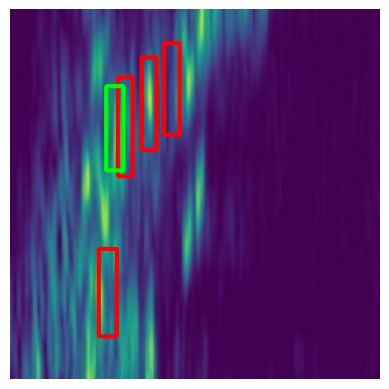

(448, 448, 3)
2389_stray_e249773ac16063ecb76340536d5436f2
[(210.0, 397.0, 224.0, 447.0, 0.16223610937595367), (280.18242156505585, 307.9999899864197, 297.69382202625275, 396.6666588783264, 1.0)]


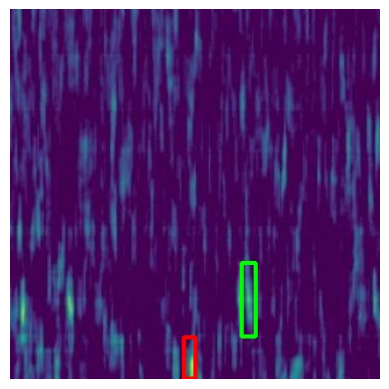

(448, 448, 3)
239_stray_7c1793a5f34f47ada858b5e74154f566
[(218.0, 197.0, 227.0, 273.0, 0.43473684787750244), (206.0, 286.0, 226.0, 389.0, 0.21450816094875336), (215.97394347190857, 189.77777814865112, 234.9446280002594, 286.2222218513489, 1.0)]


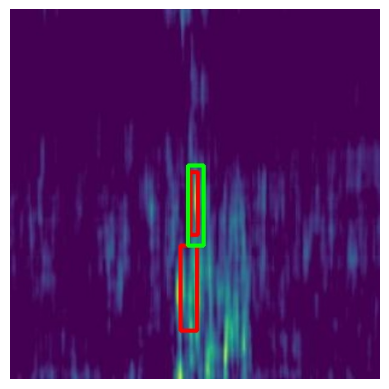

(448, 448, 3)
2404_target_453c92beb85690442adb222c23f1aa96
[(89.0, 146.0, 99.0, 219.0, 0.1707725077867508), (116.74267113208771, 169.55554962158203, 132.79478919506073, 225.55554962158203, 1.0)]


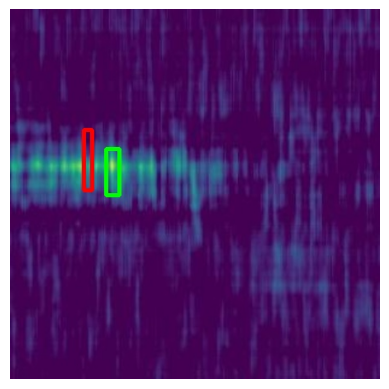

(448, 448, 3)
2416_target_761344fc4059b1d23793030913543c2d
[(226.0, 190.0, 240.0, 318.0, 0.48858898878097534), (233.48533642292023, 194.44444704055786, 240.78175342082977, 294.0000033378601, 1.0)]


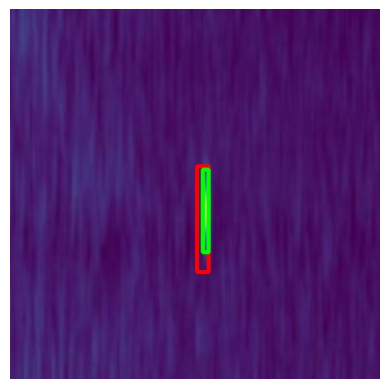

(448, 448, 3)
2425_stray_949d4e76b2129e69570321042c9134d7
[(159.0, 68.0, 178.0, 174.0, 0.25943872332572937), (132.0, 81.0, 147.0, 201.0, 0.17232702672481537), (94.0, 297.0, 116.00000000000001, 401.0, 0.17183710634708405), (182.0, 54.0, 201.0, 159.0, 0.14909842610359192), (217.43323421478271, 182.0, 242.24105167388916, 280.0, 1.0)]


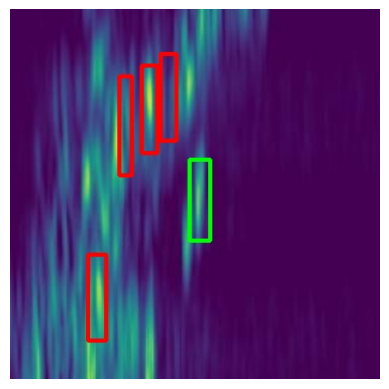

(448, 448, 3)
2430_stray_02acb37fd1d228bd74719e57dc7a914b
[(88.0, 76.0, 104.0, 173.0, 0.21508997678756714), (112.36482518911362, 87.11111259460449, 125.4983759522438, 177.33333778381348, 1.0)]


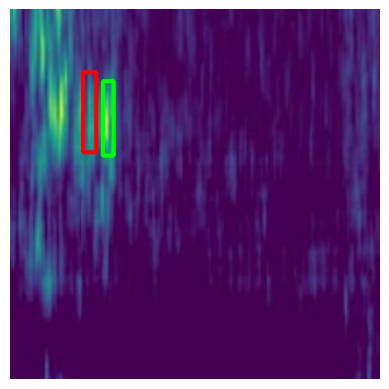

(448, 448, 3)
2471_stray_75d93bf1f1bc0254a67f7797e4168789
[(267.0, 205.0, 278.0, 296.0, 0.14669862389564514), (58.00000000000001, 205.0, 75.0, 265.0, 0.11693629622459412), (32.0, 187.0, 48.0, 270.0, 0.10114783048629761), (259.7524433732033, 210.00001335144043, 271.42671006917953, 287.77778816223145, 1.0)]


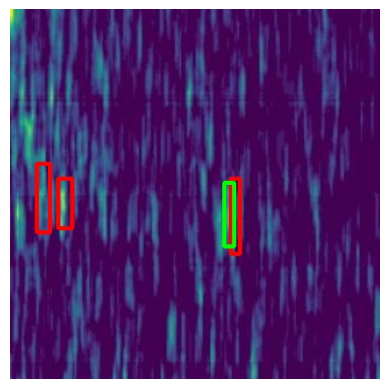

(448, 448, 3)
2482_target_b1458683d3bb62416f4c064e6f737822
[(225.00000000000003, 167.0, 238.0, 298.0, 0.5939189195632935), (223.27036547660828, 154.00001335144043, 233.48534893989563, 301.77778816223145, 1.0)]


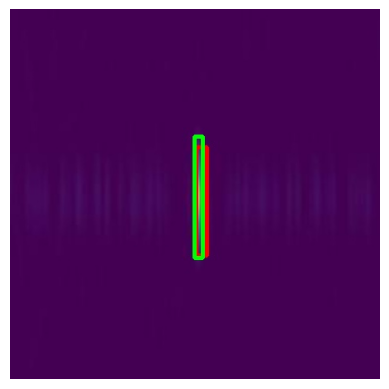

(448, 448, 3)
2484_target_d1c7bdc3c227c1db4ec438327bb8da5c
[(296.0, 318.0, 304.0, 432.0, 0.256094753742218), (113.0, 97.0, 126.0, 200.0, 0.13205371797084808), (140.09120285511017, 208.44445371627808, 156.1433209180832, 304.88889741897583, 1.0)]


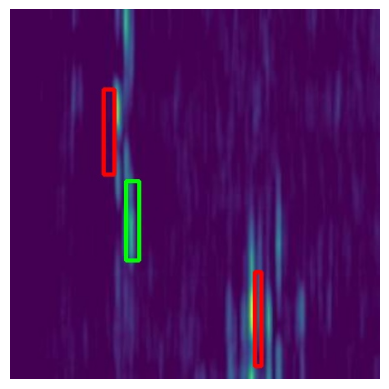

(448, 448, 3)
2487_stray_00be3f08a4caa125a067bdc05f276376
[(257.0, 173.0, 271.0, 316.0, 0.25721296668052673), (121.99999999999999, 354.0, 146.0, 447.0, 0.21584177017211914), (235.0, 37.0, 252.0, 155.0, 0.16525107622146606), (267.04886162281036, 200.66667556762695, 283.1009796857834, 326.66667556762695, 1.0)]


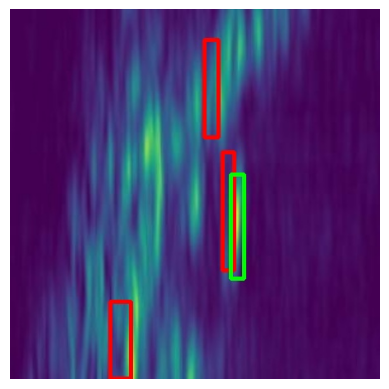

(448, 448, 3)
2491_target_3280c73306208403f53f7231ed02cfe8
[(325.0, 2.0, 345.0, 72.0, 0.12317502498626709), (214.51465272903442, 171.11110925674438, 243.7003207206726, 278.44444036483765, 1.0)]


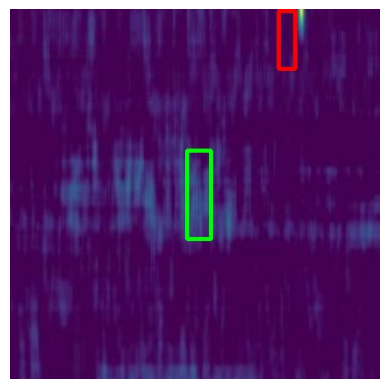

(448, 448, 3)
2506_target_be384153e697073091f126a289dd478e
[(225.00000000000003, 167.0, 239.00000000000003, 295.0, 0.592985987663269), (221.81108391284943, 163.33332443237305, 237.86320197582245, 290.8888740539551, 1.0)]


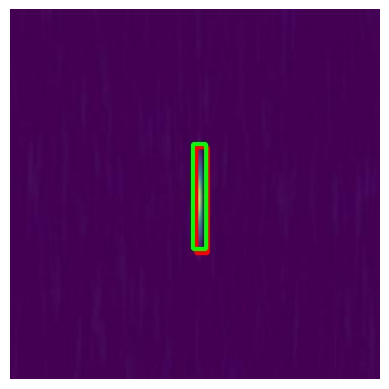

(448, 448, 3)
2513_target_641e352df4ce975f65fa743fdffa43eb
[(238.0, 156.0, 255.0, 296.0, 0.46736782789230347), (255.0, 163.0, 270.0, 297.0, 0.1333319991827011), (246.61889845132828, 160.22222518920898, 258.29316514730453, 301.777774810791, 1.0)]


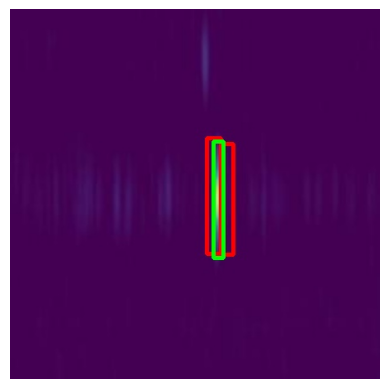

(448, 448, 3)
2530_target_721feae1d9fdcfaf0b3cee16b2087f11
[(217.0, 70.0, 227.0, 195.0, 0.34393200278282166), (220.35179609060287, 51.33333778381348, 233.48534685373306, 185.1111125946045, 1.0)]


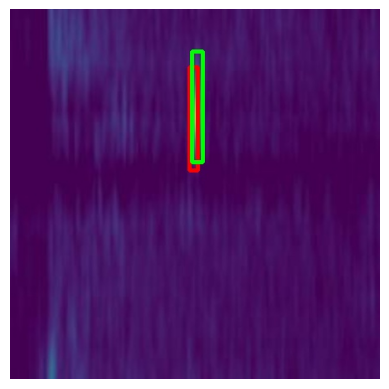

(448, 448, 3)
2544_target_c6ee6e0b5c9d4289a961a18e3faf2554
[(214.0, 148.0, 229.0, 287.0, 0.6377620100975037), (215.9739409685135, 141.55556297302246, 232.0260590314865, 289.3333377838135, 1.0)]


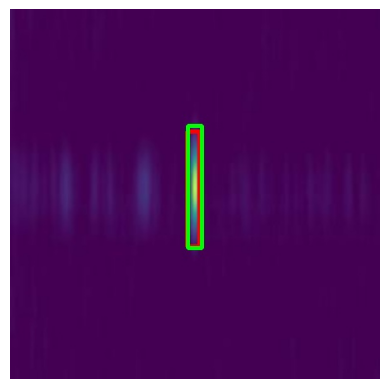

(448, 448, 3)
2545_target_54202bc3eb1b1d861412bfb6f4255898
[(224.0, 175.0, 236.0, 295.0, 0.5706150531768799), (218.89249616861343, 166.44445037841797, 230.5667628645897, 292.44445037841797, 1.0)]


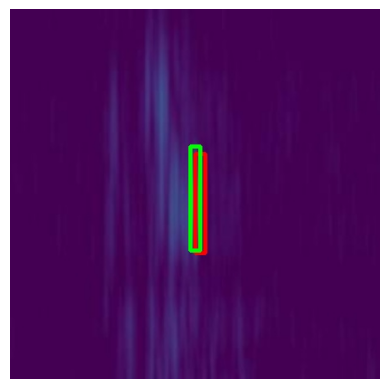

(448, 448, 3)
2557_target_745233a3e3a4ca7fd322496b796c3033
[(229.99999999999997, 162.0, 243.99999999999997, 295.0, 0.5750519037246704), (232.0260677933693, 155.55554294586182, 243.70033448934555, 298.6666555404663, 1.0)]


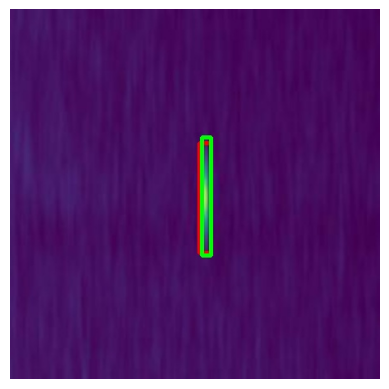

(448, 448, 3)
2562_stray_0bc053d49c425e4918727aa481e92e91
[(0.0, 176.0, 16.0, 268.0, 0.19998063147068024), (0.0, 157.11110925674438, 21.889250993728638, 250.44444036483765, 1.0)]


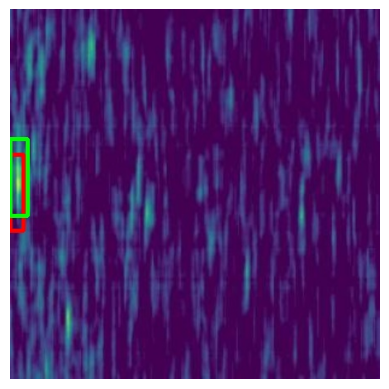

(448, 448, 3)
257_stray_5872119fdb767f741816bdcc18242c3f
[(138.0, 147.0, 155.0, 255.0, 0.22692906856536865), (80.26058614253998, 105.77777814865112, 102.14983713626862, 216.22222185134888, 1.0)]


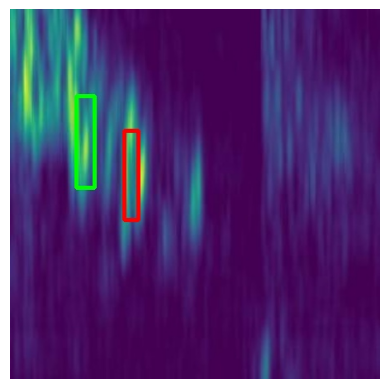

(448, 448, 3)
2586_target_18d1691e2483ed9a30e69360e69678b4
[(219.0, 168.0, 232.00000000000003, 297.0, 0.5864886045455933), (220.3517940044403, 169.55555629730225, 230.56677746772766, 290.8888940811157, 1.0)]


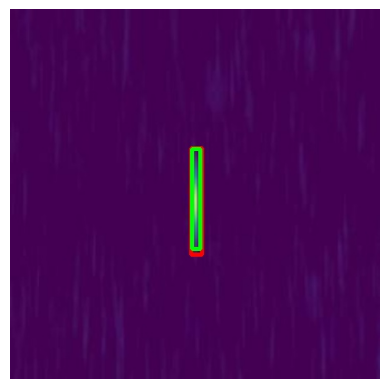

(448, 448, 3)
2589_stray_c9adff61511a6557b920a13f0766865f
[(86.0, 105.0, 107.0, 168.0, 0.2846314013004303), (100.69055640697479, 85.55554962158203, 118.20195686817169, 175.77777481079102, 1.0)]


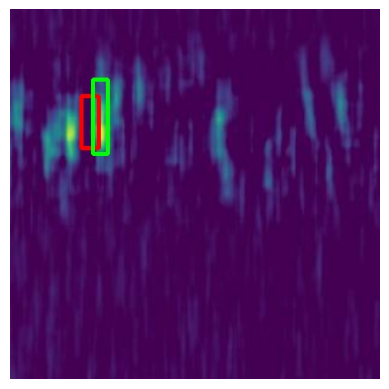

(448, 448, 3)
25_target_ac751186408b79067dd4442cedc5bfb7
[(128.0, 80.0, 137.0, 152.0, 0.33561021089553833), (138.0, 82.0, 154.0, 175.0, 0.1153457760810852), (144.46905797719955, 82.44444370269775, 157.60260874032974, 141.55555629730225, 1.0)]


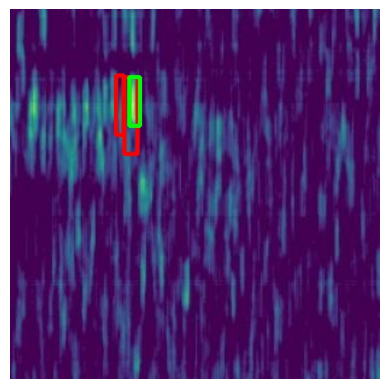

(448, 448, 3)
2610_stray_3c1f6a0af940dabb60f6a189e59f6bb9
[(0.0, 53.0, 14.0, 158.0, 0.10362298786640167), (0.0, 62.22222852706909, 35.0228009223938, 172.66667222976685, 1.0)]


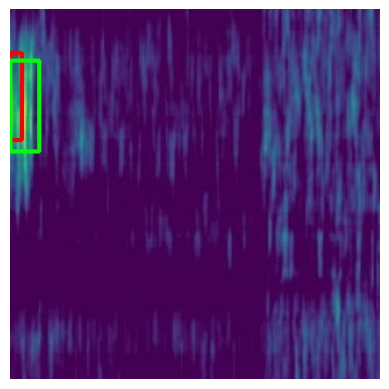

(448, 448, 3)
2622_target_f130686066dbfb03906df38413a2d48d
[(274.0, 345.0, 284.0, 445.0, 0.2346581518650055), (226.0, 168.0, 236.99999999999997, 282.0, 0.17927850782871246), (240.78175550699234, 171.11109924316406, 252.4560222029686, 295.55554962158203, 1.0)]


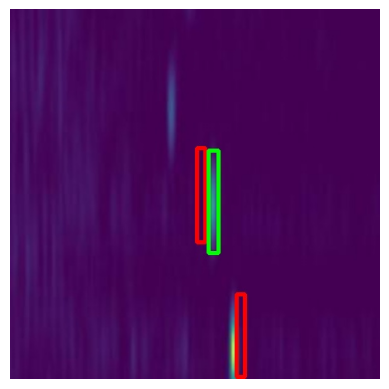

(448, 448, 3)
2623_target_ea03fc457ef461e7c4698964ab8c6a3a
[(225.00000000000003, 171.0, 238.0, 296.0, 0.5827571153640747), (221.81108182668686, 166.44445705413818, 234.94463258981705, 303.3333444595337, 1.0)]


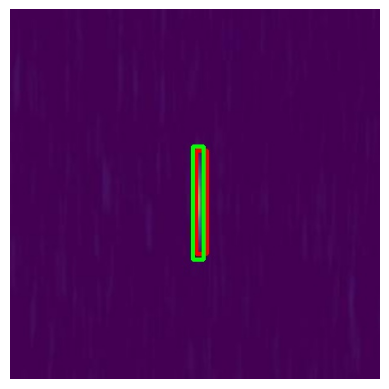

(448, 448, 3)
2626_target_0709beecf3c239146d2f6e7d1c5e52f2
[(235.0, 158.0, 247.0, 293.0, 0.4823187589645386), (240.78177177906036, 161.77778816223145, 256.8338898420334, 309.55556297302246, 1.0)]


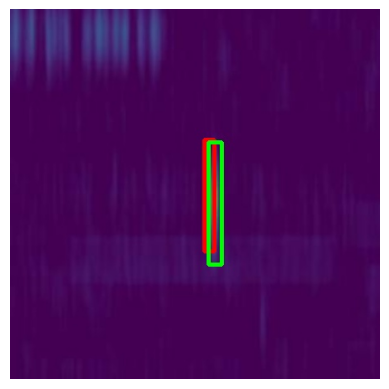

(448, 448, 3)
262_stray_48db8d2ff7a6a5aa1104bdfe27e0d3cf
[(213.0, 379.0, 236.99999999999997, 447.0, 0.1822885274887085), (207.21824741363525, 371.77778816223145, 232.0260648727417, 448.00001335144043, 1.0)]


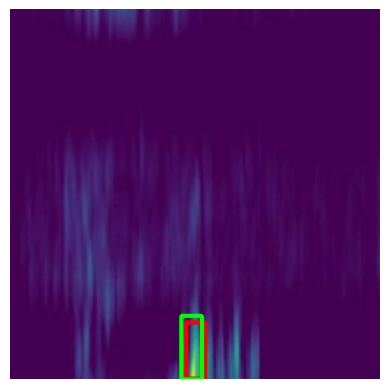

(448, 448, 3)
2632_target_b52f14e783fc42a0a7a058a6e334fe80
[(220.0, 172.0, 233.0, 284.0, 0.5839197635650635), (220.3517940044403, 168.0, 230.56677746772766, 294.0, 1.0)]


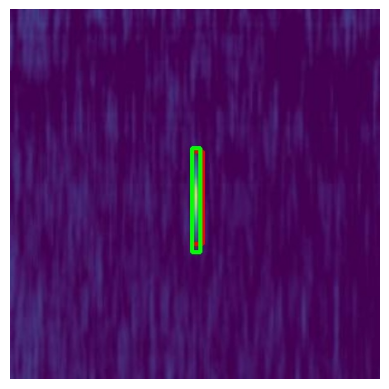

(448, 448, 3)
2646_stray_3b7d41a6af8843b587486207cc3f72f0
[(91.93485283851624, 119.77777814865112, 106.52768683433533, 222.44444704055786, 1.0)]


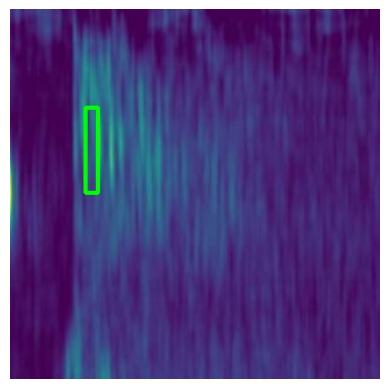

(448, 448, 3)
2648_target_76e52c9671d92be48c2456d18e10064e
[(76.0, 45.0, 90.0, 148.0, 0.2881302833557129), (227.0, 273.0, 246.00000000000003, 375.0, 0.20305104553699493), (233.48535060882568, 279.9999966621399, 258.29316806793213, 379.55555295944214, 1.0)]


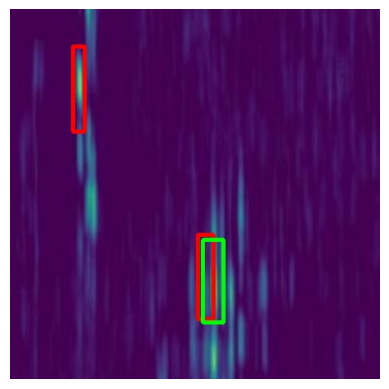

(448, 448, 3)
265_stray_0e1f054d32f5d2a11ba1ccd2d4837170
[(329.0, 177.0, 348.0, 273.0, 0.1823849081993103), (363.0, 39.0, 380.0, 155.0, 0.16760008037090302), (410.0, 372.0, 430.0, 447.0, 0.13411417603492737), (360.0, 378.0, 379.0, 447.0, 0.12817488610744476), (414.43648064136505, 98.0, 430.4885987043381, 236.44445037841797, 1.0)]


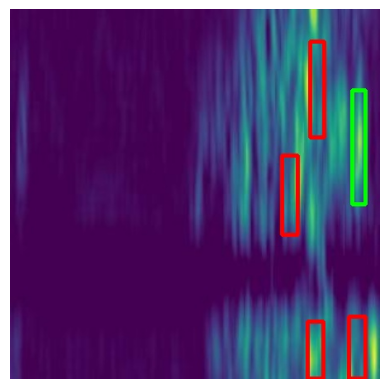

(448, 448, 3)
2662_target_1bb83bbd3c5405113ce2b4d71622095e
[(220.0, 167.0, 232.00000000000003, 294.0, 0.6198698878288269), (220.3517940044403, 160.22221851348877, 230.56677746772766, 289.33333110809326, 1.0)]


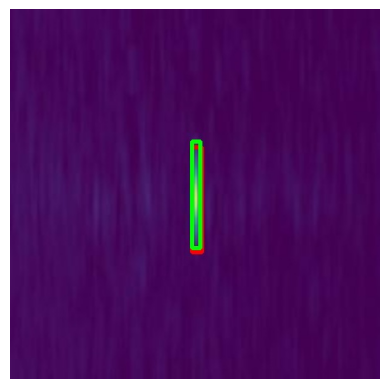

(448, 448, 3)
2674_target_9cbbb8d415c3cfe8709e72daccb59631
[(201.0, 174.0, 215.0, 284.0, 0.33351626992225647), (354.0, 16.0, 369.0, 119.0, 0.2507123351097107), (350.0, 4.0, 355.0, 121.0, 0.20388443768024445), (350.2280129790306, 0.0, 363.3615637421608, 118.22222518920898, 1.0)]


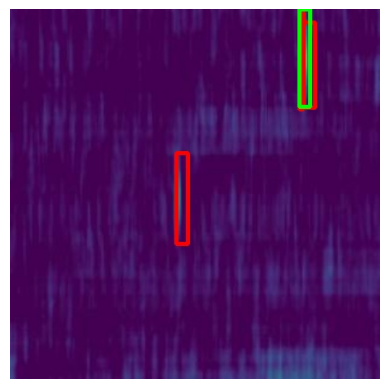

(448, 448, 3)
2685_stray_8e107d1be675a17861c99fa95ae2c7c6
[(157.0, 323.0, 175.0, 382.0, 0.11838594824075699), (148.84690308570862, 335.9999908208847, 179.49185347557068, 354.6666580438614, 1.0)]


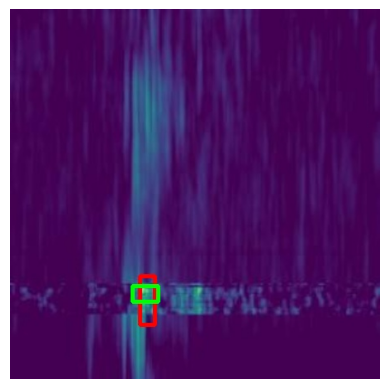

(448, 448, 3)
2689_stray_f297d91f834e19c5383a41a37bb9dd2a
[(7.0, 287.0, 18.0, 408.0, 0.13734318315982819), (0.0, 0.0, 11.674266695976257, 101.11111259460449, 1.0)]


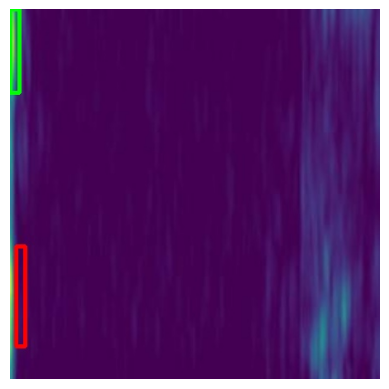

(448, 448, 3)
2710_target_09554c04d6dbb23fa6fcf9c82735d258
[(220.0, 160.0, 232.00000000000003, 294.0, 0.6108482480049133), (217.4332246184349, 155.55554962158203, 230.5667753815651, 297.11109924316406, 1.0)]


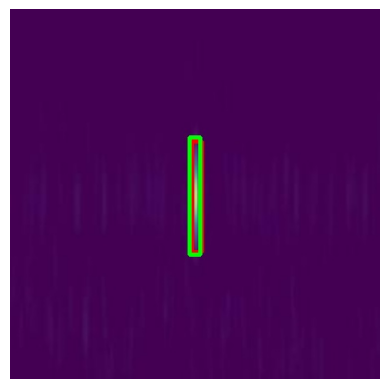

(448, 448, 3)
2712_stray_9b2ef19e00caab8d28af5464c83e89ed
[(258.0, 324.0, 265.0, 413.0, 0.17670901119709015), (164.0, 219.0, 179.0, 292.0, 0.16756951808929443), (348.0, 53.0, 360.0, 121.0, 0.10581037402153015), (164.8990203142166, 222.44443368911743, 180.95113837718964, 287.7777647972107, 1.0)]


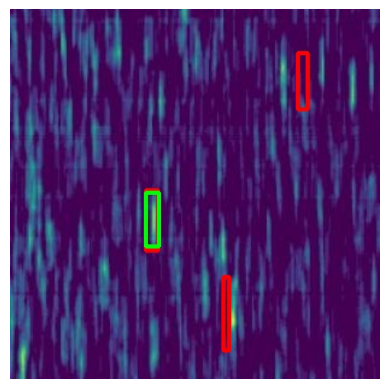

(448, 448, 3)
2738_target_58fb116bdba8d3aea0c8634971b7726c
[(225.00000000000003, 174.0, 238.0, 297.0, 0.5739402770996094), (224.7296366095543, 172.66666221618652, 233.48533684015274, 290.8888874053955, 1.0)]


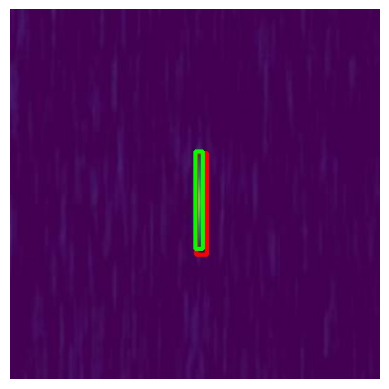

(448, 448, 3)
2764_target_e1583526e68e05f72bd67d620c0881ad
[(236.99999999999997, 158.0, 250.0, 299.0, 0.470458447933197), (243.7003144621849, 164.88889408111572, 256.8338652253151, 309.55555629730225, 1.0)]


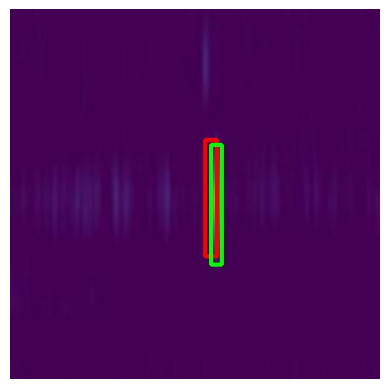

(448, 448, 3)
2765_target_18b4c78fa88c0e0d03bbef30baf27fef
[(239.00000000000003, 166.0, 254.0, 283.0, 0.4775621294975281), (237.86319822072983, 157.1111192703247, 250.99674898386002, 287.77778148651123, 1.0)]


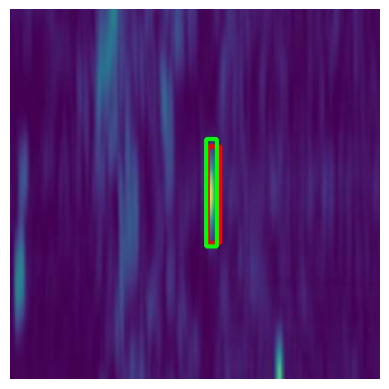

(448, 448, 3)
2777_target_08b382b2b5a9204ac561a5704d39afa3
[(347.0, 6.0, 368.0, 108.0, 0.2508043050765991), (364.82083904743195, 0.0, 372.1172560453415, 99.55555629730225, 1.0)]


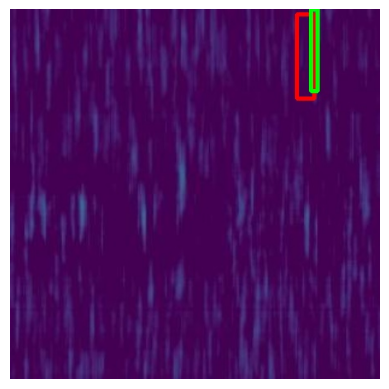

(448, 448, 3)
2784_stray_8e39090c81c4be041fee35bd6d175477
[(16.0, 52.0, 32.0, 146.0, 0.1790676712989807), (84.63843333721161, 136.88889408111572, 102.14983379840851, 210.00000667572021, 1.0)]


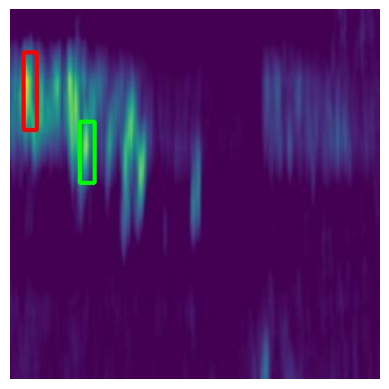

(448, 448, 3)
2798_stray_9041e906367a82747f228187056d1a63
[(247.0, 211.0, 257.0, 285.0, 0.21909809112548828), (253.91529750823975, 213.11110591888428, 278.7231149673462, 265.9999933242798, 1.0)]


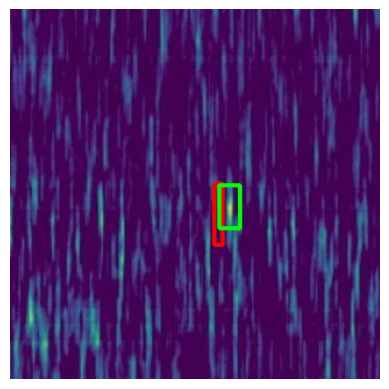

(448, 448, 3)
281_stray_7e0a10cd61546119751e134cf624c67a
[(196.0, 162.0, 218.0, 215.0, 0.12728913128376007), (26.0, 126.0, 47.0, 195.0, 0.12441204488277435), (79.0, 136.0, 110.0, 203.0, 0.1030706837773323), (205.7589566707611, 154.0000033378601, 224.72964119911194, 222.44444704055786, 1.0)]


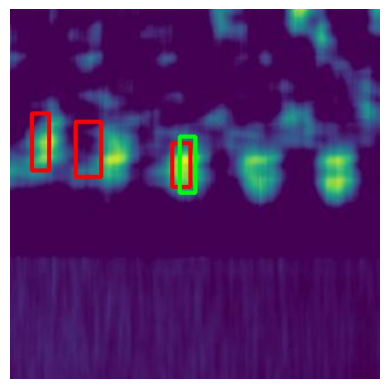

(448, 448, 3)
291_stray_20610c58416adab803208fbd9fac0845
[(196.0, 28.0, 215.0, 92.0, 0.13425393402576447), (23.0, 0.0, 39.0, 64.0, 0.10695411264896393), (65.66775047779083, 336.0000100135803, 81.71986854076385, 429.3333411216736, 1.0)]


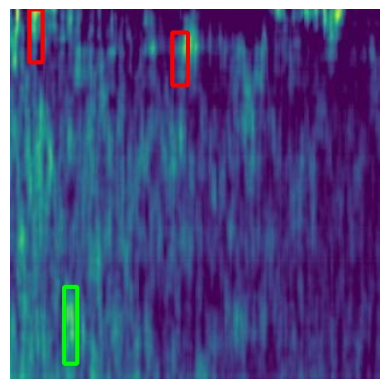

(448, 448, 3)
292_target_3d0c33b481a77f0d892aa20f192b548c
[(225.00000000000003, 163.0, 238.0, 295.0, 0.5998925566673279), (223.27036547660828, 152.44445037841797, 233.48534893989563, 294.0, 1.0)]


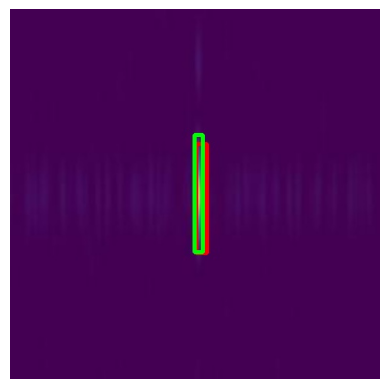

(448, 448, 3)
311_target_8c6b92fe7dffc5ceed79c1de0f44f6e2
[(212.0, 155.0, 224.0, 287.0, 0.5708364844322205), (210.1368084549904, 147.77778148651123, 221.81107515096664, 292.44444370269775, 1.0)]


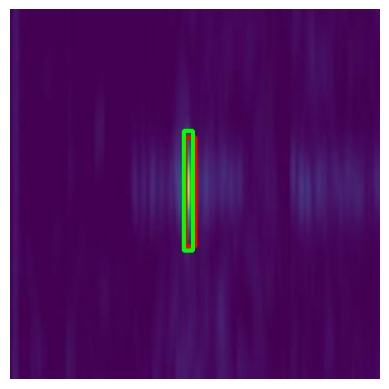

(448, 448, 3)
313_target_7a609ebf441ee0ca132db0b243f53204
[(225.00000000000003, 165.0, 238.0, 289.0, 0.5841177105903625), (224.72964870929718, 175.77778816223145, 232.02606570720673, 280.00001335144043, 1.0)]


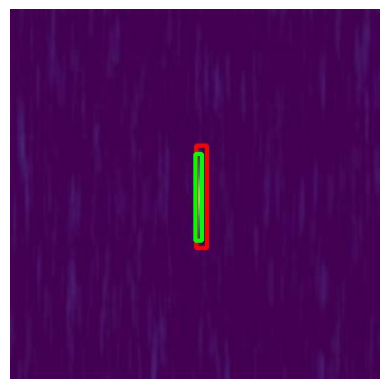

(448, 448, 3)
315_target_9214a07298889d2cea4736c79ae172ad
[(222.0, 173.0, 235.0, 288.0, 0.5762520432472229), (220.35177940130234, 174.22221183776855, 229.1074796319008, 293.99998664855957, 1.0)]


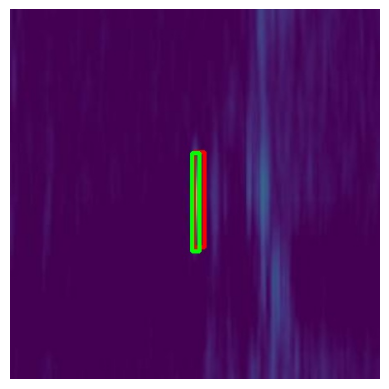

(448, 448, 3)
32_target_0533f76fe68fd088b02ebb4c531d5f82
[(225.00000000000003, 181.0, 239.00000000000003, 281.0, 0.5290804505348206), (221.8110676407814, 168.0, 233.48533433675766, 294.0, 1.0)]


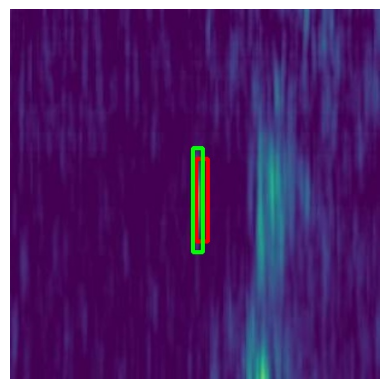

(448, 448, 3)
339_stray_629c7ae0cac2940dad6a4635d66a45c7
[(98.0, 3.0, 116.00000000000001, 67.0, 0.18792133033275604), (393.0, 375.0, 409.0, 439.0, 0.13040903210639954), (109.0, 369.0, 127.0, 433.0, 0.11613750457763672), (205.758953332901, 185.11110925674438, 220.3517873287201, 264.44444036483765, 1.0)]


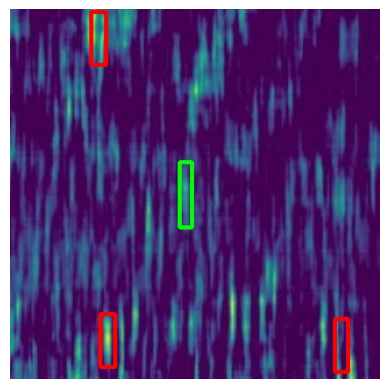

(448, 448, 3)
340_stray_635b2a72419f9667673c4b794b54305a
[(2.0, 229.99999999999997, 18.0, 337.0, 0.17729732394218445), (0.0, 211.55555629730225, 20.429966926574707, 306.44444370269775, 1.0)]


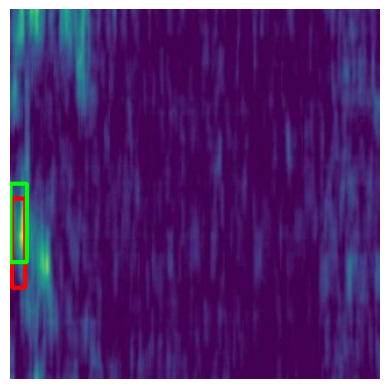

(448, 448, 3)
343_stray_e407d50ce2e64ee1fb31aff54a224bed
[(0.0, 214.0, 11.0, 351.0, 0.1560191661119461), (0.0, 143.1111125946045, 18.97068452835083, 256.6666622161865, 1.0)]


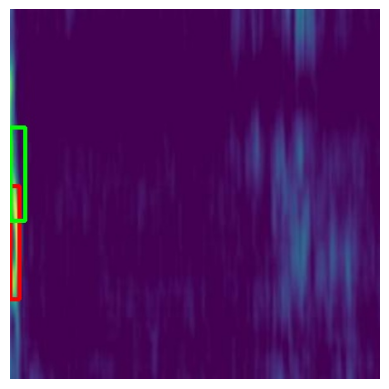

(448, 448, 3)
344_target_c3342f196f8be4bc1baa42257265ff2f
[(217.0, 168.0, 231.0, 296.0, 0.5940750241279602), (217.43322670459747, 160.22221183776855, 233.4853447675705, 293.99998664855957, 1.0)]


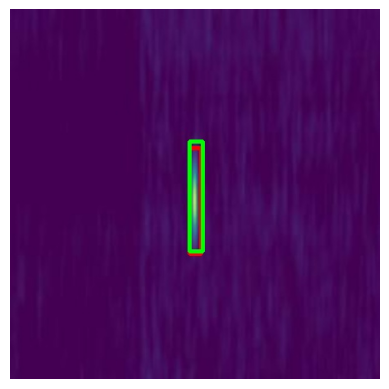

(448, 448, 3)
363_target_c789ecbfc2e39d18b5565b0a5e79dcd1
[(236.99999999999997, 156.0, 250.0, 293.0, 0.4928840100765228), (240.78177177906036, 163.3333444595337, 256.8338898420334, 294.0000066757202, 1.0)]


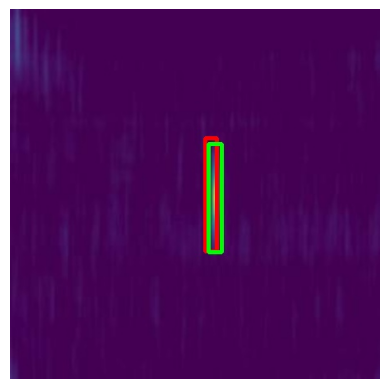

(448, 448, 3)
365_target_f65cdcd39ad86cd39c132162f78c5eaa
[(231.0, 180.0, 247.0, 301.0, 0.4800352156162262), (239.3224839568138, 191.33332777023315, 252.456034719944, 287.7777714729309, 1.0)]


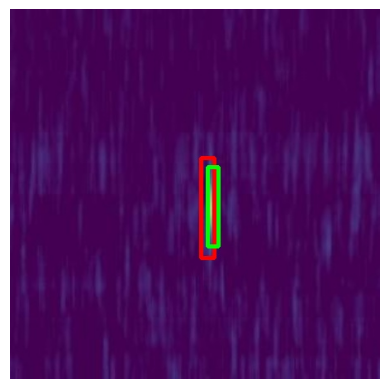

(448, 448, 3)
370_target_72ec076ac1aeec1a6aca91212b2211e6
[(226.0, 190.0, 239.00000000000003, 284.0, 0.45088446140289307), (224.72965121269226, 180.44443368911743, 234.94463467597961, 287.7777647972107, 1.0)]


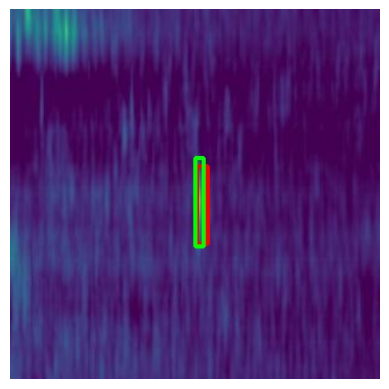

(448, 448, 3)
375_target_7669c62a6ac65aab63a10923479aedf8
[(223.0, 148.0, 236.99999999999997, 271.0, 0.5198890566825867), (64.0, 140.0, 85.0, 266.0, 0.3277697265148163), (65.6677496433258, 113.55555629730225, 80.2605836391449, 300.22221851348877, 1.0)]


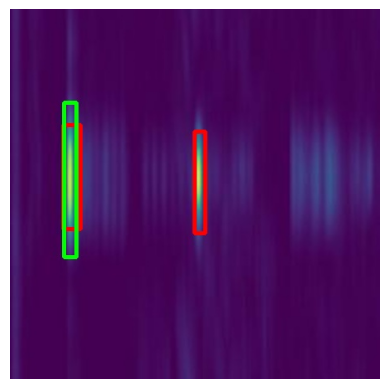

(448, 448, 3)
381_target_c7b713e0164199b5c6cdbb5be2298771
[(238.0, 182.0, 255.0, 296.0, 0.4462164640426636), (242.2410533428192, 183.55556964874268, 252.45603680610657, 300.2222318649292, 1.0)]


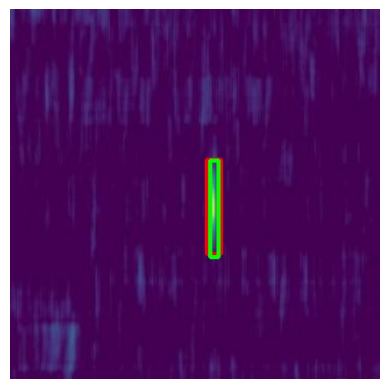

(448, 448, 3)
382_stray_b69bd118a8cb33129db79d0f898568b1
[(68.0, 44.0, 80.0, 182.0, 0.33356401324272156), (78.0, 64.0, 95.0, 195.0, 0.25779297947883606), (64.20846724510193, 4.666668891906738, 83.17915177345276, 219.33333110809326, 1.0)]


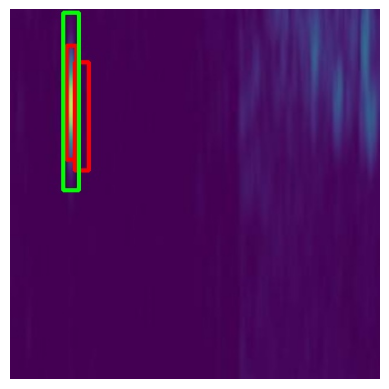

(448, 448, 3)
392_stray_f75ecde26755770b380427f17a3733b1
[(357.0, 404.0, 374.0, 447.0, 0.14738386869430542), (156.1433275938034, 125.99999332427979, 182.41042912006378, 185.11110591888428, 1.0)]


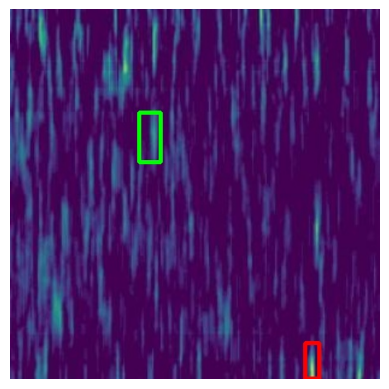

(448, 448, 3)
394_stray_f68ed2cd8928f693169683c8c47c5a53
[(59.83061879873276, 186.66666889190674, 72.96416956186295, 253.55555629730225, 1.0)]


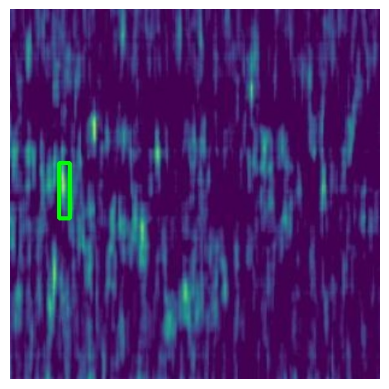

(448, 448, 3)
402_target_00b97ddfefeb3f852fcd7962959b9d67
[(240.0, 161.0, 252.0, 296.0, 0.46565762162208557), (243.7003144621849, 160.22222518920898, 256.8338652253151, 298.66667556762695, 1.0)]


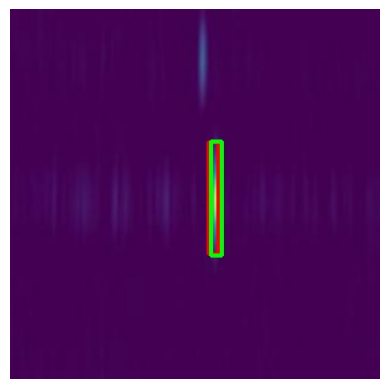

(448, 448, 3)
42_target_fcfa066e80749aa7cf3df62373743a47
[(218.0, 178.0, 233.0, 250.99999999999997, 0.2031022310256958), (224.72965329885483, 164.88889074325562, 237.86320406198502, 253.55555963516235, 1.0)]


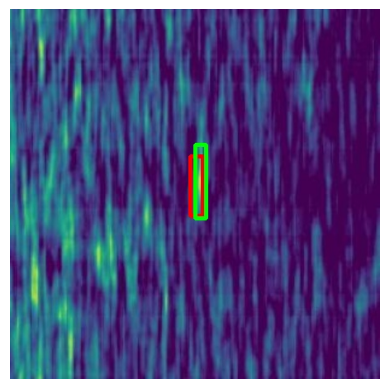

(448, 448, 3)
430_target_0afba182a43a83f2558c7e24ce6264b9
[(32.0, 192.0, 47.0, 254.0, 0.1711868941783905), (49.61563324928284, 194.44444036483765, 64.20846724510193, 255.11110925674438, 1.0)]


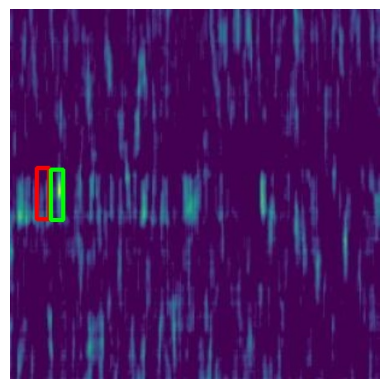

(448, 448, 3)
432_stray_87140fc9fceb525748f195b8fb3ee078
[(125.0, 199.0, 146.0, 267.0, 0.2873370945453644), (141.55048859119415, 191.33333778381348, 157.60260665416718, 247.33333778381348, 1.0)]


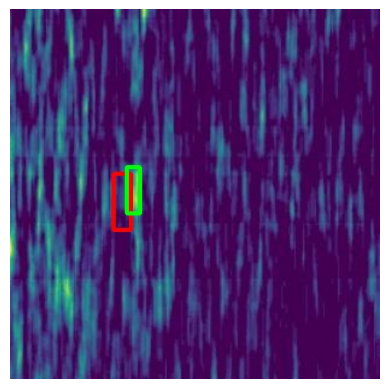

(448, 448, 3)
438_target_031aa664890e02eb85cc47b4eaca1d8f
[(231.0, 189.0, 243.99999999999997, 291.0, 0.48610538244247437), (221.8110797405243, 177.33332443237305, 232.02606320381165, 304.8888740539551, 1.0)]


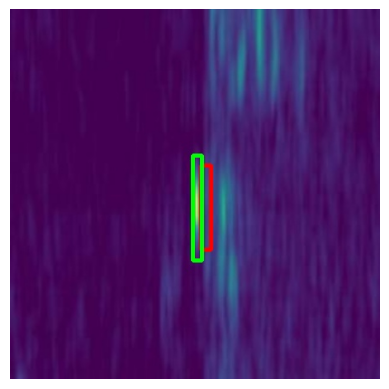

(448, 448, 3)
450_target_72fb88ccad53a1f9c8f2fae7287cda0e
[(227.0, 153.0, 238.0, 280.0, 0.5698667168617249), (230.56676745414734, 147.77777481079102, 240.7817509174347, 280.0, 1.0)]


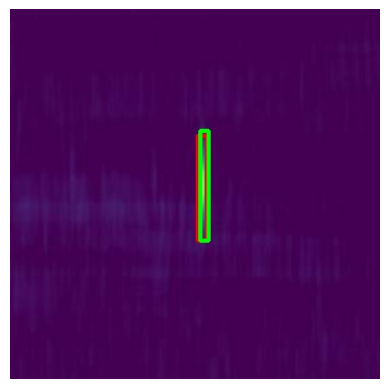

(448, 448, 3)
459_target_eb85c0fcbe44a829e4f15e49775dc218
[(220.0, 150.0, 234.0, 280.0, 0.5768448114395142), (224.72965121269226, 146.22222518920898, 234.94463467597961, 284.66667556762695, 1.0)]


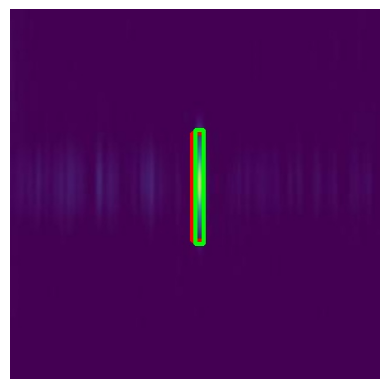

(448, 448, 3)
467_target_95b38d388231acb72a40737f70b8e079
[(219.0, 171.0, 231.0, 295.0, 0.5811597108840942), (217.43322670459747, 169.55555629730225, 233.4853447675705, 292.44444370269775, 1.0)]


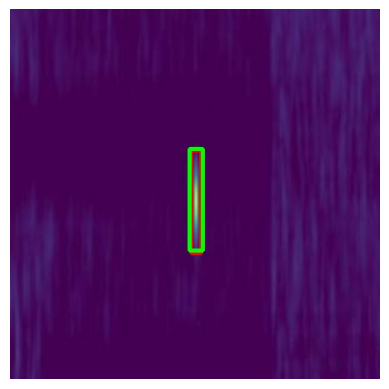

(448, 448, 3)
471_stray_45ee45ae80753c0ab539c8110f98ade2
[(350.0, 36.0, 372.0, 148.0, 0.22447824478149414), (338.0, 169.0, 356.0, 274.0, 0.18357613682746887), (354.0, 212.0, 371.0, 321.0, 0.12649156153202057), (375.0358291864395, 276.88889741897583, 402.76221311092377, 376.4444537162781, 1.0)]


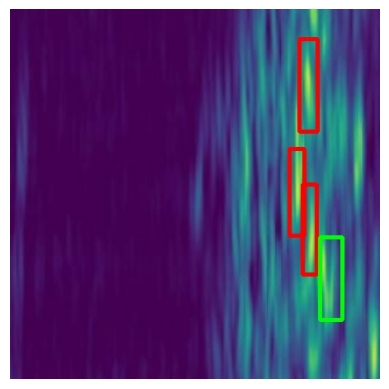

(448, 448, 3)
484_stray_aa605d71441e45d301c061268df22b8d
[(173.65472888946533, 241.1111159324646, 198.46254634857178, 301.77778482437134, 1.0)]


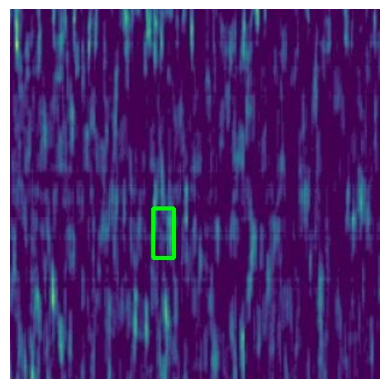

(448, 448, 3)
486_target_047ef9400fa0f90e10ed0e82e7e08214
[(220.0, 167.0, 232.00000000000003, 299.0, 0.6093960404396057), (215.97394347190857, 150.88889408111572, 234.9446280002594, 309.55555629730225, 1.0)]


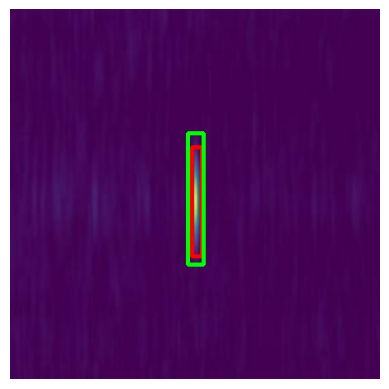

(448, 448, 3)
492_target_93b30803b758489d65f0335f1be4915a
[(8.0, 291.0, 28.0, 406.0, 0.19101524353027344), (0.0, 292.44445037841797, 10.214983463287354, 404.44445037841797, 1.0)]


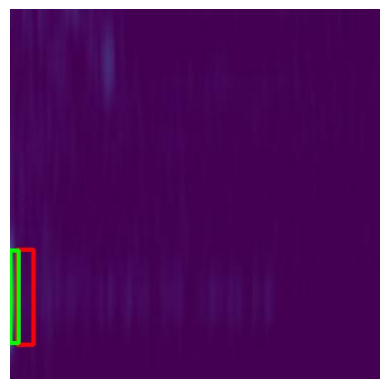

(448, 448, 3)
496_stray_fa2492edb0072d17e19e1bd7ea4fbfdb
[(391.0, 360.0, 410.0, 430.0, 0.14081750810146332), (210.1368084549904, 191.33332777023315, 221.81107515096664, 259.7777714729309, 1.0)]


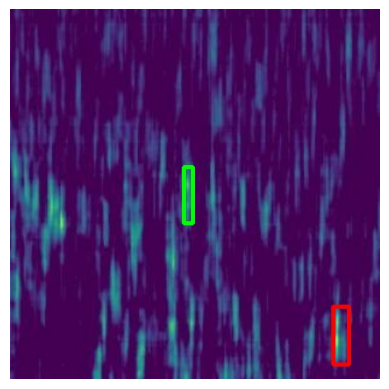

(448, 448, 3)
510_stray_bd2efd7f3ba7304480d5247e1f4018e8
[(29.000000000000004, 324.0, 45.0, 428.0, 0.14769111573696136), (48.15635335445404, 200.66665887832642, 70.04560434818268, 293.9999899864197, 1.0)]


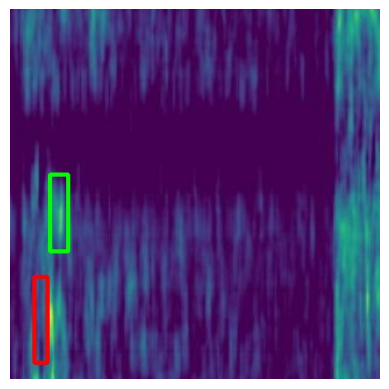

(448, 448, 3)
513_target_f7821b1d90075ba883d451db8537ae88
[(219.0, 182.0, 233.0, 283.0, 0.5655572414398193), (218.89249616861343, 169.55556297302246, 230.5667628645897, 275.3333377838135, 1.0)]


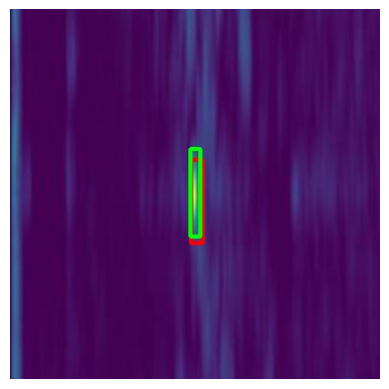

(448, 448, 3)
521_target_c8b166f912974587f5491a1d7d5fee04
[(207.0, 165.0, 220.0, 296.0, 0.5296090841293335), (205.75895208120346, 163.3333444595337, 218.89250284433365, 294.0000066757202, 1.0)]


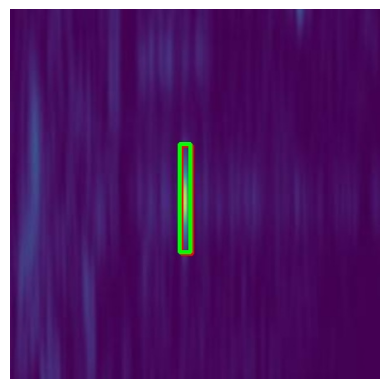

(448, 448, 3)
525_stray_a01ffba6a20ca48d20ab296b454a5981
[(0.0, 384.22221183776855, 23.348533391952515, 447.99998664855957, 1.0)]


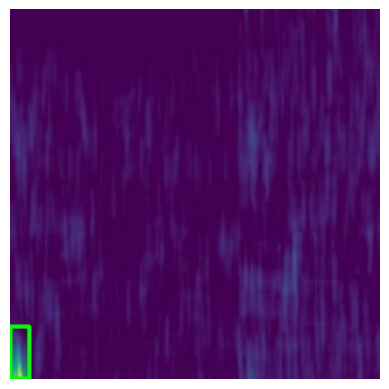

(448, 448, 3)
529_stray_3745c504476ed161681f8f7cd48711e9
[(353.0, 124.0, 377.0, 185.0, 0.11643052101135254), (294.0, 7.0, 313.0, 73.0, 0.11383769661188126), (348.7687201499939, 113.55555295944214, 369.1986870765686, 209.9999966621399, 1.0)]


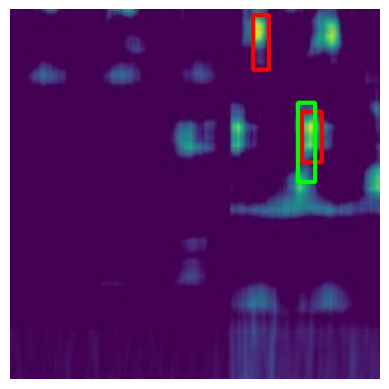

(448, 448, 3)
530_stray_c422558b30344809e878a8ffc97f4aae
[(152.0, 209.0, 166.0, 265.0, 0.10568152368068695), (18.970683693885803, 281.5555579662323, 35.022801756858826, 332.88889241218567, 1.0)]


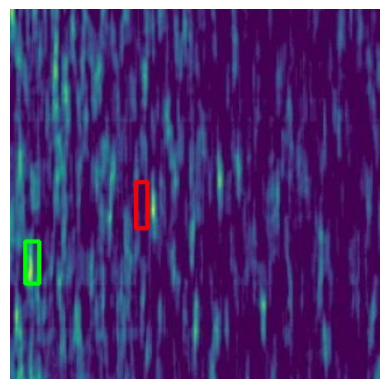

(448, 448, 3)
534_target_c0378c9c097ae304057ccc6cb5b1abc7
[(214.0, 163.0, 228.0, 290.0, 0.5994945168495178), (218.89249616861343, 163.33333110809326, 230.5667628645897, 279.9999933242798, 1.0)]


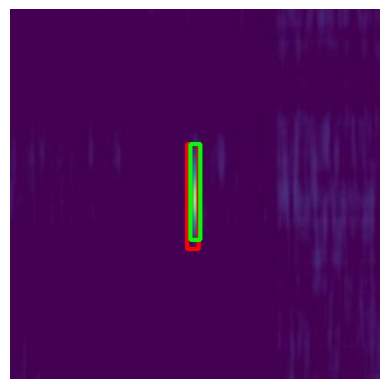

(448, 448, 3)
535_stray_0ca0ee1e3e9ab7bbe6efa90232da3446
[(254.0, 177.0, 265.0, 317.0, 0.2232368141412735), (121.99999999999999, 349.0, 146.0, 447.0, 0.21708615124225616), (236.99999999999997, 40.0, 256.0, 157.0, 0.18402749300003052), (232.00000000000003, 188.0, 250.99999999999997, 296.0, 0.11325918138027191), (261.2117211818695, 206.8888874053955, 280.18240571022034, 311.1111125946045, 1.0)]


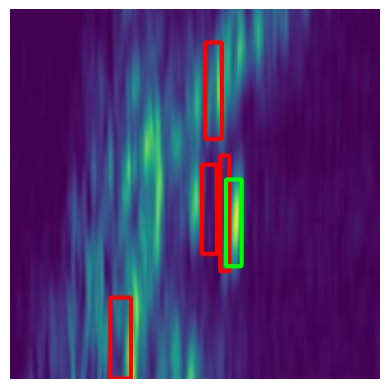

(448, 448, 3)
553_stray_5cd739823e3048ddc4804fc015cc3efd
[(0.0, 247.33333110809326, 10.214983463287354, 384.22221851348877, 1.0)]


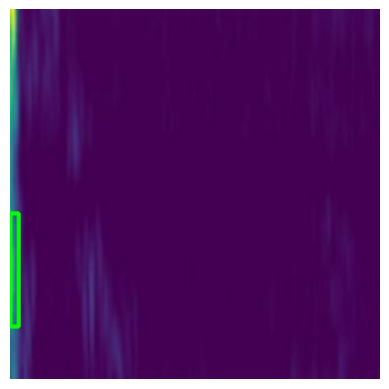

(448, 448, 3)
599_target_653c07fa21a2fdc0dd6f99bbcb2ee847
[(225.00000000000003, 166.0, 236.99999999999997, 291.0, 0.6028621792793274), (223.2703533768654, 160.22222518920898, 234.94462007284164, 287.777774810791, 1.0)]


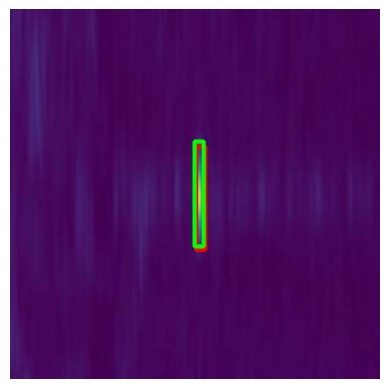

(448, 448, 3)
59_stray_8f5f5cac94c14eb3aa3c04d9417779b4
[(289.0, 96.0, 294.0, 219.0, 0.29095280170440674), (307.0, 147.0, 319.0, 282.0, 0.18234644830226898), (7.0, 168.0, 24.0, 275.0, 0.11095482110977173), (291.8566782474518, 88.66666221618652, 306.4495122432709, 241.1111125946045, 1.0)]


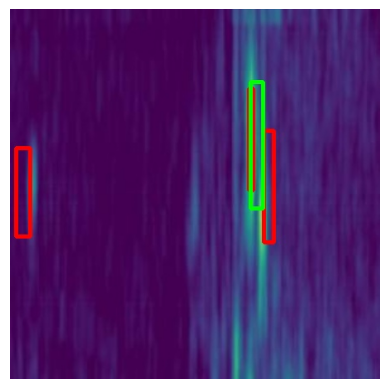

(448, 448, 3)
5_stray_ae16717d2ca018b28156e434b8093f86
[(352.0, 145.0, 370.0, 229.0, 0.21157507598400116), (345.8501753807068, 136.88889408111572, 366.2801423072815, 210.00000667572021, 1.0)]


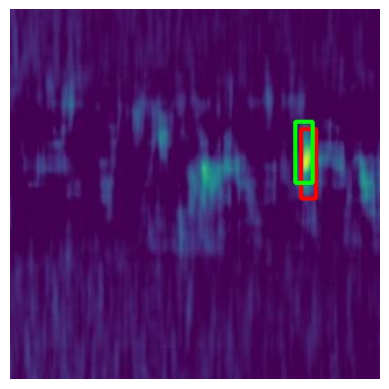

(448, 448, 3)
613_stray_bd7c5accb36dc533e882bd22dbc7f71a
[(38.0, 323.0, 53.0, 413.0, 0.12937790155410767), (66.0, 325.0, 85.0, 410.0, 0.12013479322195053), (410.0, 314.0, 431.0, 391.0, 0.1065966933965683), (80.26058572530746, 318.8888907432556, 93.39413648843765, 393.55555963516235, 1.0)]


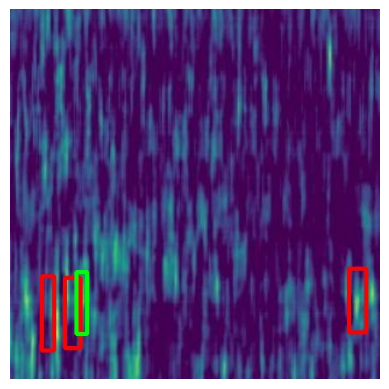

(448, 448, 3)
637_stray_36405d6b328cbed14e8e0a286f0d0663
[(265.0, 179.0, 282.0, 246.00000000000003, 0.21518659591674805), (259.75243294239044, 172.66666555404663, 275.80455100536346, 241.11110925674438, 1.0)]


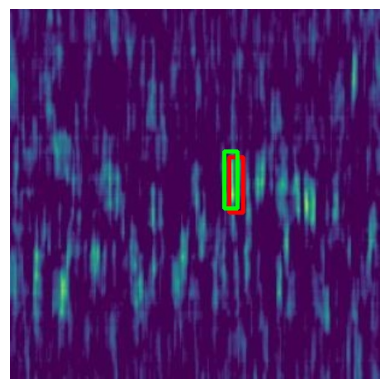

(448, 448, 3)
638_target_1eca5331eabfcdd70c895ded957efeac
[(225.00000000000003, 167.0, 238.0, 294.0, 0.5892541408538818), (221.8110676407814, 171.11110591888428, 233.48533433675766, 293.9999933242798, 1.0)]


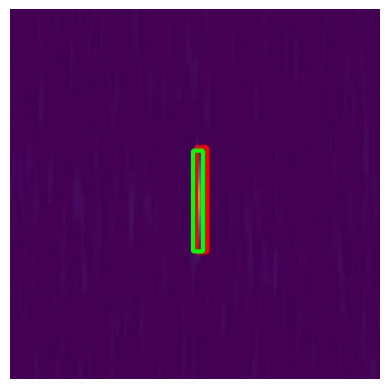

(448, 448, 3)
644_stray_cb81b89242f2d892c5bb4481d2827cf2
[(198.0, 71.0, 208.0, 154.0, 0.24488002061843872), (207.0, 81.0, 223.0, 160.0, 0.11982307583093643), (32.0, 16.0, 49.0, 104.0, 0.11229566484689713), (30.644950807094574, 6.222221851348877, 43.77850157022476, 93.33333444595337, 1.0)]


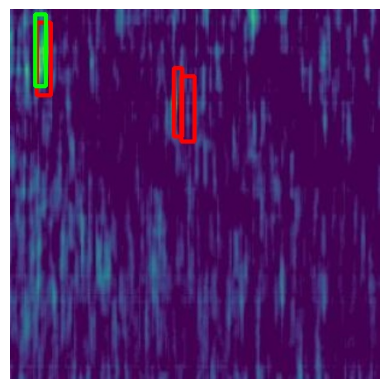

(448, 448, 3)
647_target_78732e9c55bd528f199504d4d8361ba1
[(234.0, 164.0, 248.0, 289.0, 0.4292781949043274), (154.0, 0.0, 165.0, 60.0, 0.29153215885162354), (234.94461464881897, 150.8888874053955, 249.53744864463806, 283.1111125946045, 1.0)]


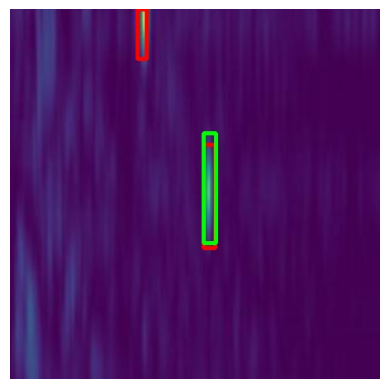

(448, 448, 3)
64_stray_33d2c221f4c72632cf9c712f2032d681
[(35.0, 121.0, 50.0, 207.0, 0.19977065920829773), (43.77850157022476, 138.44444704055786, 55.45276826620102, 224.0000033378601, 1.0)]


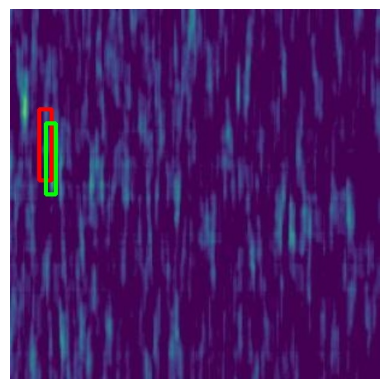

(448, 448, 3)
650_stray_3f67aabfbb0983aa99048fc606aa8b9e
[(74.0, 189.0, 89.0, 259.0, 0.16319489479064941), (58.37133347988129, 185.11110258102417, 80.26058447360992, 281.5555462837219, 1.0)]


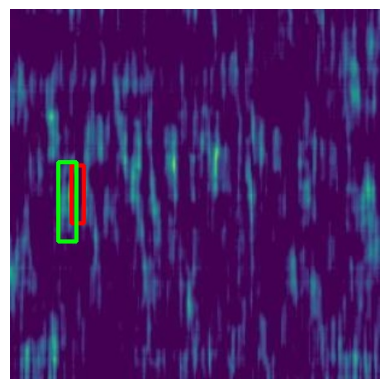

(448, 448, 3)
663_stray_b32de4fb57d387e6b22b4db4cb292d4d
[(322.0, 124.0, 338.0, 247.0, 0.29456761479377747), (286.0, 132.0, 317.0, 229.99999999999997, 0.25229939818382263), (315.2052233219147, 107.33333110809326, 329.79805731773376, 242.66666889190674, 1.0)]


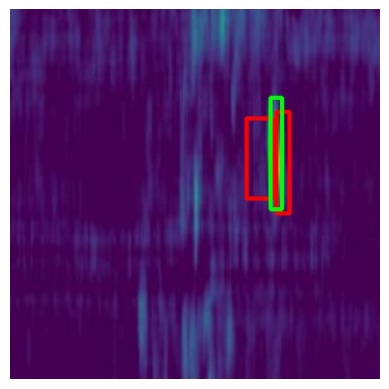

(448, 448, 3)
666_target_43acf5e419179e2fb53174841e35a403
[(220.0, 180.0, 231.0, 301.0, 0.5579561591148376), (221.81106513738632, 181.99999332427979, 230.56676536798477, 297.1111059188843, 1.0)]


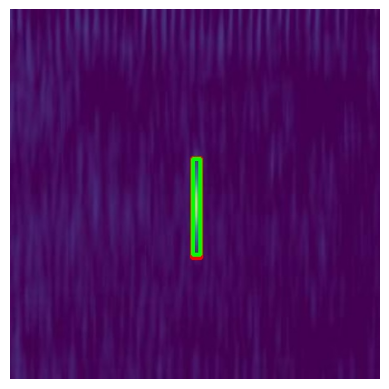

(448, 448, 3)
68_target_fb382eff8676223812140ee5483b6d70
[(229.0, 179.0, 243.99999999999997, 283.0, 0.5566992163658142), (224.72963911294937, 157.1111192703247, 236.40390580892563, 287.77778148651123, 1.0)]


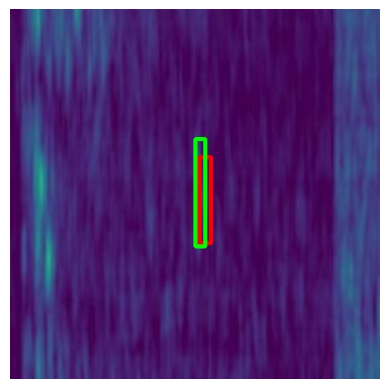

(448, 448, 3)
693_stray_3aad8354df55c4f9ec7791861db54e6a
[(25.0, 391.0, 42.0, 447.0, 0.14161190390586853), (229.1074984073639, 150.88889408111572, 243.70033240318298, 259.77778148651123, 1.0)]


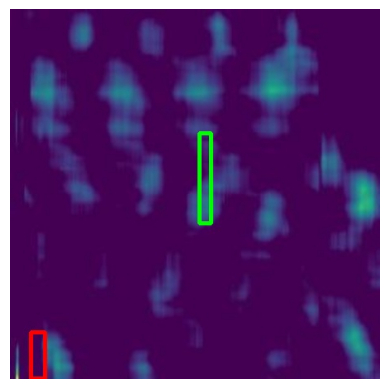

(448, 448, 3)
734_stray_19d5c7b13568b073bd3515eb1827721f
[(356.0, 40.0, 373.0, 120.0, 0.23396730422973633), (358.983710706234, 40.444443702697754, 367.7394109368324, 116.66666889190674, 1.0)]


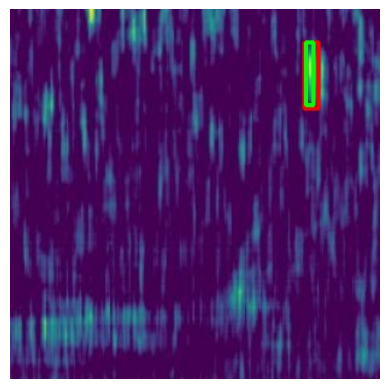

(448, 448, 3)
737_stray_066f0de7d3463f40b8d4834d401e2971
[(207.0, 280.0, 231.0, 384.0, 0.18573614954948425), (218.0, 154.0, 239.00000000000003, 267.0, 0.15771976113319397), (265.0, 29.000000000000004, 283.0, 142.0, 0.13168251514434814), (215.97393888235092, 275.33332109451294, 229.1074896454811, 374.8888773918152, 1.0)]


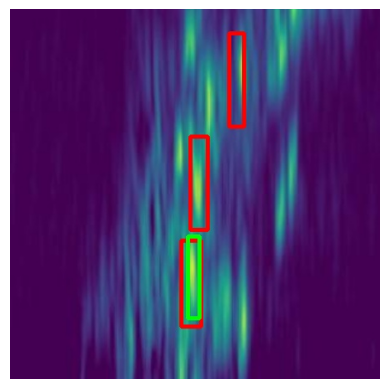

(448, 448, 3)
747_stray_969fb8148c451115e83400b75fc726f1
[(315.0, 119.0, 334.0, 236.0, 0.2174980640411377), (288.0, 128.0, 316.0, 221.0, 0.10336226224899292), (312.28664433956146, 108.88888740539551, 334.1758953332901, 248.8888874053955, 1.0)]


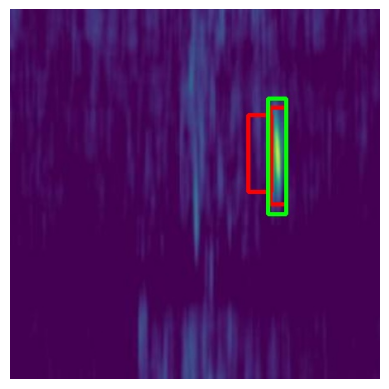

(448, 448, 3)
748_stray_ee6d40b0f2942c38a157713c9fd073f5
[(363.3615508079529, 77.77777814865112, 383.7915177345276, 166.44444704055786, 1.0)]


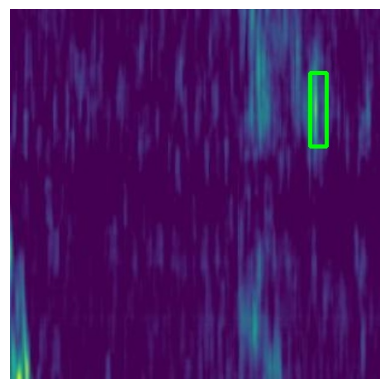

(448, 448, 3)
749_target_358e407c13f96e61aafb22f70ce46672
[(218.0, 171.0, 229.99999999999997, 305.0, 0.5754183530807495), (217.4332150220871, 160.22221183776855, 234.944615483284, 306.44443702697754, 1.0)]


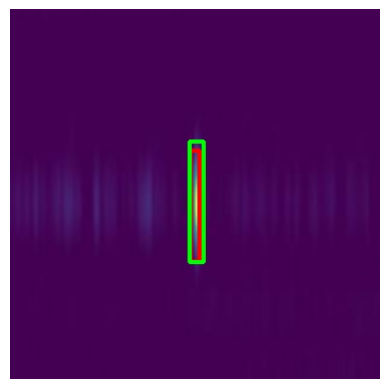

(448, 448, 3)
74_stray_bf1cb3f2fb4b4377313fbf98509ce95c
[(227.0, 193.0, 246.00000000000003, 305.0, 0.36354637145996094), (98.0, 302.0, 119.0, 414.0, 0.19445917010307312), (113.0, 102.0, 132.0, 206.0, 0.10223046690225601), (217.43322670459747, 158.66667556762695, 233.4853447675705, 300.222225189209, 1.0)]


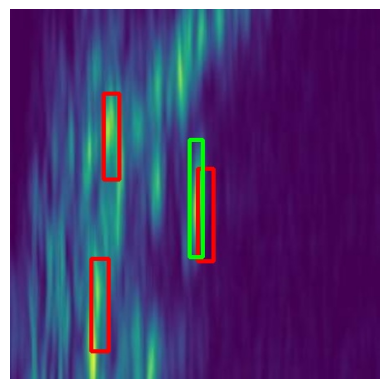

(448, 448, 3)
752_target_ee0b7b4706f3645e227fe40d72cd26b1
[(266.0, 342.0, 276.0, 447.0, 0.1850055307149887), (256.83388608694077, 326.6666555404663, 269.96743685007095, 447.9999933242798, 1.0)]


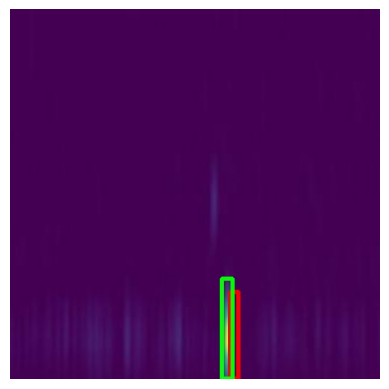

(448, 448, 3)
756_stray_6916941b6020cf2898cf5cccde4a0b86
[(203.0, 301.0, 221.0, 416.0, 0.3316853940486908), (211.0, 18.0, 232.00000000000003, 131.0, 0.19157351553440094), (217.43322670459747, 154.0, 233.4853447675705, 287.777774810791, 1.0)]


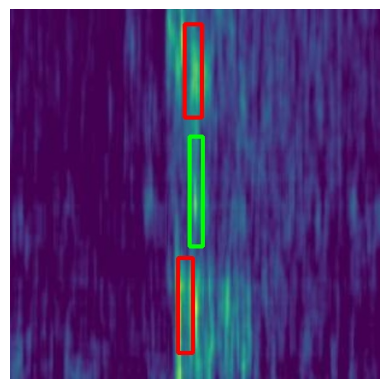

(448, 448, 3)
763_stray_0d06ea3bf49d719fec49a9ab2f36f2ae
[(278.0, 62.0, 297.0, 145.0, 0.26016655564308167), (74.0, 83.0, 92.0, 149.0, 0.22224223613739014), (37.0, 88.0, 53.0, 162.0, 0.10407795011997223), (94.85342305898666, 98.00000333786011, 107.98697382211685, 166.44444704055786, 1.0)]


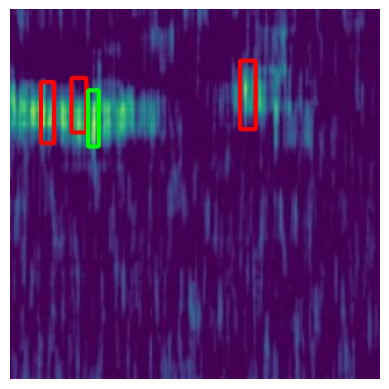

(448, 448, 3)
769_target_08405a2ae99f2ff122c072decd74a041
[(222.0, 202.0, 238.0, 274.0, 0.45281389355659485), (221.81108182668686, 194.44444036483765, 234.94463258981705, 269.1111092567444, 1.0)]


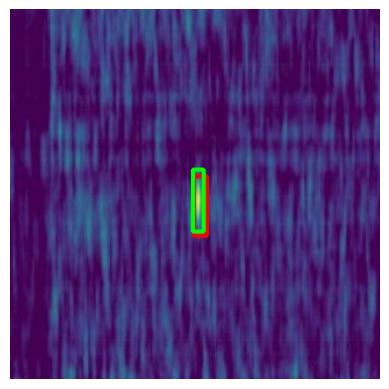

(448, 448, 3)
76_stray_51eac9997a21027aabb49a84d311f859
[(30.0, 176.0, 50.0, 295.0, 0.20928269624710083), (44.0, 0.0, 60.99999999999999, 83.0, 0.1255442053079605), (27.726385593414307, 188.22221851348877, 48.156352519989014, 317.33333110809326, 1.0)]


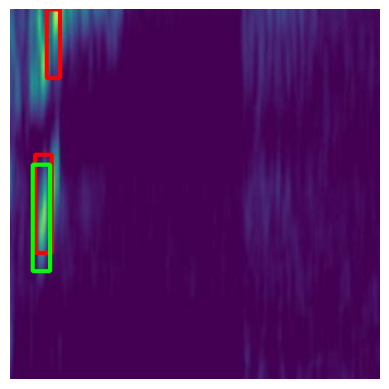

(448, 448, 3)
76_target_9fd78a105168d507f786bb5a0ccf4459
[(228.0, 198.0, 241.0, 276.0, 0.45380643010139465), (224.72964870929718, 177.33332443237305, 232.02606570720673, 275.33332443237305, 1.0)]


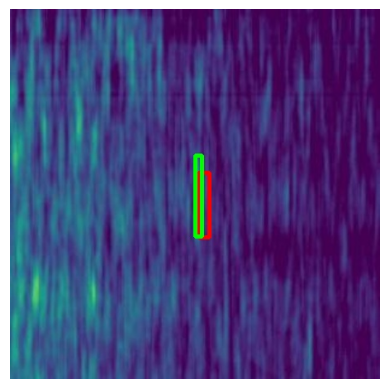

(448, 448, 3)
780_target_6e483daaf3271667dc4db46fe308412b
[(219.0, 175.0, 231.0, 305.0, 0.583089292049408), (217.4332246184349, 174.22221183776855, 230.5667753815651, 306.44443702697754, 1.0)]


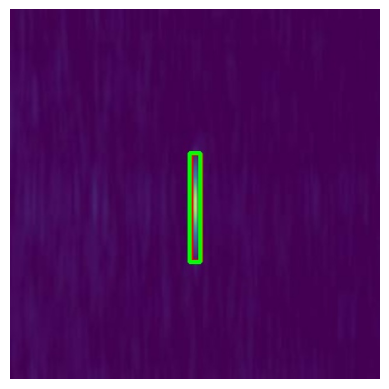

(448, 448, 3)
7_stray_1aa56f2705fdf7603600697e3a8b2bbf
[(113.0, 318.0, 128.0, 386.0, 0.19509196281433105), (113.82410883903503, 284.66667222976685, 124.03909230232239, 384.2222285270691, 1.0)]


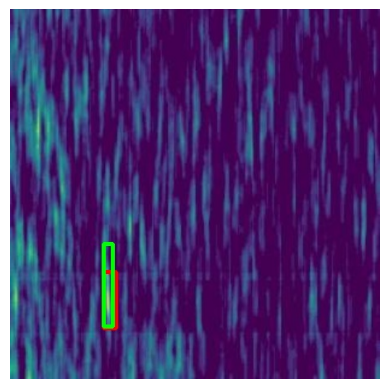

(448, 448, 3)
806_target_0a7a144bcd273f386128727a8dd7bc9e
[(206.0, 159.0, 218.0, 290.0, 0.5324087142944336), (198.46254134178162, 166.44443035125732, 217.43322587013245, 287.7777681350708, 1.0)]


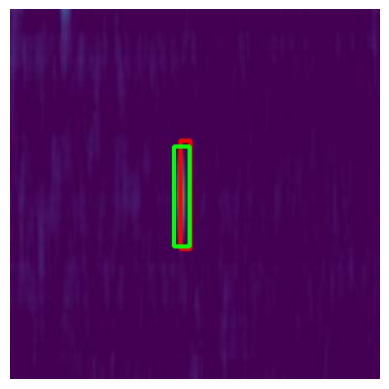

(448, 448, 3)
829_target_9205fbec0e748a97220cc62c68a20c52
[(223.0, 185.0, 236.0, 299.0, 0.511764407157898), (220.35179609060287, 194.44445705413818, 233.48534685373306, 289.3333444595337, 1.0)]


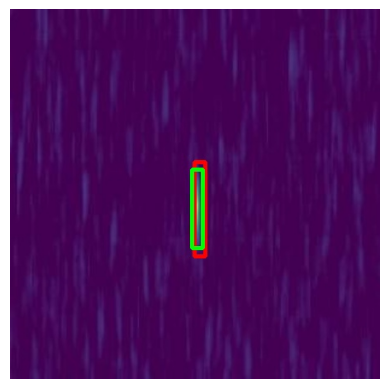

(448, 448, 3)
838_stray_12a48660b24f870f759a2031200c4393
[(269.0, 267.0, 283.0, 337.0, 0.18968380987644196), (264.13028597831726, 255.1111125946045, 274.3452694416046, 317.3333377838135, 1.0)]


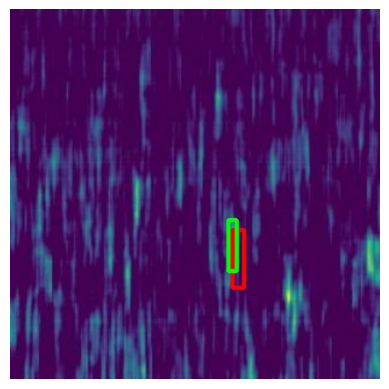

(448, 448, 3)
860_target_6030a6fc7f12bccdb7ef736535b8253b
[(282.0, 348.0, 291.0, 434.0, 0.27027255296707153), (235.0, 168.0, 246.00000000000003, 293.0, 0.26352742314338684), (239.32247185707092, 163.33332443237305, 253.91530585289001, 289.33332443237305, 1.0)]


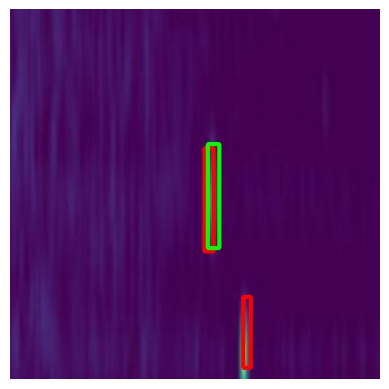

(448, 448, 3)
871_stray_dd17f82bef60417d5664206e896b002f
[(119.0, 258.0, 132.0, 327.0, 0.41996026039123535), (107.9869658946991, 264.44444370269775, 118.20194935798645, 351.55555629730225, 1.0)]


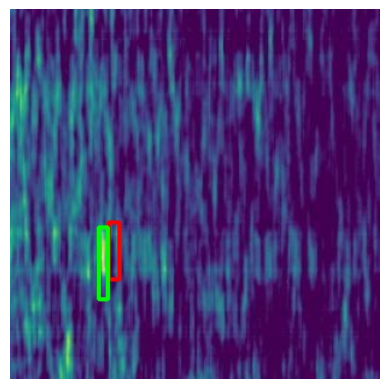

(448, 448, 3)
882_stray_7396b96e28fff47958b30e8705ac7ea7
[(140.0, 147.0, 157.0, 256.0, 0.1928454488515854), (150.3061921596527, 155.55555629730225, 169.27687668800354, 272.22221851348877, 1.0)]


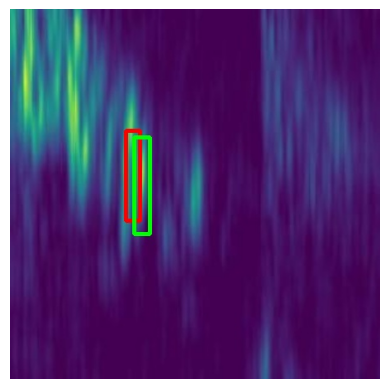

(448, 448, 3)
885_stray_caae5e0224a3c87ddd34aa360a326939
[(5.0, 340.0, 22.0, 414.0, 0.14963561296463013), (2.0, 8.0, 21.0, 83.0, 0.10781390964984894), (21.889251828193665, 334.44445037841797, 37.94136989116669, 418.44445037841797, 1.0)]


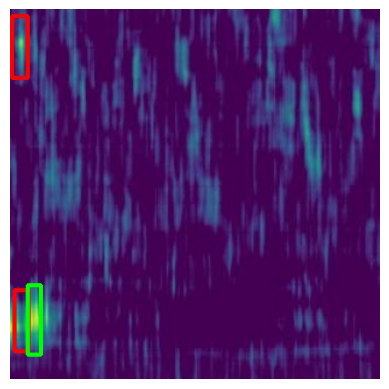

(448, 448, 3)
896_target_60c72e619d17371b68e5fe6a490da59d
[(111.0, 22.0, 133.0, 128.0, 0.2842370271682739), (93.39413440227509, 0.0, 110.90553486347198, 127.55554962158203, 1.0)]


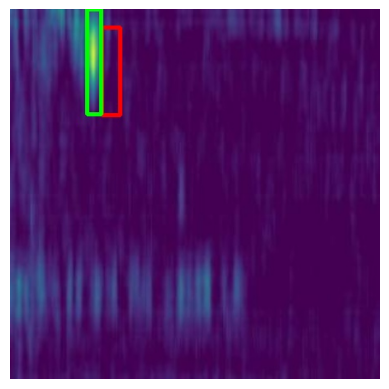

(448, 448, 3)
906_target_347d33eb20cac6c1782db55fa47fd45d
[(224.0, 174.0, 238.0, 303.0, 0.5811992883682251), (220.35179817676544, 163.33333778381348, 236.40391623973846, 295.55556297302246, 1.0)]


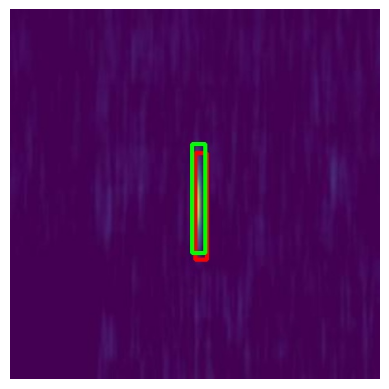

(448, 448, 3)
907_target_40976d63f3ee6275078ce60944ebaa92
[(137.17263388633728, 3.1111092567443848, 156.1433184146881, 90.22222185134888, 1.0)]


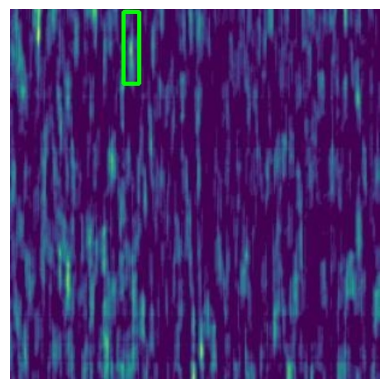

(448, 448, 3)
916_stray_e4e6337cbbf52c18863045d418684fef
[(44.0, 199.0, 59.0, 273.0, 0.31387174129486084), (52.534203469753265, 194.44443702697754, 65.66775423288345, 270.6666622161865, 1.0)]


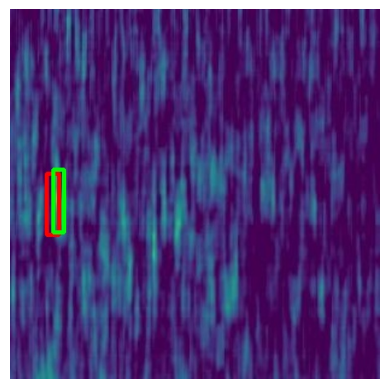

(448, 448, 3)
920_target_2ab3e050bf9d7f929386fff1a3f6fbe0
[(209.0, 149.0, 221.0, 288.0, 0.5448698997497559), (208.677525639534, 143.1111125946045, 224.72964370250702, 283.1111125946045, 1.0)]


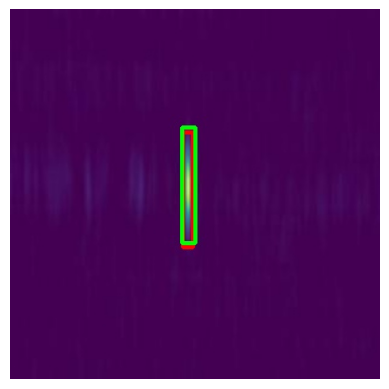

(448, 448, 3)
92_target_475cb7d4f922fb916c4748a5dd8035e5
[(222.0, 172.0, 234.0, 280.0, 0.5572696328163147), (220.35179609060287, 174.22221183776855, 233.48534685373306, 292.44443702697754, 1.0)]


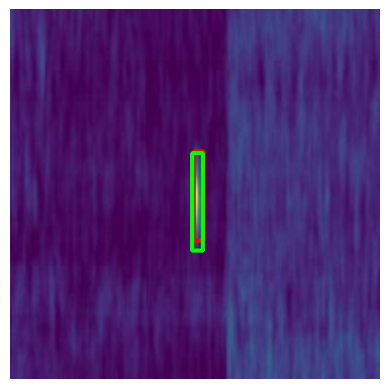

(448, 448, 3)
933_target_1b295339b1b184e5072a01c0f355e245
[(217.0, 172.0, 231.0, 304.0, 0.5733407139778137), (215.9739409685135, 160.22222518920898, 232.0260590314865, 315.777774810791, 1.0)]


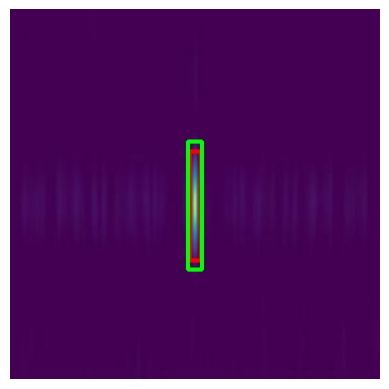

(448, 448, 3)
937_target_244444987b48d6aec95f9747761679d6
[(212.0, 143.0, 229.0, 279.0, 0.6216410994529724), (215.9739317893982, 135.33333110809326, 236.4038987159729, 293.9999933242798, 1.0)]


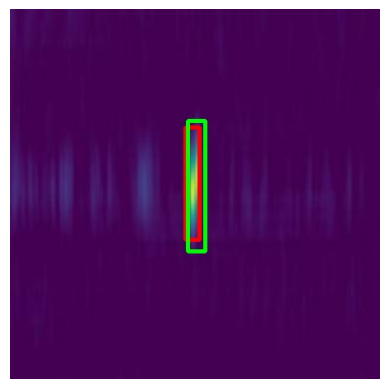

(448, 448, 3)
94_target_a073b5dfda50e92cc7772f0c9a6f39c8
[(212.0, 208.0, 222.0, 279.0, 0.3341134190559387), (218.89251244068146, 209.99999332427979, 234.94463050365448, 269.1111059188843, 1.0)]


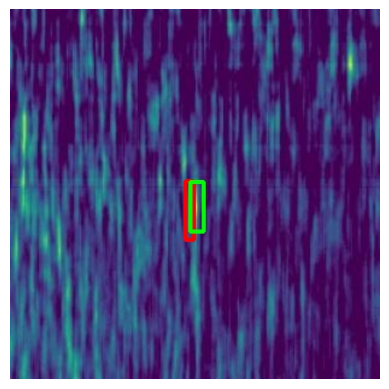

(448, 448, 3)
954_target_5d6e2be39e561b9c4dfa92a004d6b2bf
[(207.0, 175.0, 219.0, 285.0, 0.4941367208957672), (202.8403931260109, 181.99998664855957, 214.51465982198715, 286.22221183776855, 1.0)]


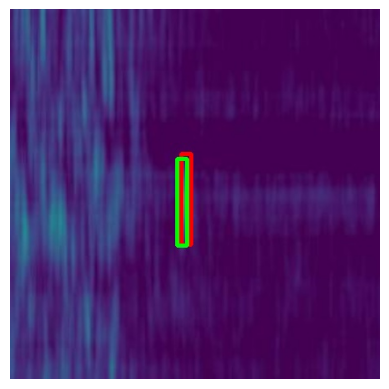

(448, 448, 3)
958_target_11540a8f7ad3bda6f2d0e4d07f913185
[(217.0, 163.0, 231.0, 293.0, 0.6008738279342651), (218.89249616861343, 166.44443702697754, 230.5667628645897, 286.22221183776855, 1.0)]


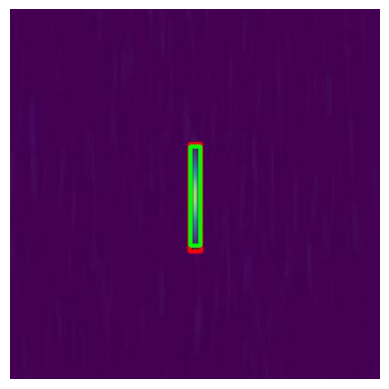

(448, 448, 3)
970_stray_c26765abb0516c776aabf6e2d6dd5d25
[(370.0, 159.0, 389.0, 283.0, 0.20266151428222656), (349.0, 121.0, 372.0, 233.0, 0.14602825045585632), (348.7687201499939, 116.66666221618652, 369.1986870765686, 228.66666221618652, 1.0)]


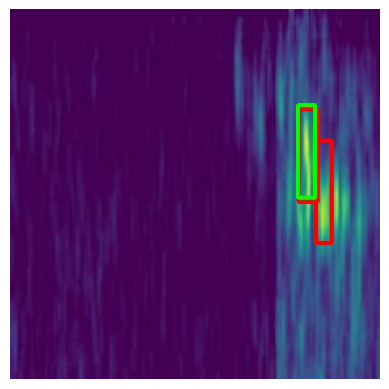

(448, 448, 3)
984_stray_7a42e84c83ef85b22fbc25cdae6a3216
[(27.0, 94.0, 48.0, 211.0, 0.2130795121192932), (35.02280133962631, 87.11111259460449, 48.1563521027565, 206.8888874053955, 1.0)]


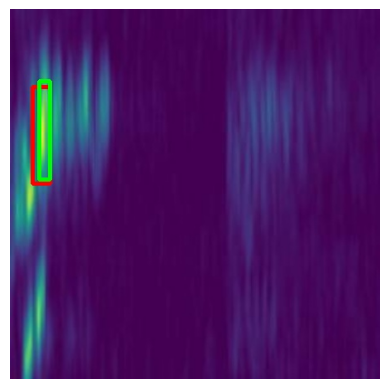

In [28]:
def boxPlot(boxlist, imagePath, savePath):
    labelfiles = sorted(list(set([filename for filename, _, _, _ in boxlist])))
    
    for labelfile in labelfiles:
    
        rectinfos = []
        imgfilePath = os.path.join(imagePath, labelfile + ".jpg")
        img = cv2.imread(imgfilePath)
        img_t=transformer(image=img)
        img=img_t['image'].permute(1,2,0).numpy()
        print(img.shape)

        for filename, _, conf, (x1, y1, x2, y2) in boxlist:
            if labelfile == filename:
                rectinfos.append((x1, y1, x2, y2, conf))
        print(labelfile)
        print(rectinfos)
        for x1, y1, x2, y2, conf in rectinfos:
            
            if conf == 1.0:
                rectcolor = (0, 255, 0)
            else:
                rectcolor = (0, 0, 255)
                
            cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), rectcolor, 4)
        os.makedirs(savePath, exist_ok=True)
        cv2.imwrite(f"{savePath}/{labelfile}.jpg", img)

        img = mpimg.imread(f"{savePath}/{labelfile}.jpg")
        plt.axis("off")
        plt.imshow(img)
        plt.show()
        
# boxPlot(detections, "image", savePath="boxed_images/detection")
# boxPlot(groundtruths, "image", savePath="boxed_images/groundtruth")
boxPlot(detections + groundtruths, "/home/host_data/radio_signal_data_organized_for_measure/test/image/", savePath=f"/workspace/Plastic_Bottle_defect_detection/results/boxed_images/{model_name}")

## IoU(Intersection over Union)

In [29]:
def getArea(box):
    return (box[2] - box[0] + 1) * (box[3] - box[1] + 1)


def getUnionAreas(boxA, boxB, interArea=None):
    area_A = getArea(boxA)
    area_B = getArea(boxB)
    
    if interArea is None:
        interArea = getIntersectionArea(boxA, boxB)
        
    return float(area_A + area_B - interArea)

def getIntersectionArea(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    # intersection area
    return (xB - xA + 1) * (yB - yA + 1)

# boxA = (Ax1,Ay1,Ax2,Ay2)
# boxB = (Bx1,By1,Bx2,By2)
def boxesIntersect(boxA, boxB):
    if boxA[0] > boxB[2]:
        return False  # boxA is right of boxB
    if boxB[0] > boxA[2]:
        return False  # boxA is left of boxB
    if boxA[3] < boxB[1]:
        return False  # boxA is above boxB
    if boxA[1] > boxB[3]:
        return False  # boxA is below boxB
    return True

def iou(boxA, boxB):
    # if boxes dont intersect
    if boxesIntersect(boxA, boxB) is False:
        return 0
    interArea = getIntersectionArea(boxA, boxB)
    union = getUnionAreas(boxA, boxB, interArea=interArea)
    
    # intersection over union
    result = interArea / union
    assert result >= 0
    return result

In [30]:
boxA = detections[-1][-1]
boxB = groundtruths[-1][-1]

print(f"boxA coordinates : {(boxA)}")
print(f"boxA area : {getArea(boxA)}")
print(f"boxB coordinates : {(boxB)}")
print(f"boxB area : {getArea(boxB)}")

print(f"Union area of boxA and boxB : {getUnionAreas(boxA, boxB)}")

print(f"Does boxes Intersect? : {boxesIntersect(boxA, boxB)}")

print(f"Intersection area of boxA and boxB : {getIntersectionArea(boxA, boxB)}")

print(f"IoU of boxA and boxB : {iou(boxA, boxB)}")

boxA coordinates : (19.0, 366.0, 37.0, 447.0)
boxA area : 1558.0
boxB coordinates : (11.674267530441284, 343.77778816223145, 26.267101526260376, 448.00001335144043)
boxB area : 1640.7126900460298
Union area of boxA and boxB : 2520.810364892679
Does boxes Intersect? : True
Intersection area of boxA and boxB : 677.9023251533508
IoU of boxA and boxB : 0.2689223809115097


## AP(Average Precision)

In [31]:
def calculateAveragePrecision(rec, prec):
    
    mrec = [0] + [e for e in rec] + [1]
    mpre = [0] + [e for e in prec] + [0]

    for i in range(len(mpre)-1, 0, -1):
        mpre[i-1] = max(mpre[i-1], mpre[i])

    ii = []

    for i in range(len(mrec)-1):
        if mrec[1:][i] != mrec[0:-1][i]:
            ii.append(i+1)

    ap = 0
    for i in ii:
        ap = ap + np.sum((mrec[i] - mrec[i-1]) * mpre[i])
    
    return [ap, mpre[0:len(mpre)-1], mrec[0:len(mpre)-1], ii]

In [32]:
def ElevenPointInterpolatedAP(rec, prec):

    mrec = [e for e in rec]
    mpre = [e for e in prec]

    recallValues = np.linspace(0, 1, 11)
    recallValues = list(recallValues[::-1])
    rhoInterp, recallValid = [], []

    for r in recallValues:
        argGreaterRecalls = np.argwhere(mrec[:] >= r)
        pmax = 0

        if argGreaterRecalls.size != 0:
            pmax = max(mpre[argGreaterRecalls.min():])

        recallValid.append(r)
        rhoInterp.append(pmax)

    ap = sum(rhoInterp) / 11

    return [ap, rhoInterp, recallValues, None]

In [36]:
def AP(detections, groundtruths, classes, IOUThreshold = 0.3, method = 'AP'):
    
    result = []
    
    for c in classes:

        dects = [d for d in detections if d[1] == c]
        gts = [g for g in groundtruths if g[1] == c]

        npos = len(gts)

        dects = sorted(dects, key = lambda conf : conf[2], reverse=True)

        TP = np.zeros(len(dects))
        FP = np.zeros(len(dects))

        det = Counter(cc[0] for cc in gts)

        # 각 이미지별 ground truth box의 수
        # {99 : 2, 380 : 4, ....}
        # {99 : [0, 0], 380 : [0, 0, 0, 0], ...}
        for key, val in det.items():
            det[key] = np.zeros(val)


        for d in range(len(dects)):


            gt = [gt for gt in gts if gt[0] == dects[d][0]]

            iouMax = 0

            for j in range(len(gt)):
                iou1 = iou(dects[d][3], gt[j][3])
                if iou1 > iouMax:
                    iouMax = iou1
                    jmax = j

            if iouMax >= IOUThreshold:
                if det[dects[d][0]][jmax] == 0:
                    TP[d] = 1
                    det[dects[d][0]][jmax] = 1
                else:
                    FP[d] = 1
            else:
                FP[d] = 1

        acc_FP = np.cumsum(FP)
        acc_TP = np.cumsum(TP)
        rec = acc_TP / npos
        prec = np.divide(acc_TP, (acc_FP + acc_TP))

        if method == "AP":
            [ap, mpre, mrec, ii] = calculateAveragePrecision(rec, prec)
        else:
            [ap, mpre, mrec, _] = ElevenPointInterpolatedAP(rec, prec)

        r = {
            'class' : c,
            'precision' : prec,
            'recall' : rec,
            'AP' : ap,
            'interpolated precision' : mpre,
            'interpolated recall' : mrec,
            'total positives' : npos,
            'total TP' : np.sum(TP),
            'total FP' : np.sum(FP)
        }

        result.append(r)

    return result

result = AP(detections, groundtruths, classes,IOUThreshold=0.3)
print(result)

[{'class': 0.0, 'precision': array([1.        , 0.5       , 0.33333333, 0.5       , 0.4       ,
       0.33333333, 0.28571429, 0.375     , 0.44444444, 0.5       ,
       0.54545455, 0.5       , 0.46153846, 0.42857143, 0.4       ,
       0.4375    , 0.41176471, 0.38888889, 0.42105263, 0.45      ,
       0.42857143, 0.45454545, 0.43478261, 0.41666667, 0.44      ,
       0.46153846, 0.44444444, 0.46428571, 0.48275862, 0.46666667,
       0.4516129 , 0.4375    , 0.42424242, 0.41176471, 0.4       ,
       0.41666667, 0.43243243, 0.42105263, 0.41025641, 0.4       ,
       0.3902439 , 0.38095238, 0.39534884, 0.38636364, 0.4       ,
       0.39130435, 0.40425532, 0.39583333, 0.3877551 , 0.4       ,
       0.39215686, 0.38461538, 0.37735849, 0.38888889, 0.38181818,
       0.39285714, 0.40350877, 0.39655172, 0.40677966, 0.4       ,
       0.40983607, 0.40322581, 0.41269841, 0.40625   , 0.4       ,
       0.39393939, 0.40298507, 0.39705882, 0.39130435, 0.38571429,
       0.3943662 , 0.38888889, 0.

## mAP(mean Average Precision)

In [37]:
def mAP(result):
    ap = 0
    for r in result:
        ap += r['AP']
    mAP = ap / len(result)
    
    return mAP

In [38]:
for r in result:
    print("{:^8} AP : {}".format(num2class[str(r['class'])], r['AP']))
print("---------------------------")
print(f"mAP : {mAP(result)}")

 stray   AP : 0.15315491221166896
 target  AP : 0.7680444510184994
---------------------------
mAP : 0.4605996816150842


## Prediction & Annotation 비교 plot

In [41]:
from ipywidgets import interact
both_path=f"/workspace/Plastic_Bottle_defect_detection/results/boxed_images/{model_name}/"
both_images=os.listdir(both_path)
@interact(index=(0,len(both_images)-1))
def show_result(index=0):
    box_img=cv2.imread(both_path+both_images[index])
    result = pred_images[index]
    print(both_images[index])
        
    plt.figure(figsize=(6,6))
    plt.imshow(box_img)
    plt.show()

interactive(children=(IntSlider(value=0, description='index', max=24), Output()), _dom_classes=('widget-intera…